# PayMaya Topic Modeling Notebook
---

## Download and install requisite libraries and packages
---

In [298]:
import sys

!pip install -r data/requirements.txt

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/python3/bin/python3.6 -m pip install --upgrade pip' command.


### JupyterLab renderer support
install the required JupyterLab extensions

In [299]:
!conda install -c conda-forge nodejs -y
!conda install -c plotly plotly-orca -y

Solving environment: \ 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - conda-forge/linux-64::nodejs==15.14.0=h92b4a50_0
done


==> WARNING: A newer version of conda exists. <==
  current version: 4.8.4
  latest version: 4.10.1

Please update conda by running

    $ conda update -n base -c defaults conda



# All requested packages already installed.

Solving environment: | 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - conda-forge/linux-64::nodejs==15.14.0=h92b4a50_0
done


==> WARNING: A newer version of conda exists. <==
  current version: 4.8.4
  latest version: 4.10.1

Please update conda by running

    $ conda update -n base -c defaults conda



# All requested packages already installed.



In [300]:
!jupyter labextension install jupyterlab-plotly

Config option `kernel_spec_manager_class` not recognized by `InstallLabExtensionApp`.
[W 2021-07-01 15:01:05.863 LabApp] Config option `kernel_spec_manager_class` not recognized by `LabApp`.
Building jupyterlab assets (production, minimized)


In [31]:
import matplotlib.pyplot as plt
import plotly.express as px
import wordcloud as wc
import seaborn as sns
import pandas as pd 
import numpy as np
import mxnet as mx
import tarfile
import zipfile
import sklearn
import os
from datetime_truncate import truncate

## Import and prepare CSV files
---

In [74]:
data1.loc[(data1['type'] == 'app store')]

,date,review,rating,type,month
45,2020-12-23 09:29:29,Always giving me a registration error.,1,app store,2020-12-01 00:00:00
80,2020-02-12 23:40:49,Can u pls explain about this debit adjustment?...,1,app store,2020-02-01 00:00:00
107,2021-04-11 12:45:17,Sobrang convenient ng app na to . I pay my bil...,5,app store,2021-04-01 00:00:00
201,2021-06-06 05:33:12,It’s great app. We can easily send money to ou...,5,app store,2021-06-01 00:00:00
243,2021-04-30 22:24:08,Great features and very secure e wallet with l...,5,app store,2021-04-01 00:00:00
...,...,...,...,...,...
55075,2020-04-02 06:43:08,"ITS A TRASH CASH APP. SUPER HASSLE TO SETUP, S...",1,app store,2020-04-01 00:00:00
55083,2020-08-28 06:02:07,The best financial App in PH. It has a lot apf...,5,app store,2020-08-01 00:00:00
55135,2021-05-14 07:09:33,PayMaya Mall is an online shopping feature tha...,5,app store,2021-05-01 00:00:00
55221,2021-04-06 04:54:11,Worst ewallrt app ever used!!!,1,app store,2021-04-01 00:00:00


### Import CSV files

In [84]:
complete_df = pd.read_csv('data/PayMaya/complete_paymaya_play_store_reviews.csv')

# convert date columns to datetime since dtypes aren't preserved in csv files
complete_df['date'] = pd.to_datetime(complete_df['at'])

# get review data from January 1, 2020 (12 AM) until June 3, 2021 (12 AM)
mask = (complete_df['date'] > '2020-01-01 00:00:00') & (complete_df['date'] < '2021-06-04 00:00:00')
complete_df = complete_df.loc[mask]

# create and append month column
complete_df['month'] = complete_df['date'].apply(lambda x: truncate(x, 'month').date())
complete_df['month'] = pd.to_datetime(complete_df['month'])

complete_df['type'] = 'play store'
complete_df['rating'] = complete_df['score']
complete_df['review'] = complete_df['content']
complete_df = complete_df.drop(['reviewId', 'userName', 'userImage', 'thumbsUpCount', 'replyContent', 'repliedAt', 'content', 'score', 'at', 'reviewCreatedVersion'], axis=1)

data1 = pd.read_csv('data/PayMaya/paymaya_combined_reviews.csv')

complete_df = complete_df.append(data1, ignore_index=True)
complete_df
# drop rows that have NULL entries
complete_df = complete_df.dropna()

# drop rows that have duplicates
complete_df = complete_df.drop_duplicates()

# sort by date
complete_df['date'] = pd.to_datetime(complete_df['date'])
complete_df['month'] = pd.to_datetime(complete_df['month'])
complete_df = complete_df.sort_values(by=['date'])

# cast float64 rating column to int32
complete_df['rating'] = complete_df['rating'].astype('int32')

complete_df.info()
print(display(complete_df))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 114626 entries, 99858 to 107313
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    114626 non-null  datetime64[ns]
 1   month   114626 non-null  datetime64[ns]
 2   type    114626 non-null  object        
 3   rating  114626 non-null  int32         
 4   review  114626 non-null  object        
dtypes: datetime64[ns](2), int32(1), object(2)
memory usage: 4.8+ MB


,date,month,type,rating,review
99858,2019-12-31 03:36:18,2019-12-01,app store,1,"This app is so not userfriendly, I mistakenly ..."
70939,2019-12-31 09:46:13,2019-12-01,app store,1,Very disappointed with the recent changes. Wou...
105240,2019-12-31 14:29:21,2019-12-01,app store,5,More improvements and security updates this 2020!
109213,2019-12-31 23:44:09,2019-12-01,app store,1,Your service is a dump as ever i cant register...
107672,2020-01-01 00:08:00,2020-01-01,play store,5,very good for load and paying bills.
...,...,...,...,...,...
61413,2021-06-25 09:55:14,2021-06-01,play store,5,Very Good App. Easy to use!
82124,2021-06-25 10:26:57,2021-06-01,play store,1,You have the option for Senior Citizen ID for ...
91673,2021-06-25 10:27:10,2021-06-01,play store,5,Very nice
71844,2021-06-25 10:32:51,2021-06-01,play store,1,VERY BAD EXPERIENCE. SUPER HIRAP MAKAPAG TRANS...


None


In [87]:
complete_df['rating'].unique()

array([1, 5, 4, 3, 2])

In [88]:
mask = ((complete_df['rating'] == 1) | (complete_df['rating'] == 5))
combined_df = complete_df.loc[mask]

combined_df.info()
print(display(combined_df))

<class 'pandas.core.frame.DataFrame'>
Int64Index: 106034 entries, 99858 to 107313
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype         
---  ------  --------------   -----         
 0   date    106034 non-null  datetime64[ns]
 1   month   106034 non-null  datetime64[ns]
 2   type    106034 non-null  object        
 3   rating  106034 non-null  int32         
 4   review  106034 non-null  object        
dtypes: datetime64[ns](2), int32(1), object(2)
memory usage: 4.4+ MB


,date,month,type,rating,review
99858,2019-12-31 03:36:18,2019-12-01,app store,1,"This app is so not userfriendly, I mistakenly ..."
70939,2019-12-31 09:46:13,2019-12-01,app store,1,Very disappointed with the recent changes. Wou...
105240,2019-12-31 14:29:21,2019-12-01,app store,5,More improvements and security updates this 2020!
109213,2019-12-31 23:44:09,2019-12-01,app store,1,Your service is a dump as ever i cant register...
107672,2020-01-01 00:08:00,2020-01-01,play store,5,very good for load and paying bills.
...,...,...,...,...,...
61413,2021-06-25 09:55:14,2021-06-01,play store,5,Very Good App. Easy to use!
82124,2021-06-25 10:26:57,2021-06-01,play store,1,You have the option for Senior Citizen ID for ...
91673,2021-06-25 10:27:10,2021-06-01,play store,5,Very nice
71844,2021-06-25 10:32:51,2021-06-01,play store,1,VERY BAD EXPERIENCE. SUPER HIRAP MAKAPAG TRANS...


None


In [90]:
combined_df['rating'].unique()

array([1, 5])

## Exploratory Data Analysis
---

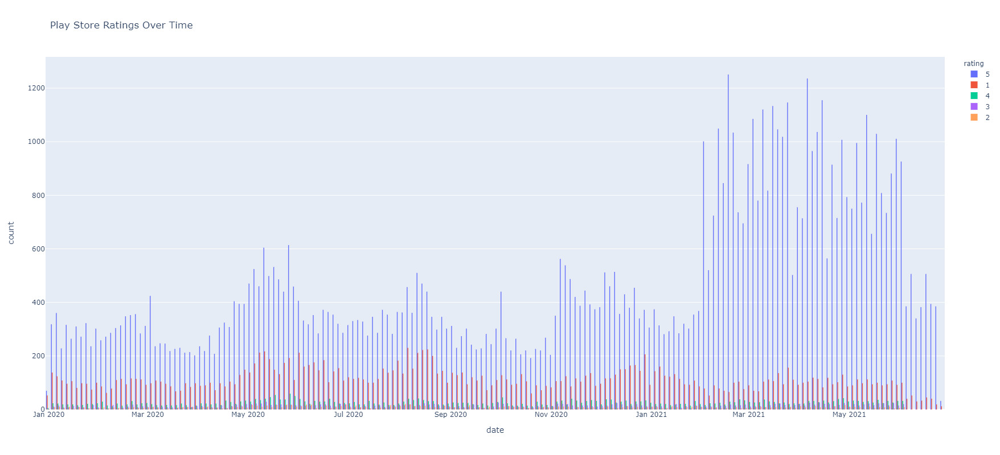

In [91]:
fig = px.histogram(
    complete_df.loc[(complete_df['type'] == 'play store')], 
    x='date',
    color='rating',
    title='Play Store Ratings Over Time',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

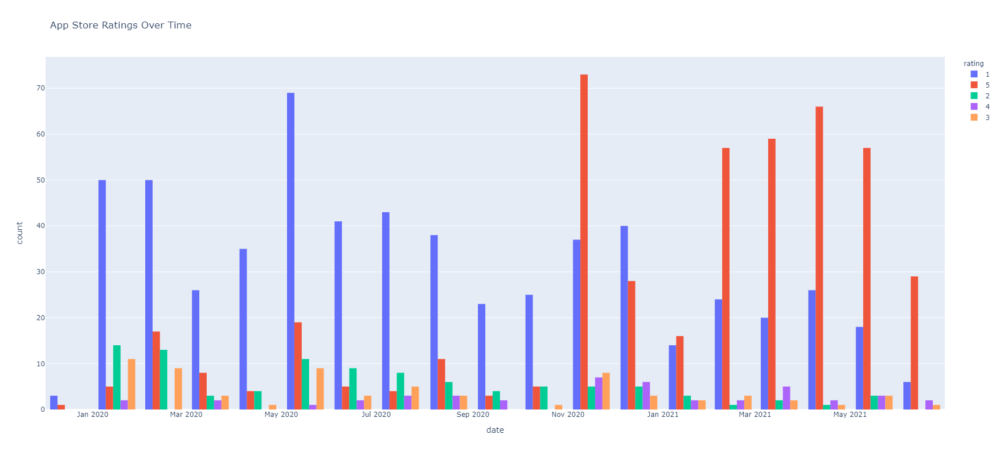

In [92]:
fig = px.histogram(
    complete_df.loc[(complete_df['type'] == 'app store')], 
    x='date',
    color='rating',
    title='App Store Ratings Over Time',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

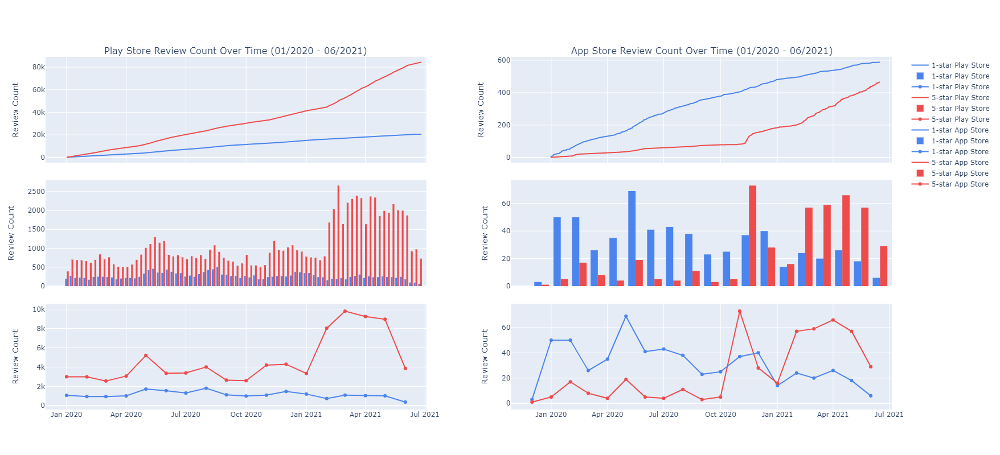

In [94]:
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# set default renderer
# for local
pio.renderers.default = "jupyterlab"

# for sagemaker
# pio.renderers.default = "iframe"

# disable false positive warning
pd.options.mode.chained_assignment = None  # default='warn'

ax_1 = combined_df.loc[(combined_df['type'] == 'play store') & (combined_df['rating'] == 1)]
ax_5 = combined_df.loc[(combined_df['type'] == 'play store') & (combined_df['rating'] == 5)]
ax_1 = ax_1.sort_values(by=['date'])
ax_5 = ax_5.sort_values(by=['date'])
ax_1['cumsum'] = ax_1['rating'].eq(1).cumsum()
ax_5['cumsum'] = ax_5['rating'].eq(5).cumsum()
ax_1_ratings = ax_1.groupby(['month', 'rating'])['review'].count().reset_index()
ax_5_ratings = ax_5.groupby(['month', 'rating'])['review'].count().reset_index()

bx_1 = combined_df.loc[(combined_df['type'] == 'app store') & (combined_df['rating'] == 1)]
bx_5 = combined_df.loc[(combined_df['type'] == 'app store') & (combined_df['rating'] == 5)]
bx_1 = bx_1.sort_values(by=['date'])
bx_5 = bx_5.sort_values(by=['date'])
bx_1['cumsum'] = bx_1['rating'].eq(1).cumsum()
bx_5['cumsum'] = bx_5['rating'].eq(5).cumsum()
bx_1_ratings = bx_1.groupby(['month', 'rating'])['review'].count().reset_index()
bx_5_ratings = bx_5.groupby(['month', 'rating'])['review'].count().reset_index()

fig = make_subplots(
    rows=3, 
    cols=2, 
    shared_xaxes=True,
    vertical_spacing=0.05,
    subplot_titles=("Play Store Review Count Over Time (01/2020 - 06/2021)", "App Store Review Count Over Time (01/2020 - 06/2021)")
)

# Play Store
fig.add_trace(
    go.Scatter(
        x=ax_1['date'],
        y=ax_1['cumsum'],
        name='1-star Play Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=1
)
fig.add_trace(
    go.Histogram(
        x=ax_1['date'],
        y=ax_1['rating'],
        name='1-star Play Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=1
)
fig.add_trace(
    go.Scatter(
        x=ax_1_ratings['month'],
        y=ax_1_ratings['review'],
        name='1-star Play Store',
        marker=dict(color='#4c84ed')
    ),
    row=3, 
    col=1
)
fig.add_trace(
    go.Scatter(
        x=ax_5['date'],
        y=ax_5['cumsum'],
        name='5-star Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=1
)
fig.add_trace(
    go.Histogram(
        x=ax_5['date'],
        y=ax_5['rating'],
        name='5-star Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=1
)
fig.add_trace(
    go.Scatter(
        x=ax_5_ratings['month'],
        y=ax_5_ratings['review'],
        name='5-star Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=3, 
    col=1
)

# App Store
fig.add_trace(
    go.Scatter(
        x=bx_1['date'],
        y=bx_1['cumsum'],
        name='1-star App Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=2
)
fig.add_trace(
    go.Histogram(
        x=bx_1['date'],
        y=bx_1['rating'],
        name='1-star App Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=2
)
fig.add_trace(
    go.Scatter(
        x=bx_1_ratings['month'],
        y=bx_1_ratings['review'],
        name='1-star App Store',
        marker=dict(color='#4c84ed')
    ),
    row=3, 
    col=2
)
fig.add_trace(
    go.Scatter(
        x=bx_5['date'],
        y=bx_5['cumsum'],
        name='5-star App Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=2
)
fig.add_trace(
    go.Histogram(
        x=bx_5['date'],
        y=bx_5['rating'],
        name='5-star App Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=2
)
fig.add_trace(
    go.Scatter(
        x=bx_5_ratings['month'],
        y=bx_5_ratings['review'],
        name='5-star App Store',
        marker=dict(color='#ed4c4c')
    ),
    row=3, 
    col=2
)

# Update yaxis properties
fig.update_yaxes(title_text="Review Count")
fig.update_layout(width=1450, height=800)
fig.show()

### Hour of the day
---

In [8]:
# Collect and store all App Store reviews in a temporary DF
ax = complete_df.loc[(complete_df['type'] == 'play store')]
ax = ax.sort_values(by=['date'])

# df = df.groupby([df['Date'].dt.hour, 'weekday'])['Cyclists'].sum().unstack().plot()

gps_avg_rating_hr = ax.groupby(ax['date'].dt.hour)['rating'].mean().reset_index().rename(
    columns = {'date' : 'hour'}
)
gps_avg_rating_hr.head()

,hour,rating
0,0,4.195641
1,1,4.222977
2,2,4.268557
3,3,4.236688
4,4,4.275362


In [9]:
# Collect and store all App Store reviews in a temporary DF
bx = complete_df.loc[(complete_df['type'] == 'app store')]
bx = bx.sort_values(by=['date'])

# df = df.groupby([df['Date'].dt.hour, 'weekday'])['Cyclists'].sum().unstack().plot()

as_avg_rating_hr = bx.groupby(bx['date'].dt.hour)['rating'].mean().reset_index().rename(
    columns = {'date' : 'hour'}
)
as_avg_rating_hr.head()

,hour,rating
0,0,2.416667
1,1,3.090909
2,2,2.818182
3,3,3.265957
4,4,2.827586


### Day of the week
---

In [10]:
days = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

gps_avg_rating_day = ax.groupby(ax['date'].dt.day_name())['rating'].mean().reindex(days).reset_index().rename(
    columns = {'date' : 'day'}
)
gps_avg_rating_day

,day,rating
0,Monday,4.230244
1,Tuesday,4.222005
2,Wednesday,4.214911
3,Thursday,4.251040
4,Friday,4.264988
5,Saturday,4.103372
6,Sunday,4.106192


In [11]:
as_avg_rating_day = bx.groupby(bx['date'].dt.day_name())['rating'].mean().reindex(days).reset_index().rename(
    columns = {'date' : 'day'}
)
as_avg_rating_day

,day,rating
0,Monday,2.928571
1,Tuesday,2.630682
2,Wednesday,3.015385
3,Thursday,2.527778
4,Friday,2.777174
5,Saturday,2.553571
6,Sunday,2.548611


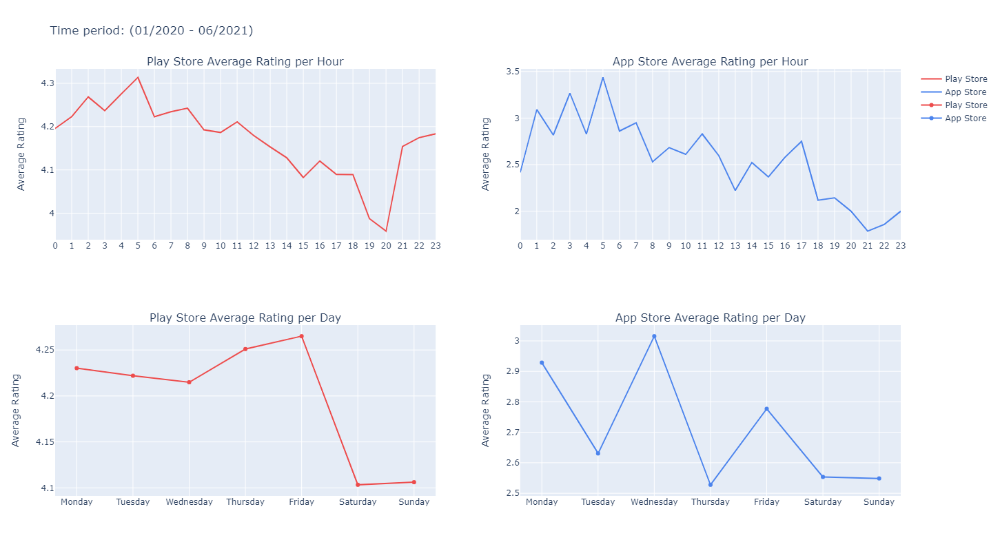

In [12]:
fig = make_subplots(
    rows=2, 
    cols=2, 
#     shared_xaxes=True,
#     shared_yaxes=True,
    vertical_spacing=0.2,
    subplot_titles=("Play Store Average Rating per Hour", "App Store Average Rating per Hour", \
                   "Play Store Average Rating per Day", "App Store Average Rating per Day")
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_hr['hour'],
        y=gps_avg_rating_hr['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_hr['hour'],
        y=as_avg_rating_hr['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=2
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_day['day'],
        y=gps_avg_rating_day['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_day['day'],
        y=as_avg_rating_day['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=2
)

fig.update_layout(title_text="Time period: (01/2020 - 06/2021)", width=1450, height=800)
# Update yaxis and xaxis properties
fig.update_yaxes(title_text="Average Rating")
fig.update_xaxes(dtick=1)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1700, height=800)

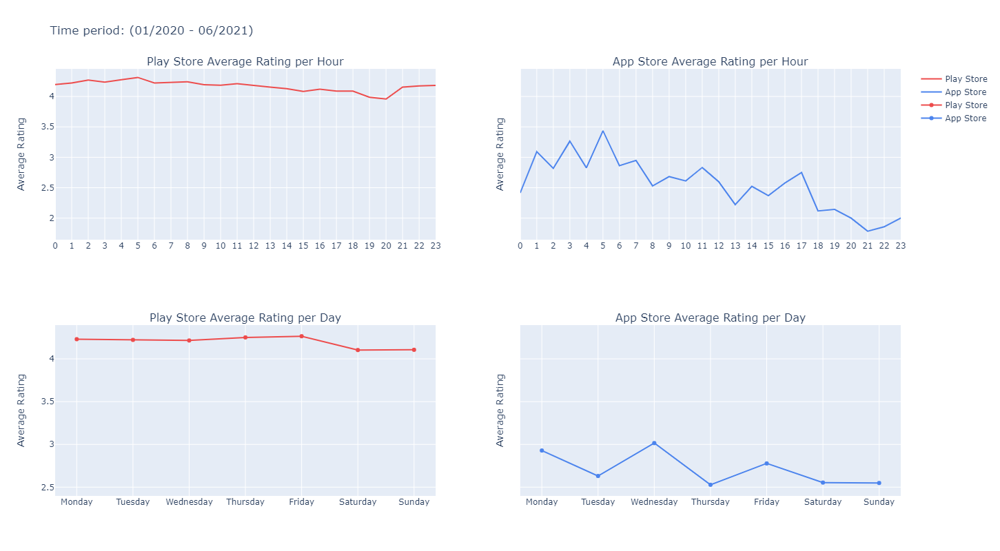

In [13]:
fig = make_subplots(
    rows=2, 
    cols=2, 
#     shared_xaxes=True,
    shared_yaxes=True,
    vertical_spacing=0.2,
    subplot_titles=("Play Store Average Rating per Hour", "App Store Average Rating per Hour", \
                   "Play Store Average Rating per Day", "App Store Average Rating per Day")
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_hr['hour'],
        y=gps_avg_rating_hr['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=1, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_hr['hour'],
        y=as_avg_rating_hr['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=1, 
    col=2
)

fig.add_trace(
    go.Scatter(
        x=gps_avg_rating_day['day'],
        y=gps_avg_rating_day['rating'],
        name='Play Store',
        marker=dict(color='#ed4c4c')
    ),
    row=2, 
    col=1
)

fig.add_trace(
    go.Scatter(
        x=as_avg_rating_day['day'],
        y=as_avg_rating_day['rating'],
        name='App Store',
        marker=dict(color='#4c84ed')
    ),
    row=2, 
    col=2
)

fig.update_layout(title_text="Time period: (01/2020 - 06/2021)", width=1450, height=800)
# Update yaxis and xaxis properties
fig.update_yaxes(title_text="Average Rating")
fig.update_xaxes(dtick=1)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1700, height=800)


Mean word count: 16.27364975450082
1-star mean word count: 25.46074032529445
5-star mean word count: 13.890268448238233


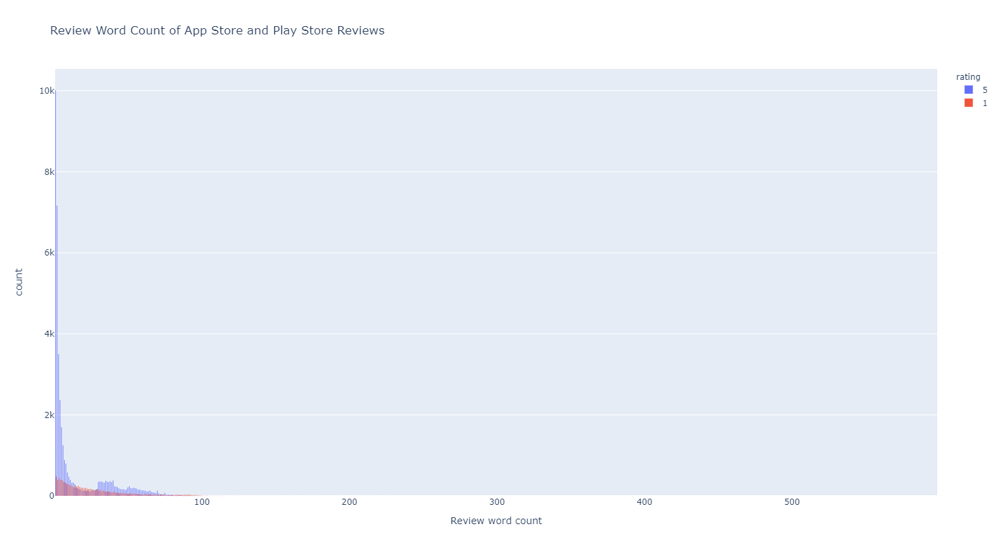

In [14]:
# init empty DF
cx = pd.DataFrame()

# Collect and store all App Store reviews in a temporary DF
cx = combined_df

mask = (complete_df['rating'] == 1)
cx_1 = complete_df.loc[mask]

mask = (complete_df['rating'] == 5)
cx_5 = complete_df.loc[mask]

cx['Review word count'] = cx['review'].str.split().str.len()
cx_1['Review word count'] = cx_1['review'].str.split().str.len()
cx_5['Review word count'] = cx_5['review'].str.split().str.len()
print(f"\nMean word count: {cx['Review word count'].mean()}")
print(f"1-star mean word count: {cx_1['Review word count'].mean()}")
print(f"5-star mean word count: {cx_5['Review word count'].mean()}")

fig = px.histogram(
    cx, 
    x='Review word count',
    color='rating',
    labels=['Word count', 'Review count'],
    title='Review Word Count of App Store and Play Store Reviews',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1000, height=500)

### Play Store

Total number of Play Store reviews: 50912
Total number of 1-star Play Store reviews: 10115
Total number of 5-star Play Store reviews: 40797

Play Store reviews mean word count: 15.816624764299183
1-star reviews mean word count: 24.300741473059812
5-star reviews mean word count: 13.713116160501997


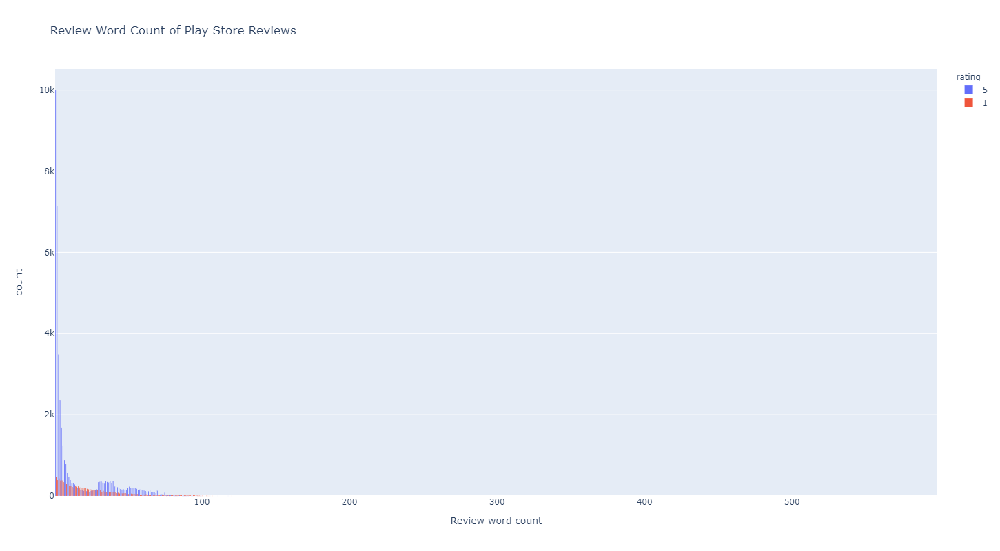

In [15]:
ax = combined_df.loc[(combined_df['type'] == 'play store')]
ax_ct = ax['review'].count()
ax_1_ct = ax_1['review'].count()
ax_5_ct = ax_5['review'].count()

print(f'Total number of Play Store reviews: {ax_ct}')
print(f'Total number of 1-star Play Store reviews: {ax_1_ct}')
print(f'Total number of 5-star Play Store reviews: {ax_5_ct}')

ax['Review word count'] = ax['review'].str.split().str.len()
ax_1['Review word count'] = ax_1['review'].str.split().str.len()
ax_5['Review word count'] = ax_5['review'].str.split().str.len()
print(f"\nPlay Store reviews mean word count: {ax['Review word count'].mean()}")
print(f"1-star reviews mean word count: {ax_1['Review word count'].mean()}")
print(f"5-star reviews mean word count: {ax_5['Review word count'].mean()}")

fig = px.histogram(
    ax, 
    x='Review word count',
    color='rating',
    labels=['Word count', 'Review count'],
    title='Review Word Count of Play Store Reviews',
    barmode='group'
)

fig.update_layout(width=1450, height=800)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1000, height=500)

### App Store

Total number of App Store reviews: 1023
Total number of 1-star App Store reviews: 583
Total number of 5-star App Store reviews: 440

App Store reviews mean word count: 39.018572825024435
1-star reviews mean word count: 45.58662092624357
5-star reviews mean word count: 30.31590909090909


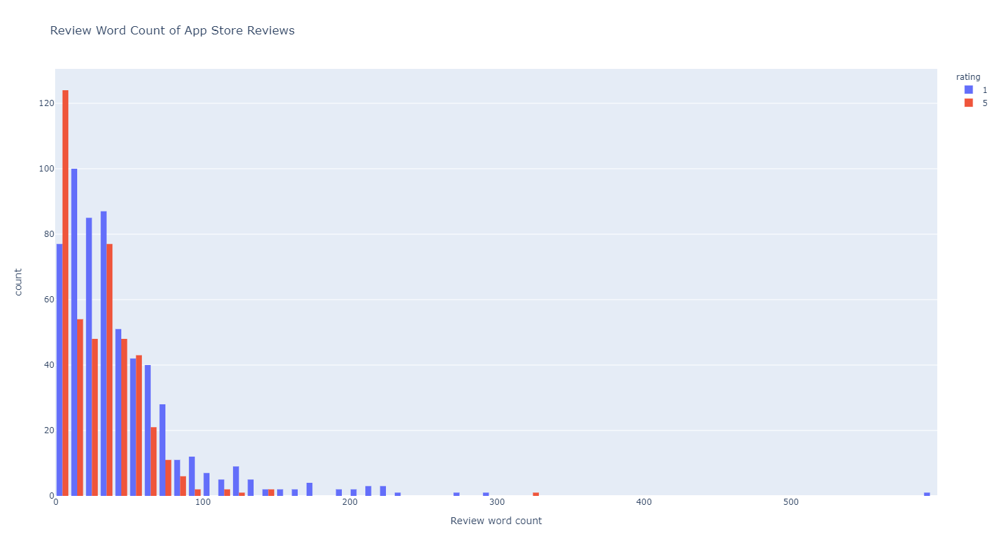

In [16]:
bx = combined_df.loc[(combined_df['type'] == 'app store')]
bx_ct = bx['review'].count()
bx_1_ct = bx_1['review'].count()
bx_5_ct = bx_5['review'].count()

print(f'Total number of App Store reviews: {bx_ct}')
print(f'Total number of 1-star App Store reviews: {bx_1_ct}')
print(f'Total number of 5-star App Store reviews: {bx_5_ct}')

bx['Review word count'] = bx['review'].str.split().str.len()
bx_1['Review word count'] = bx_1['review'].str.split().str.len()
bx_5['Review word count'] = bx_5['review'].str.split().str.len()
print(f"\nApp Store reviews mean word count: {bx['Review word count'].mean()}")
print(f"1-star reviews mean word count: {bx_1['Review word count'].mean()}")
print(f"5-star reviews mean word count: {bx_5['Review word count'].mean()}")

fig = px.histogram(
    bx, 
    x='Review word count',
    color='rating',
    labels=['Word count', 'Review count'],
    title='Review Word Count of App Store Reviews',
    barmode='group',
    width=1000, 
    height=500
)

fig.update_layout(width=1450, height=800)
fig.show()

# for graph to persist outside session
# fig.show(renderer="png", width=1000, height=500)

## Convert plain text to bag-of-words (BOW)
---

In [316]:
import re
import nltk
import spacy 
import string
import advertools as adv
from nltk import word_tokenize          
from nltk.stem import WordNetLemmatizer 
from spacy.lang.en.stop_words import STOP_WORDS
from nltk.corpus import wordnet, words, stopwords

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

# concatenate english and tagalog stopwords into one list
stop_words = stopwords.words('english') + list(adv.stopwords['tagalog']) + \
            ['gcash', 'could', 'doe', 'might', 'must', 'need', 'sha', \
             'would', 'far', 'nag', 'already', 'always', 'app', 'cant', \
             'dont', 'even', 'get', 'please', 'say', 'still', 'try', 'use', \
             'yung', 'day', 'keep', 'lang', 'like', 'make', 'nyo', 'the', 'to', \
             'ive', 'naman', 'one', 'take', 'fully', 'also', 'app..', \
             'give', 'much', 'okay', 'pag', 'sana', 'star', 'sya', 'thank', \
             'usefull', 'verry', 'wala', 'want', 'way', 'well', 'wow', 'didnt', \
             'every', 'guy', 'hope', 'kayo', 'know', 'let', 'link', 'mag', 'many', \
             'message', 'never', 'nothing', 'open', 'put', 'really', 'seem', 'start', \
             'thing', 'whenever', 'wont', 'wrong', 'yet', 'almost', 'anymore', 'back', \
             'come', 'doesnt', 'especially', 'everytime', 'first', 'globe', 'last', \
             'month', 'new', 'niyo', 'since', 'something', 'think', 'thru', 'ung', \
             'without', 'suppose', 'tapos', 'another', 'anything', 'u', 'thats', \
             'via', 'etc', 'everything', 'everywhere', 'find', 'io', 'life', \
             'list', 'lot', 'maybe', 'meter', 'next' , 'past', 'phone', 'pls', \
             'plus', 'point', 'pwede', 'see', 'show', 'sometimes', 'team', 'whats', \
             'wish', 'year', 'gamitin', 'girl', 'hand', 'happen', 'hello', 'high', \
             'however', 'hurt', 'though', 'true', 'usually', 'screen', 'soon', 'acc', \
             'add', 'yun', 'yes', 'youre', 'coz', 'acct', 'agad', 'line', 'long', 'today', \
             'go', 'abd', 'kna', 'luv', 'kna', 'god', 'wlang', 'yeah', 'id', 'idk', 'iam', \
            'ill', 'ina', 'padin', 'kahit', 'pede', 'nang', 'supper', 'khit', 'kahit', \
            'accnt', 'mka']

# Helper function to lemmatize with part of speech (POS) tag
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

token_pattern = re.compile(r"(?u)\b\w\w+\b")

class LemmaTokenizer(object):
    def __init__(self):
        self.wnl = WordNetLemmatizer()
    def __call__(self, doc):
        return [
            self.wnl.lemmatize(
                word.translate(str.maketrans('', '', string.punctuation)), 
                get_wordnet_pos(word.translate(str.maketrans('', '', string.punctuation)))
            ) 
            for word in word_tokenize(doc) 
            if len(word.translate(str.maketrans('', '', string.punctuation))) > 3
            and re.match("^[a-z0-9_\-]+$", word.translate(str.maketrans('', '', string.punctuation)))
            and re.match(token_pattern, word.translate(str.maketrans('', '', string.punctuation)))
        ]

[nltk_data] Downloading package punkt to /home/ec2-user/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/ec2-user/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/ec2-user/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/ec2-user/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


### Tokenize and lemmatize review data

In [317]:
import time
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

main_df = combined_df.loc[(combined_df['rating'] == 5)]

# split data to training (70%), validation (15%), and test (15%) datasets
train_data, val_data = train_test_split(main_df, train_size=0.86, random_state=42)
train_data, test_data = train_test_split(train_data, train_size=0.82, random_state=42) 

print(f'Training, validation, and test data shapes:\n{train_data.shape}')
print(val_data.shape)
print(test_data.shape)

# complete_batch = main_df.review.values.tolist()
first_batch = train_data.review.values.tolist()
second_batch = val_data.review.values.tolist()
third_batch = test_data.review.values.tolist()

vocab_size = 2000

print('\nTokenizing and counting, this may take a few minutes...')
start_time = time.time()
vectorizer = TfidfVectorizer(
    input='content', 
    analyzer='word', 
    stop_words=stop_words,
    tokenizer=LemmaTokenizer(),
    strip_accents='ascii',
    max_features=vocab_size, 
#     ngram_range=(2, 2),
    max_df=0.95, # maximum document frequency of 95% of documents
    min_df=2 # minimum document frequency of 2 documents
)

# Learn the vocabulary dictionary from the training data and return a document-term matrix
train_vectors = vectorizer.fit_transform(first_batch)
vocab_map = vectorizer.vocabulary_
vocab_list = vectorizer.get_feature_names()
removed_words = vectorizer.get_stop_words()
vocab_size = len(vocab_list)

# Extract token counts out of validation and test datasets using the vocabulary fitted with fit 
val_vectors = vectorizer.transform(second_batch)
test_vectors = vectorizer.transform(third_batch)

# complete_vectors = vectorizer.transform(complete_batch)

print(f'\nTraining rows, vocab length:\n{train_vectors.shape}')
print('\nVocab size:', vocab_size)
print(f'\nVocab list:\n{vocab_list}')
print('\nDone. Time elapsed: {:.2f}s'.format(time.time() - start_time))

Training, validation, and test data shapes:
(29079, 6)
(5774, 6)
(6384, 6)

Tokenizing and counting, this may take a few minutes...

Training rows, vocab length:
(29079, 2000)

Vocab size: 2000

Vocab list:
['1000', '1010', '1500', '2018', '2020', '2021', '5star', '5stars', 'ability', 'able', 'abroad', 'absolutely', 'accept', 'acceptable', 'accepted', 'accesible', 'access', 'accessibility', 'accessible', 'accommodate', 'accomodating', 'accomplish', 'account', 'accumulate', 'accurate', 'achieve', 'acknowledge', 'acquire', 'across', 'act', 'action', 'activate', 'active', 'activity', 'actual', 'actually', 'adapt', 'addict', 'addition', 'additional', 'additionally', 'address', 'adjust', 'administration', 'admire', 'advance', 'advancement', 'advantage', 'advantageous', 'advise', 'affiliate', 'affordable', 'afraid', 'agadagad', 'age', 'agency', 'agent', 'agree', 'ahead', 'aim', 'akala', 'akong', 'alam', 'allot', 'allow', 'allowance', 'allows', 'alone', 'along', 'alot', 'alright', 'alternativ

### Sort mapping of terms to feature indices.

In [318]:
vocab_map_items = vocab_map.items()
sorted_vocab_items = sorted(vocab_map_items)

aux_lst = []

for i in range(len(sorted_vocab_items)):
    aux_lst.append(sorted_vocab_items[i][0])

### Store in a text file

In [319]:
with open(f'data/vocab.txt', 'w') as f:
    for item in aux_lst:
        f.write("%s\n" % item)

### Verify results
---

### Training

In [320]:
print(f'\noriginal text:')
for i in range(5):
    print(f'\n{[i]} - {train_data.review.values.tolist()[i]}')


original text:

[0] - Along with the internet banking system, the software includes a variety of choices for users and choose their desired banker and move money in even the most cost-effective method.

[1] - I’m sooo happy that I downloaded paymaya! Lately, I realized that transactions are very crucial especially this time. But paymaya saved me from my worries, and now with just a few taps on the phone, I can settle bills and other things to pay for, easily.

[2] - Its more convinient than others

[3] - Great

[4] - Marami akong pwdng gawin sa apps na to like to save my money and to share to my love's one


In [321]:
import random 

value = random.randrange(0, 4)
# value = 0
print(f'index: {value}')
print(f'\noriginal text:\n{train_data.review.values.tolist()[value]}')
print(f'\nvectorized text:\n{train_vectors[value].todense()}')

index: 2

original text:
Its more convinient than others

vectorized text:
[[0. 0. 0. ... 0. 0. 0.]]


In [322]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

train_counts = pd.DataFrame(
    train_vectors[:5].toarray(),
    columns=vocab_list
)

train_counts

,1000,1010,1500,2018,2020,2021,5star,5stars,ability,able,abroad,absolutely,accept,acceptable,accepted,accesible,access,accessibility,accessible,accommodate,accomodating,accomplish,account,accumulate,accurate,achieve,acknowledge,acquire,across,act,action,activate,active,activity,actual,actually,adapt,addict,addition,additional,additionally,address,adjust,administration,admire,advance,advancement,advantage,advantageous,advise,affiliate,affordable,afraid,agadagad,age,agency,agent,agree,ahead,aim,akala,akong,alam,allot,allow,allowance,allows,alone,along,alot,alright,alternative,although,amaze,amazingly,amidst,among,amount,anak,andami,andaming,android,andyan,angas,anlaki,annoy,anong,answer,anybody,anyone,anytime,anyway,anywhere,apart,appeal,appear,appi,applicable,application,apply,appreciate,approach,approachable,appropriate,approve,apps,appvery,april,araw,area,around,arrange,arrangement,asap,aside,ask,aspect,asset,assist,assistance,association,assortment,assurance,assure,astig,astound,attain,attempt,automatic,automatically,avail,availability,available,avoid,aware,away,awesome,awsome,ayaw,ayos,ayun,babayad,babayaran,background,bad,bagal,bagay,bagong,bahay,baka,balance,balik,balikbayad,bangko,bank,banking,barcode,bargain,barya,base,basic,basically,basis,basta,bata,bawal,bawas,bayad,bayaran,bayarin,bayaring,bcoz,bearable,beat,beautiful,beauty,become,becomes,beep,begin,behind,believe,beneficial,benefit,besides,best,beyond,bibigyan,bibilhin,bibili,big,bigay,bigla,bigyan,bilhin,bili,bilis,bill,biller,billers,billing,binabayaran,binibigay,binibigyan,binibili,binili,bless,blessing,block,bonchon,bonus,book,boom,bother,bought,branch,brand,brilliant,bring,browse,budget,budgeting,buhay,built,bukas,bukod,bulsa,bumabalik,bumalik,bumibili,bumili,bunch,bundle,burden,business,busy,buti,button,buwan,buy,buyer,buying,cable,cafe,call,calm,capability,capable,capacity,card,...,straight,straightforward,strategy,strengthen,stress,stressful,strict,strong,structure,struggle,student,study,stuff,stun,style,submit,subok,subscription,substantial,success,successful,successfully,succession,suddenly,suggest,suggestion,suitable,sukli,sulit,super,superb,superior,supermarket,supplier,supply,support,sure,surely,surface,surprise,surprised,surprising,surprisingly,survive,swak,swear,sweet,swipe,switch,syang,syempre,synergy,system,tagal,takot,talaga,talagang,talk,talo,tama,tamang,taong,tap,tapon,task,tech,techie,technical,technique,technological,technology,techy,telco,tell,tend,tends,term,test,text,thankful,thanks,thankyou,therefore,thought,thoughtful,threat,three,throughout,thumb,thus,ticket,tier,tight,tignan,till,time,timely,timer,tindahan,tipid,tire,tiwala,together,told,tong,tool,topup,total,totally,totoo,touch,touchless,towards,trabaho,track,trade,traditional,transact,transaction,transactional,transfer,transition,transportation,trasactions,travel,treat,trip,trouble,troublesome,truly,trust,trustworthy,truth,tubig,tubo,tuition,tulong,tuloy,tumagal,turn,tutuusin,tuwa,tuwing,type,typical,ulit,unang,unbelievable,underrated,understand,understandable,understood,undoubtedly,unexpected,unique,unli,unlike,unlimited,unnecessary,update,upgrade,upgraded,upload,upon,urge,urgent,us,usable,usage,useable,useful,usefulness,useless,user,userfriendliness,userfriendly,usual,utility,utilize,utilized,valid,valuable,value,variety,various,verification,verify,versatile,versatility,version,verygood,vibe,video,view,virtual,virtually,virus,visa,visit,vital,voucher,wait,walk,wallet,warm,wasnt,waste,watch,water,website,week,weird,welcome,welldesigned,western,whatever,whatsoever,wherein,wherever,whether,whole,wide,widely,wife,wifi,willing,window,winner,winwin,wise,withdraw,withdrawal,within,wonder,wonderful,word,work,worker,world,worried,worry,worth,worthy,write,yall,yong,youll,young,zalora,zero
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

### Validation

In [323]:
print(f'\noriginal text:')
for i in range(5):
    print(f'\n{[i]} - {val_data.review.values.tolist()[i]}')


original text:

[0] - good

[1] - Nice to use

[2] - Nice

[3] - Convenient to any transactions...

[4] - Andaming magagawa kapag ito ang app na gamit mo. Paymaya is just your perfect app na need mo when it comes to convenience and consistent help. Super effective for all occasions!


In [324]:
value = random.randrange(0, 4)

print(f'index: {value}')
print(f'\noriginal text:\n{val_data.review.values.tolist()[value]}')
print(f'\nvectorized text:\n{val_vectors[value].todense()}')

index: 3

original text:
Convenient to any transactions...

vectorized text:
[[0. 0. 0. ... 0. 0. 0.]]


In [325]:
val_counts = pd.DataFrame(
    val_vectors[:5].toarray(),
    columns=vocab_list
)

val_counts

,1000,1010,1500,2018,2020,2021,5star,5stars,ability,able,abroad,absolutely,accept,acceptable,accepted,accesible,access,accessibility,accessible,accommodate,accomodating,accomplish,account,accumulate,accurate,achieve,acknowledge,acquire,across,act,action,activate,active,activity,actual,actually,adapt,addict,addition,additional,additionally,address,adjust,administration,admire,advance,advancement,advantage,advantageous,advise,affiliate,affordable,afraid,agadagad,age,agency,agent,agree,ahead,aim,akala,akong,alam,allot,allow,allowance,allows,alone,along,alot,alright,alternative,although,amaze,amazingly,amidst,among,amount,anak,andami,andaming,android,andyan,angas,anlaki,annoy,anong,answer,anybody,anyone,anytime,anyway,anywhere,apart,appeal,appear,appi,applicable,application,apply,appreciate,approach,approachable,appropriate,approve,apps,appvery,april,araw,area,around,arrange,arrangement,asap,aside,ask,aspect,asset,assist,assistance,association,assortment,assurance,assure,astig,astound,attain,attempt,automatic,automatically,avail,availability,available,avoid,aware,away,awesome,awsome,ayaw,ayos,ayun,babayad,babayaran,background,bad,bagal,bagay,bagong,bahay,baka,balance,balik,balikbayad,bangko,bank,banking,barcode,bargain,barya,base,basic,basically,basis,basta,bata,bawal,bawas,bayad,bayaran,bayarin,bayaring,bcoz,bearable,beat,beautiful,beauty,become,becomes,beep,begin,behind,believe,beneficial,benefit,besides,best,beyond,bibigyan,bibilhin,bibili,big,bigay,bigla,bigyan,bilhin,bili,bilis,bill,biller,billers,billing,binabayaran,binibigay,binibigyan,binibili,binili,bless,blessing,block,bonchon,bonus,book,boom,bother,bought,branch,brand,brilliant,bring,browse,budget,budgeting,buhay,built,bukas,bukod,bulsa,bumabalik,bumalik,bumibili,bumili,bunch,bundle,burden,business,busy,buti,button,buwan,buy,buyer,buying,cable,cafe,call,calm,capability,capable,capacity,card,...,straight,straightforward,strategy,strengthen,stress,stressful,strict,strong,structure,struggle,student,study,stuff,stun,style,submit,subok,subscription,substantial,success,successful,successfully,succession,suddenly,suggest,suggestion,suitable,sukli,sulit,super,superb,superior,supermarket,supplier,supply,support,sure,surely,surface,surprise,surprised,surprising,surprisingly,survive,swak,swear,sweet,swipe,switch,syang,syempre,synergy,system,tagal,takot,talaga,talagang,talk,talo,tama,tamang,taong,tap,tapon,task,tech,techie,technical,technique,technological,technology,techy,telco,tell,tend,tends,term,test,text,thankful,thanks,thankyou,therefore,thought,thoughtful,threat,three,throughout,thumb,thus,ticket,tier,tight,tignan,till,time,timely,timer,tindahan,tipid,tire,tiwala,together,told,tong,tool,topup,total,totally,totoo,touch,touchless,towards,trabaho,track,trade,traditional,transact,transaction,transactional,transfer,transition,transportation,trasactions,travel,treat,trip,trouble,troublesome,truly,trust,trustworthy,truth,tubig,tubo,tuition,tulong,tuloy,tumagal,turn,tutuusin,tuwa,tuwing,type,typical,ulit,unang,unbelievable,underrated,understand,understandable,understood,undoubtedly,unexpected,unique,unli,unlike,unlimited,unnecessary,update,upgrade,upgraded,upload,upon,urge,urgent,us,usable,usage,useable,useful,usefulness,useless,user,userfriendliness,userfriendly,usual,utility,utilize,utilized,valid,valuable,value,variety,various,verification,verify,versatile,versatility,version,verygood,vibe,video,view,virtual,virtually,virus,visa,visit,vital,voucher,wait,walk,wallet,warm,wasnt,waste,watch,water,website,week,weird,welcome,welldesigned,western,whatever,whatsoever,wherein,wherever,whether,whole,wide,widely,wife,wifi,willing,window,winner,winwin,wise,withdraw,withdrawal,within,wonder,wonderful,word,work,worker,world,worried,worry,worth,worthy,write,yall,yong,youll,young,zalora,zero
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

### Type-cast input data to np.float32 since all the params (i.e. weights and biases) in the NTM model will also follow that format
This is a more optimal approach as opposed to repeatedly type-casting during mini-batch training

In [326]:
import scipy.sparse as sparse

train_vectors = sparse.csr_matrix(train_vectors, dtype=np.float32)
val_vectors = sparse.csr_matrix(val_vectors, dtype=np.float32)
test_vectors = sparse.csr_matrix(test_vectors, dtype=np.float32)
# complete_vectors = sparse.csr_matrix(complete_vectors, dtype=np.float32)

print(f'index = {value}\n')
print(type(train_vectors), train_vectors.dtype)
print(train_vectors[value])
print(type(val_vectors), val_vectors.dtype)
print(val_vectors[value])
print(type(test_vectors), test_vectors.dtype)
print(test_vectors[value])
# print(type(complete_vectors), complete_vectors.dtype)
# print(complete_vectors[value])

index = 3

<class 'scipy.sparse.csr.csr_matrix'> float32
  (0, 702)	1.0
<class 'scipy.sparse.csr.csr_matrix'> float32
  (0, 1868)	0.7169367
  (0, 361)	0.69713825
<class 'scipy.sparse.csr.csr_matrix'> float32
  (0, 966)	1.0


### Convert data into RecordIO Protobuf format using the SageMaker Python API and store everything in S3

In [327]:
import scipy

# convert sparse CSR matrices to numpy arrays
train_vectors = scipy.sparse.csr_matrix.toarray(train_vectors)
val_vectors = scipy.sparse.csr_matrix.toarray(val_vectors)
test_vectors = scipy.sparse.csr_matrix.toarray(test_vectors)
# complete_vectors = scipy.sparse.csr_matrix.toarray(complete_vectors)

In [328]:
import io
import boto3
import sagemaker
import datetime as dt
import sagemaker.amazon.common as smac

sesh = sagemaker.Session()
prefix = "sagemaker/regalado"
bucket = sesh.default_bucket()
curr_dtime = time.strftime("%Y%m%d-%H%M%S")

def convAndStore(dtype, key, vectors):
    # convert data to a recordIO-wrapped protobuf format used by the Amazon SageMaker algorithms
    key = str(key)
    
    # init memory buffer in RAM where data will be written
    buf = io.BytesIO()

    # write train data (numpy array) into a dense tensor 
    # smac.write_numpy_to_dense_tensor(buf, X_train.astype("float32"), y_train.astype("float32"))
    smac.write_numpy_to_dense_tensor(buf, vectors)

    # sets the file's current position at the offset (0)
    # i.e. set the reference point to the beginning of the memory buffer
    buf.seek(0)

    # upload to s3
    boto3.resource("s3").Bucket(bucket).Object(os.path.join(prefix, dtype, key)).upload_fileobj(buf)
    
    s3_data = f"s3://{bucket}/{prefix}/{dtype}/{key}"
    
    print(f"Uploaded {dtype} data at: {s3_data}")
    
    return s3_data
    
s3_train_data = convAndStore('train', curr_dtime, train_vectors)
s3_valid_data = convAndStore('valid', curr_dtime, val_vectors)
s3_test_data = convAndStore('test', curr_dtime, test_vectors)

Uploaded train data at: s3://sagemaker-us-east-1-305262579855/sagemaker/regalado/train/20210701-150427
Uploaded valid data at: s3://sagemaker-us-east-1-305262579855/sagemaker/regalado/valid/20210701-150427
Uploaded test data at: s3://sagemaker-us-east-1-305262579855/sagemaker/regalado/test/20210701-150427


### Upload vocab file to s3

In [329]:
s3_aux_path = sesh.upload_data(path=f'data/vocab.txt', key_prefix=prefix + '/input/auxiliary')
s3_aux_path

's3://sagemaker-us-east-1-305262579855/sagemaker/regalado/input/auxiliary/vocab.txt'

### Configure TrainingInput objects to use the training, validation, and test datasets that were uploaded to S3 

In [330]:
from sagemaker.session import TrainingInput

s3_train = TrainingInput(s3_train_data, distribution='FullyReplicated') # set distribution='ShardedByS3Key' if using multiple EC2 instances
s3_valid = TrainingInput(s3_valid_data) 
s3_test = TrainingInput(s3_test_data) 

## Model training
---

### Set credentials

In [331]:
from sagemaker import tuner
from sagemaker import get_execution_role
from sagemaker.image_uris import retrieve

role = get_execution_role()
region = boto3.Session().region_name    
container = retrieve('ntm', region)
client = boto3.Session().client('sagemaker')
output_prefix = os.path.join(prefix, 'output')
output_path = os.path.join('s3://', bucket, output_prefix)

2021-07-01 15:04:46,012 | INFO | image_uris.py:162 | _config_for_framework_and_scope | Same images used for training and inference. Defaulting to image scope: inference.
2021-07-01 15:04:46,013 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: 1.
2021-07-01 15:04:46,027 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.


In [332]:
!pip install 'sagemaker[local]' --upgrade

You should consider upgrading via the '/home/ec2-user/anaconda3/envs/python3/bin/python3.6 -m pip install --upgrade pip' command.


In [333]:
!sudo service docker restart

Stopping docker: [  OK  ]
Starting docker:	.[  OK  ]


### Initialize Estimator object

In [331]:
ntm = sagemaker.estimator.Estimator(
    container,
    role, 
    instance_count=1, 
    instance_type='ml.m4.xlarge', # Free-tier instance
    output_path=output_path,
    sagemaker_session=sesh
)

In [332]:
num_topics = 2

ntm.set_hyperparameters(
    num_topics=num_topics, 
    feature_dim=vocab_size, 
    num_patience_epochs=5,
    epochs=200, 
    sub_sample=0.2,
    batch_norm=True
)

## Automatic Hyperparameter Tuning
---

In [333]:
hyperparameter_ranges = {
    'weight_decay': tuner.ContinuousParameter(0.1, 1.0),
    'mini_batch_size': tuner.IntegerParameter(16, 2048),
    'learning_rate': tuner.ContinuousParameter(1e-4, 0.1),
    'rescale_gradient': tuner.ContinuousParameter(0.1, 1.0),
    'optimizer': tuner.CategoricalParameter(['sgd', 'adam', 'adadelta']),
    'encoder_layers_activation': tuner.CategoricalParameter(['sigmoid', 'tanh', 'relu'])
}

objective_metric_name = 'validation:total_loss'

In [334]:
hyperparameter_tuner = tuner.HyperparameterTuner(
    ntm,
    objective_metric_name,
    hyperparameter_ranges, 
    objective_type='Minimize',
    max_jobs=10,
    max_parallel_jobs=5
)

In [335]:
hyperparameter_tuner.fit(
    {"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path},
    include_cls_metadata=False,
    wait=False
)

job_name = hyperparameter_tuner.latest_tuning_job.job_name

response = client.describe_hyper_parameter_tuning_job(
    HyperParameterTuningJobName=job_name
)

response['HyperParameterTuningJobStatus']

2021-07-01 12:00:18,135 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-01 12:00:18,150 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-01 12:00:18,153 | INFO | session.py:2050 | create_tuning_job | Creating hyperparameter tuning job with name: ntm-210701-1200


'InProgress'

In [336]:
from pprint import pprint

pprint(response)

{'CreationTime': datetime.datetime(2021, 7, 1, 12, 0, 18, 485000, tzinfo=tzlocal()),
 'HyperParameterTuningJobArn': 'arn:aws:sagemaker:us-east-1:305262579855:hyper-parameter-tuning-job/ntm-210701-1200',
 'HyperParameterTuningJobConfig': {'HyperParameterTuningJobObjective': {'MetricName': 'validation:total_loss',
                                                                        'Type': 'Minimize'},
                                   'ParameterRanges': {'CategoricalParameterRanges': [{'Name': 'optimizer',
                                                                                       'Values': ['sgd',
                                                                                                  'adam',
                                                                                                  'adadelta']},
                                                                                      {'Name': 'encoder_layers_activation',
                                      

In [337]:
hyperparameter_tuner.__dict__

{'estimator': <sagemaker.estimator.Estimator at 0x7f4721535438>,
 'objective_metric_name': 'validation:total_loss',
 '_hyperparameter_ranges': {'weight_decay': <sagemaker.parameter.ContinuousParameter at 0x7f470bdbbb38>,
  'mini_batch_size': <sagemaker.parameter.IntegerParameter at 0x7f470bdbbc88>,
  'learning_rate': <sagemaker.parameter.ContinuousParameter at 0x7f470bdbb470>,
  'rescale_gradient': <sagemaker.parameter.ContinuousParameter at 0x7f4726b8c5f8>,
  'optimizer': <sagemaker.parameter.CategoricalParameter at 0x7f470bd86160>,
  'encoder_layers_activation': <sagemaker.parameter.CategoricalParameter at 0x7f470bd86390>},
 'metric_definitions': None,
 'estimator_dict': None,
 'objective_metric_name_dict': None,
 '_hyperparameter_ranges_dict': None,
 'metric_definitions_dict': None,
 'static_hyperparameters_dict': None,
 'strategy': 'Bayesian',
 'objective_type': 'Minimize',
 'max_jobs': 10,
 'max_parallel_jobs': 5,
 'tags': None,
 'base_tuning_job_name': None,
 '_current_job_name':

In [338]:
tuning_job_name = response['HyperParameterTuningJobName']
%store tuning_job_name

tuning_job_name

Stored 'tuning_job_name' (str)


'ntm-210701-1200'

In [339]:
from time import sleep

while response['HyperParameterTuningJobStatus'] == 'InProgress':
    response = client.describe_hyper_parameter_tuning_job(
        HyperParameterTuningJobName=job_name
    )

    print(response['HyperParameterTuningJobStatus'])
    sleep(60)

InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
InProgress
Completed


In [340]:
%store -r tuning_job_name

from sagemaker import HyperparameterTuningJobAnalytics

def latest_df():
    analytics = HyperparameterTuningJobAnalytics(tuning_job_name)

    return analytics.dataframe()    

latest_df().sort_values('FinalObjectiveValue', ascending=True)

,encoder_layers_activation,learning_rate,mini_batch_size,optimizer,rescale_gradient,weight_decay,TrainingJobName,TrainingJobStatus,FinalObjectiveValue,TrainingStartTime,TrainingEndTime,TrainingElapsedTimeSeconds
3,tanh,0.000568,725.0,adadelta,0.331837,0.336371,ntm-210701-1200-007-f4255e42,Completed,4.355488,2021-07-01 12:08:14+00:00,2021-07-01 12:09:56+00:00,102.0
0,sigmoid,0.000876,539.0,adadelta,0.619909,0.329879,ntm-210701-1200-010-9e8a1697,Completed,4.370687,2021-07-01 12:09:36+00:00,2021-07-01 12:11:06+00:00,90.0
5,tanh,0.018132,127.0,adadelta,0.660262,0.207707,ntm-210701-1200-005-aa5b2722,Completed,4.377845,2021-07-01 12:02:53+00:00,2021-07-01 12:05:04+00:00,131.0
2,sigmoid,0.044712,227.0,adadelta,0.734953,0.194857,ntm-210701-1200-008-f7cdf24b,Completed,4.378152,2021-07-01 12:08:24+00:00,2021-07-01 12:10:16+00:00,112.0
6,sigmoid,0.000698,99.0,adadelta,0.475383,0.685956,ntm-210701-1200-004-4aa3890f,Completed,4.378627,2021-07-01 12:04:07+00:00,2021-07-01 12:05:41+00:00,94.0
8,tanh,0.012132,352.0,adam,0.928333,0.222963,ntm-210701-1200-002-1e16afe0,Completed,4.384618,2021-07-01 12:04:54+00:00,2021-07-01 12:06:16+00:00,82.0
7,tanh,0.090019,138.0,adam,0.541815,0.680136,ntm-210701-1200-003-89ea608b,Completed,4.400523,2021-07-01 12:03:52+00:00,2021-07-01 12:05:17+00:00,85.0
1,relu,0.055112,1440.0,sgd,0.971379,0.276595,ntm-210701-1200-009-fc124ff6,Completed,NaN,2021-07-01 12:09:22+00:00,2021-07-01 12:12:21+00:00,179.0
4,relu,0.063277,1440.0,sgd,0.989379,0.294595,ntm-210701-1200-006-ed76a4b9,Completed,NaN,2021-07-01 12:07:47+00:00,2021-07-01 12:10:52+00:00,185.0
9,sigmoid,0.010725,793.0,sgd,0.943575,0.646936,ntm-210701-1200-001-a470e0c9,Completed,NaN,2021-07-01 12:03:32+00:00,2021-07-01 12:06:17+00:00,165.0


## Retrain model with the best hyperparameter values to instantiate an Estimator object required to deploy a SageMaker endpoint
---

## 1-star model
---

In [259]:
sesh = sagemaker.Session()

ntm = sagemaker.estimator.Estimator(
    container,
    role, 
    instance_count=1, 
    instance_type='ml.m4.xlarge', # Free-tier instance (Free Tier usage per month for the first 2 months) ~ https://aws.amazon.com/sagemaker/pricing/
    output_path=output_path,
    sagemaker_session=sesh
)

# Best config ~ ~ ~ ~ ~ ~ 
# sigmoid	0.000154	1784.0	adam	0.925563	0.449741

num_topics = 5

ntm.set_hyperparameters(
    num_topics=num_topics, 
    feature_dim=vocab_size, 
    num_patience_epochs=5,
    epochs=200, 
    batch_norm=True,
    sub_sample=0.2,
    encoder_layers_activation='sigmoid',
    learning_rate=0.000154,
    mini_batch_size=1784,
    optimizer='adam',
    rescale_gradient=0.925563,
    weight_decay=0.449741
)

In [104]:
print(f'vocab size = {vocab_size}')
print(f'topic count = {num_topics}')
# print(f'\nplatform: {main_df.type.values[0]}\nrating: {main_df.rating.values[0]}')

vocab size = 500
topic count = 5


In [261]:
# WETC - The word embedding topic coherence metric measures the similarity of words in a topic by using a pre-trained word embedding, Glove-6B-400K-50d.
# TU - The topic unicity tells us how unique the word groups per topic are used overall (i.e. Are these meaningful words?)
# Note: A high (closer to 1) TU represents a high topic uniqueness for the topics detected.
# A high WETC value indicates a higher degree of topic coherence. A typical value would be in the range of 0.2 to 0.8

ntm.fit(inputs={"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path})

2021-07-01 08:16:47,875 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-01 08:16:47,888 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-01 08:16:47,889 | INFO | session.py:570 | train | Creating training-job with name: ntm-2021-07-01-08-16-47-873


2021-07-01 08:16:48 Starting - Starting the training job...
2021-07-01 08:17:13 Starting - Launching requested ML instancesProfilerReport-1625127407: InProgress
...
2021-07-01 08:17:48 Starting - Preparing the instances for training.........
2021-07-01 08:19:17 Downloading - Downloading input data...
2021-07-01 08:19:34 Training - Downloading the training image...
2021-07-01 08:20:13 Training - Training image download completed. Training in progress.Docker entrypoint called with argument(s): train
Running default environment configuration script
/opt/amazon/lib/python3.7/site-packages/jsonref.py:8: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping, MutableMapping, Sequence
[07/01/2021 08:20:07 INFO 139633678108480] Reading default configuration from /opt/amazon/lib/python3.7/site-packages/algorithm/default-input.json: {'encoder_layers': 'au

## Deploy endpoint
---

In [262]:
ntm_predictor = ntm.deploy(initial_instance_count=1, instance_type='ml.m4.xlarge', wait=False)

2021-07-01 08:23:14,276 | INFO | session.py:2552 | create_model | Creating model with name: ntm-2021-07-01-08-23-14-221
2021-07-01 08:23:14,950 | INFO | session.py:2973 | create_endpoint | Creating endpoint with name ntm-2021-07-01-08-23-14-221


## Perform sample inferences
---

In [24]:
test_vectors.shape

(1656, 2021)

In [48]:
from sagemaker.serializers import CSVSerializer
from sagemaker.deserializers import JSONDeserializer

count = 1000

# 1-star 
topics = ['negative user experience', 'customer service', 'transaction issues', 'account issues (i.e. registration, login)', 'app issues (i.e. update and version errors)']

predictor = sagemaker.predictor.Predictor(
    endpoint_name=ntm_predictor.endpoint_name, 
    sagemaker_session=sesh, 
    serializer=CSVSerializer(), 
    deserializer=JSONDeserializer()
)

# predictor.update_endpoint()

results = predictor.predict(test_vectors[:count])
print(f'Raw prediction/s:\n{results}')

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])
print(f'\nPredicted topic weights:\n{predictions}\n\nSorted topic assignment scores per input document:')

for i in results['predictions']:
    sorted_indexes = np.argsort(i['topic_weights']).tolist()
    sorted_indexes.reverse()
    top_topics = [topics[j] for j in sorted_indexes]
    top_weights = [i['topic_weights'][j] for j in sorted_indexes]
    pairs = list(zip(top_topics, top_weights))
    print(pairs)

Raw prediction/s:
{'predictions': [{'topic_weights': [0.1872974485, 0.2019408941, 0.2012459636, 0.2087641507, 0.2007515877]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1876471341, 0.1971496344, 0.2053144723, 0.209697023, 0.200191766]}, {'topic_weights': [0.1900820732, 0.2020884156, 0.2200448811, 0.1951573193, 0.192627281]}, {'topic_weights': [0.1836376935, 0.193987757, 0.218250379, 0.1972583383, 0.2068657726]}, {'topic_weights': [0.1841616035, 0.1997839361, 0.2073328346, 0.2051507533, 0.2035708576]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1876930892, 0.2068368495, 0.2084136605, 0.1936222762, 0.2034340501]}, {'topic_weights': [0.185751453, 0.2019747645, 0.2170419991, 0.1960915029, 0.1991402805]}, {'topic_weights': [0.1872803569, 0.2017197609, 0.2146429121, 0.1926596165, 0.2036973536]}, {'topic_weights': [0.1848309487, 0.2035575807, 0.2228554189, 

In [17]:
results = {'predictions': [{'topic_weights': [0.1872974485, 0.2019408941, 0.2012459636, 0.2087641507, 0.2007515877]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1876471341, 0.1971496344, 0.2053144723, 0.209697023, 0.200191766]}, {'topic_weights': [0.1900820732, 0.2020884156, 0.2200448811, 0.1951573193, 0.192627281]}, {'topic_weights': [0.1836376935, 0.193987757, 0.218250379, 0.1972583383, 0.2068657726]}, {'topic_weights': [0.1841616035, 0.1997839361, 0.2073328346, 0.2051507533, 0.2035708576]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1876930892, 0.2068368495, 0.2084136605, 0.1936222762, 0.2034340501]}, {'topic_weights': [0.185751453, 0.2019747645, 0.2170419991, 0.1960915029, 0.1991402805]}, {'topic_weights': [0.1872803569, 0.2017197609, 0.2146429121, 0.1926596165, 0.2036973536]}, {'topic_weights': [0.1848309487, 0.2035575807, 0.2228554189, 0.1934111267, 0.19534491]}, {'topic_weights': [0.1849979609, 0.1995641142, 0.2220229805, 0.1949362606, 0.1984786838]}, {'topic_weights': [0.1892836839, 0.2014959902, 0.2119719833, 0.199639678, 0.197608605]}, {'topic_weights': [0.1829183102, 0.2063733786, 0.2181292325, 0.1964443922, 0.1961347312]}, {'topic_weights': [0.1836099178, 0.197246179, 0.2087049186, 0.2129040062, 0.1975349784]}, {'topic_weights': [0.1853816658, 0.1945955455, 0.2129510492, 0.204651624, 0.2024200559]}, {'topic_weights': [0.187237516, 0.1961643994, 0.2106995285, 0.205386132, 0.2005124688]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1884699911, 0.1983189136, 0.2062598169, 0.2088858038, 0.1980654299]}, {'topic_weights': [0.1872734874, 0.1959545463, 0.2134537101, 0.1966660619, 0.2066522241]}, {'topic_weights': [0.1910887957, 0.1941403598, 0.2004258931, 0.2158101499, 0.1985347718]}, {'topic_weights': [0.1859690845, 0.1972886324, 0.2142258734, 0.1995974332, 0.2029190212]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1898028105, 0.2015736252, 0.2152482271, 0.1963975877, 0.1969777495]}, {'topic_weights': [0.1891633123, 0.2043081671, 0.2121603638, 0.1971919835, 0.1971762031]}, {'topic_weights': [0.189425841, 0.2055553347, 0.2081269473, 0.1967685223, 0.2001233697]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1867332011, 0.20595783, 0.2188153118, 0.188422516, 0.2000711411]}, {'topic_weights': [0.1886182874, 0.2002037764, 0.2088362873, 0.1991039366, 0.2032376975]}, {'topic_weights': [0.1906076074, 0.2024389952, 0.2074268609, 0.1983149201, 0.2012116015]}, {'topic_weights': [0.1902730167, 0.2007958889, 0.2101870924, 0.1934767962, 0.2052672803]}, {'topic_weights': [0.1862509549, 0.2068790197, 0.2072191387, 0.2011680603, 0.1984828711]}, {'topic_weights': [0.1914249808, 0.2028740048, 0.2124798894, 0.1968279928, 0.1963931769]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1879787594, 0.1996940523, 0.2055075616, 0.2000684142, 0.2067511678]}, {'topic_weights': [0.1870199144, 0.204884246, 0.2071752101, 0.2011912316, 0.1997293979]}, {'topic_weights': [0.1862781942, 0.1982999891, 0.2105839849, 0.2002827972, 0.204554975]}, {'topic_weights': [0.1856614202, 0.2053999156, 0.2086611837, 0.1968764812, 0.2034009993]}, {'topic_weights': [0.1856650412, 0.1939275861, 0.2092837393, 0.2086600214, 0.202463612]}, {'topic_weights': [0.1867970675, 0.1926314384, 0.2092094421, 0.2114204168, 0.1999416202]}, {'topic_weights': [0.1843307167, 0.2061799765, 0.203942731, 0.2023827583, 0.2031637579]}, {'topic_weights': [0.1912144423, 0.2006391436, 0.2143092901, 0.1991621554, 0.1946749836]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1850129366, 0.19904989, 0.2099327296, 0.2108799815, 0.1951244622]}, {'topic_weights': [0.1865093559, 0.2025919408, 0.2130011469, 0.1933908314, 0.2045067698]}, {'topic_weights': [0.1910921186, 0.2004010677, 0.2074552625, 0.2043070048, 0.1967445016]}, {'topic_weights': [0.1813213229, 0.2075431794, 0.21562168, 0.196364522, 0.1991492808]}, {'topic_weights': [0.1892639697, 0.1955380738, 0.203585878, 0.2079146951, 0.2036973536]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1871562004, 0.1974028945, 0.2134283632, 0.1982691735, 0.2037433535]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.185666129, 0.2000426799, 0.2125184089, 0.1942080408, 0.2075647414]}, {'topic_weights': [0.185389474, 0.2061091214, 0.2176654935, 0.1870492995, 0.2037865818]}, {'topic_weights': [0.1881522685, 0.1990043372, 0.2027345449, 0.2099720985, 0.2001368105]}, {'topic_weights': [0.1828333437, 0.2038372904, 0.2197668999, 0.1950110346, 0.1985514313]}, {'topic_weights': [0.1883041114, 0.204742834, 0.2176965624, 0.1947211027, 0.1945354044]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.19084391, 0.200446412, 0.2095176876, 0.1971195191, 0.2020724118]}, {'topic_weights': [0.1871485114, 0.2076075077, 0.2141925693, 0.1904093921, 0.2006420493]}, {'topic_weights': [0.187824741, 0.204134196, 0.2096726149, 0.1963113546, 0.2020570636]}, {'topic_weights': [0.1845841408, 0.2003013045, 0.2127398998, 0.1994302869, 0.2029444426]}, {'topic_weights': [0.1869781017, 0.1957579404, 0.2011181861, 0.2117717415, 0.2043740153]}, {'topic_weights': [0.1898256689, 0.2026427537, 0.2115355432, 0.1936998963, 0.2022960931]}, {'topic_weights': [0.1882054061, 0.198648423, 0.213477239, 0.1991749108, 0.200494051]}, {'topic_weights': [0.1874928027, 0.204780072, 0.2057853639, 0.1998503655, 0.2020914257]}, {'topic_weights': [0.1897927374, 0.1984139085, 0.2114234418, 0.2000116557, 0.2003582418]}, {'topic_weights': [0.1872068942, 0.197912544, 0.2063705325, 0.2022420615, 0.2062680125]}, {'topic_weights': [0.1865222752, 0.1980417818, 0.2059648484, 0.2037041932, 0.2057669461]}, {'topic_weights': [0.1873291135, 0.1944862455, 0.2153444141, 0.2032279372, 0.1996122897]}, {'topic_weights': [0.1857875884, 0.1938998997, 0.2166718394, 0.2002840787, 0.2033566236]}, {'topic_weights': [0.1897781938, 0.1982278377, 0.2029056102, 0.2032281905, 0.2058600932]}, {'topic_weights': [0.184212774, 0.2023890465, 0.2174376994, 0.1950347126, 0.2009257227]}, {'topic_weights': [0.1835517585, 0.2085226029, 0.2226715684, 0.1913069189, 0.1939472109]}, {'topic_weights': [0.188819319, 0.1972199231, 0.2059859931, 0.2059672475, 0.2020075023]}, {'topic_weights': [0.1896365583, 0.2018511146, 0.2059510648, 0.2079249322, 0.1946363896]}, {'topic_weights': [0.1901146173, 0.2079953998, 0.2171793282, 0.1906525195, 0.1940580755]}, {'topic_weights': [0.1900469214, 0.1976750344, 0.2071803659, 0.2094568908, 0.1956407428]}, {'topic_weights': [0.189777106, 0.1935473382, 0.2074334025, 0.2089864463, 0.2002556473]}, {'topic_weights': [0.1884338558, 0.2044511139, 0.2037220001, 0.2043524534, 0.1990405917]}, {'topic_weights': [0.1880807877, 0.2030189484, 0.2167850137, 0.1940254271, 0.1980898231]}, {'topic_weights': [0.1908778995, 0.199877575, 0.2065348923, 0.2006991804, 0.2020104378]}, {'topic_weights': [0.1884580702, 0.1997604668, 0.2116437852, 0.1960996836, 0.2040380836]}, {'topic_weights': [0.1829078794, 0.2036071271, 0.2121963054, 0.2038387209, 0.1974499375]}, {'topic_weights': [0.1873878837, 0.2035656124, 0.2125736326, 0.1966028363, 0.1998700947]}, {'topic_weights': [0.1882314831, 0.2019358873, 0.2078126371, 0.2005628049, 0.2014572471]}, {'topic_weights': [0.1855117232, 0.2003320754, 0.2095602751, 0.2019663304, 0.2026296258]}, {'topic_weights': [0.1878070682, 0.2041649073, 0.2077150941, 0.2000644356, 0.20024845]}, {'topic_weights': [0.1901286691, 0.1980369538, 0.2123855203, 0.1943711489, 0.2050777674]}, {'topic_weights': [0.1849129945, 0.2007413507, 0.2143465281, 0.1981800944, 0.2018190324]}, {'topic_weights': [0.1832847297, 0.1994211525, 0.2072234601, 0.2106864899, 0.1993842125]}, {'topic_weights': [0.1846382916, 0.2017238736, 0.2062809914, 0.2063203603, 0.201036498]}, {'topic_weights': [0.1860619485, 0.2036452293, 0.2072700709, 0.2088491023, 0.1941736639]}, {'topic_weights': [0.1863584071, 0.1964495033, 0.1990443021, 0.2191165686, 0.1990312189]}, {'topic_weights': [0.1878407001, 0.2017177194, 0.2102402747, 0.1992686093, 0.2009326816]}, {'topic_weights': [0.1878983974, 0.2005955726, 0.1972099096, 0.2109985203, 0.2032976449]}, {'topic_weights': [0.1870593429, 0.203223601, 0.2131747007, 0.1991528124, 0.197389558]}, {'topic_weights': [0.1846602708, 0.205719322, 0.2192222327, 0.1885945648, 0.2018036246]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.188944295, 0.2044096142, 0.2226278782, 0.1871865243, 0.1968317181]}, {'topic_weights': [0.1907610744, 0.2010391951, 0.2163906097, 0.2003716826, 0.1914373934]}, {'topic_weights': [0.1884430647, 0.2001586854, 0.208581686, 0.1998082846, 0.2030082792]}, {'topic_weights': [0.1868194193, 0.2042472959, 0.2221427113, 0.18606098, 0.2007296234]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1854228526, 0.2009938955, 0.2064691931, 0.2096033096, 0.1975106746]}, {'topic_weights': [0.1911705136, 0.200840354, 0.2050546259, 0.2056396306, 0.1972948909]}, {'topic_weights': [0.1876484305, 0.2036527842, 0.2198114693, 0.1954444945, 0.1934427768]}, {'topic_weights': [0.1901861727, 0.1933903545, 0.2051184028, 0.2051529735, 0.2061521113]}, {'topic_weights': [0.1867551804, 0.2040426582, 0.2226552516, 0.1850480288, 0.2014988512]}, {'topic_weights': [0.1894216686, 0.2011485547, 0.2049161494, 0.2102873772, 0.1942262501]}, {'topic_weights': [0.1845714897, 0.2056595981, 0.2165184766, 0.1994844675, 0.193765983]}, {'topic_weights': [0.1883870959, \
0.2036502361, 0.2117834836, 0.190663442, 0.205515787]}, {'topic_weights': [0.1850679517, 0.2069279552, 0.2207285613, 0.1919431984, 0.1953323483]}, {'topic_weights': [0.1881283373, 0.19994317, 0.2046876848, 0.21149683, 0.1957440227]}, {'topic_weights': [0.1857832372, 0.2016060054, 0.217056185, 0.1977789253, 0.1977756768]}, {'topic_weights': [0.1908328831, 0.19093211, 0.2082214952, 0.2045342475, 0.2054792196]}, {'topic_weights': [0.1908741891, 0.1988071054, 0.212364614, 0.1983937025, 0.1995604187]}, {'topic_weights': [0.1879917085, 0.1955735534, 0.2106066942, 0.1999463737, 0.2058817297]}, {'topic_weights': [0.1795938462, 0.2036390752, 0.2204081863, 0.1965600699, 0.1997988373]}, {'topic_weights': [0.1859578192, 0.2035633624, 0.199823752, 0.209628582, 0.2010265142]}, {'topic_weights': [0.1885341555, 0.2019413412, 0.2132691443, 0.193512395, 0.202742964]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1881636381, 0.2012791783, 0.2083650082, 0.2010311484, 0.201161027]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1918183565, 0.2041769028, 0.2188937813, 0.1890536696, 0.1960572898]}, {'topic_weights': [0.1873270869, 0.196654588, 0.2045578659, 0.2161058336, 0.1953545511]}, {'topic_weights': [0.1837098747, 0.2081991136, 0.2067028433, 0.2008608282, 0.2005272806]}, {'topic_weights': [0.1867001653, 0.1961708218, 0.2160757333, 0.1982240975, 0.202829197]}, {'topic_weights': [0.188070938, 0.2058770806, 0.223548308, 0.1841223836, 0.1983813196]}, {'topic_weights': [0.1886735111, 0.1975106299, 0.2028583139, 0.2109009027, 0.2000566572]}, {'topic_weights': [0.1862525642, 0.1999066621, 0.2092537731, 0.2009364218, 0.2036506087]}, {'topic_weights': [0.1882650554, 0.2039393336, 0.2147256881, 0.1977657229, 0.1953041553]}, {'topic_weights': [0.1887973547, 0.1965392381, 0.2107007504, 0.2049482763, 0.1990143955]}, {'topic_weights': [0.188511163, 0.2001805454, 0.2111996412, 0.1989170611, 0.2011915743]}, {'topic_weights': [0.1884255707, 0.2037258744, 0.2119080275, 0.2012267262, 0.1947137564]}, {'topic_weights': [0.1907627136, 0.2033519298, 0.2063242048, 0.2026156932, 0.1969454736]}, {'topic_weights': [0.1856963187, 0.2053616643, 0.2089729905, 0.2042940408, 0.1956749856]}, {'topic_weights': [0.1923347861, 0.200473696, 0.2156811953, 0.1936765909, 0.1978337616]}, {'topic_weights': [0.1879179925, 0.2004527599, 0.2073066235, 0.1992583871, 0.2050642371]}, {'topic_weights': [0.1871909052, 0.1970945448, 0.2084575891, 0.2017119378, 0.2055450082]}, {'topic_weights': [0.1904840022, 0.1993128657, 0.2036668211, 0.2029490173, 0.2035872787]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1912432313, 0.2029400617, 0.2057119012, 0.2008228749, 0.1992819607]}, {'topic_weights': [0.1803593189, 0.2034670562, 0.2145546526, 0.2030800432, 0.1985389292]}, {'topic_weights': [0.18885611, 0.2042155415, 0.2117489278, 0.1967604458, 0.19841896]}, {'topic_weights': [0.1883205026, 0.1968636364, 0.2107018977, 0.2048532069, 0.1992607713]}, {'topic_weights': [0.1892764866, 0.2040528059, 0.2065596133, 0.2086951137, 0.1914159805]}, {'topic_weights': [0.1854230165, 0.2021092623, 0.2113480568, 0.1973435879, 0.2037760466]}, {'topic_weights': [0.1874533445, 0.1991300881, 0.2163074017, 0.1938936859, 0.2032154351]}, {'topic_weights': [0.1854768395, 0.196223259, 0.2105587125, 0.2033345848, 0.2044066042]}, {'topic_weights': [0.1921321154, 0.20125404, 0.2168734074, 0.1928186864, 0.1969217509]}, {'topic_weights': [0.1872822195, 0.2039114088, 0.2134669423, 0.1966471821, 0.1986922175]}, {'topic_weights': [0.1890009046, 0.1983743459, 0.2113800943, 0.2056951225, 0.1955495477]}, {'topic_weights': [0.1855298877, 0.1928365231, 0.2023691088, 0.2182444036, 0.2010200918]}, {'topic_weights': [0.1907024831, 0.196165815, 0.198204577, 0.218677476, 0.1962496489]}, {'topic_weights': [0.1894809306, 0.1999550313, 0.2127685845, 0.195364669, 0.2024307549]}, {'topic_weights': [0.1879362762, 0.2021665722, 0.2166867256, 0.195358187, 0.1978522241]}, {'topic_weights': [0.1892929971, 0.1944357753, 0.2155349255, 0.1952269375, 0.2055093497]}, {'topic_weights': [0.1885303259, 0.1971342564, 0.2040205598, 0.2022320926, 0.2080827951]}, {'topic_weights': [0.1868062764, 0.2001288533, 0.2110783011, 0.2041373998, 0.1978491396]}, {'topic_weights': [0.1882394701, 0.2046389729, 0.2022601515, 0.2030750662, 0.2017863691]}, {'topic_weights': [0.1852919757, 0.1967019141, 0.2079892457, 0.2094645202, 0.200552389]}, {'topic_weights': [0.1886141896, 0.1988365948, 0.2010709494, 0.2059312165, 0.2055470496]}, {'topic_weights': [0.1847030222, 0.2051019669, 0.2151757181, 0.1942907423, 0.2007286102]}, {'topic_weights': [0.1896170229, 0.2006303072, 0.2066055536, 0.1973205656, 0.2058265507]}, {'topic_weights': [0.1869823635, 0.2050190717, 0.2153552473, 0.1941973418, 0.1984460056]}, {'topic_weights': [0.1922228634, 0.2016364336, 0.2119707018, 0.1937465072, 0.2004235387]}, {'topic_weights': [0.1870885342, 0.2029200196, 0.2173117846, 0.189363569, 0.2033160478]}, {'topic_weights': [0.1857414991, 0.1993304342, 0.2044888437, 0.208715573, 0.2017236948]}, {'topic_weights': [0.1859147102, 0.1968980432, 0.2125151902, 0.1955560148, 0.2091160268]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1880270839, 0.204478249, 0.2121142745, 0.194124639, 0.201255694]}, {'topic_weights': [0.1876097172, 0.2034070641, 0.2114820629, 0.2010324895, 0.1964686811]}, {'topic_weights': [0.1873500943, 0.1976850629, 0.2090142369, 0.2091068178, 0.1968438029]}, {'topic_weights': [0.1934571713, 0.1995150596, 0.2113974392, 0.1953171939, 0.2003131509]}, {'topic_weights': [0.1835970581, 0.1996836513, 0.2173448801, 0.1997633874, 0.1996110082]}, {'topic_weights': [0.1834507585, 0.2012384236, 0.2247290015, 0.1925797164, 0.1980021149]}, {'topic_weights': [0.1884673983, 0.2025142908, 0.2127414644, 0.1972182393, 0.1990586221]}, {'topic_weights': [0.1864026785, 0.2072802335, 0.2084856778, 0.2057382315, 0.1920931637]}, {'topic_weights': [0.1905133426, 0.2032185495, 0.2134327739, 0.1975351721, 0.195300132]}, {'topic_weights': [0.1820403785, 0.2044690996, 0.2199664116, 0.1975108832, 0.1960132271]}, {'topic_weights': [0.1920144409, 0.201685369, 0.2192261219, 0.1875511706, 0.1995229423]}, {'topic_weights': [0.1856616437, 0.1994482428, 0.2082596868, 0.2029835433, 0.203646794]}, {'topic_weights': [0.1877512783, 0.1943743676, 0.2021219283, 0.2113738954, 0.2043785304]}, {'topic_weights': [0.1881463975, 0.2015613019, 0.2216426581, 0.1852781326, 0.2033715248]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1841611713, 0.2071266472, 0.2221460491, 0.1871765107, 0.1993895918]}, {'topic_weights': [0.1899077445, 0.1962234229, 0.2072439343, 0.2077352405, 0.1988896728]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.186780259, 0.1941969693, 0.2056274712, 0.2106898278, 0.2027054876]}, {'topic_weights': [0.1831257939, 0.1990103871, 0.2134639919, 0.1992399544, 0.2051599473]}, {'topic_weights': [0.1897970289, 0.2040486038, 0.212733984, 0.1983066052, 0.195113793]}, {'topic_weights': [0.1878355294, 0.1996641904, 0.2173368782, 0.1977942735, 0.1973691583]}, {'topic_weights': [0.1833348572, 0.2026431412, 0.2174402922, 0.1938702464, 0.2027114481]}, {'topic_weights': [0.1897717267, 0.1988739222, 0.2153393924, 0.1922543049, 0.2037605792]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1918142438, 0.2054114938, 0.2110824585, 0.1909012496, 0.2007905543]}, {'topic_weights': [0.1886252165, 0.2020974457, 0.2153318524, 0.1994073987, 0.1945380867]}, {'topic_weights': [0.1867982298, 0.2032504231, 0.2110983133, 0.1928043216, 0.2060486972]}, {'topic_weights': [0.1912930012, 0.1972480565, 0.2045365572, 0.2027606666, 0.2041617185]}, {'topic_weights': [0.1842725724, 0.2058949322, 0.2244594246, 0.1898830235, 0.1954900622]}, {'topic_weights': [0.1919584125, 0.1976124793, 0.2121243775, 0.2030980587, 0.1952066422]}, {'topic_weights': [0.1888109744, 0.197780177, 0.2058750391, 0.2069283575, 0.2006054968]}, {'topic_weights': [0.1894077957, 0.1973936111, 0.1992640793, 0.2140690684, 0.1998655349]}, {'topic_weights': [0.1858279705, 0.1992185116, 0.2159502059, 0.2011759728, 0.1978273243]}, {'topic_weights': [0.1888577342, 0.2008402795, 0.212376669, 0.1999198049, 0.1980054975]}, {'topic_weights': [0.1857514381, 0.2012129128, 0.2061812729, 0.2076391876, 0.1992152184]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1890009046, 0.1983743459, 0.2113800943, 0.2056951225, 0.1955495477]}, {'topic_weights': [0.1902497858, 0.204767555, 0.2145715356, 0.1950867325, 0.1953243315]}, {'topic_weights': [0.1902969927, 0.1951004267, 0.208014369, 0.2012543827, 0.2053338587]}, {'topic_weights': [0.1890513152, 0.2023060173, 0.2014712989, 0.2048582733, 0.2023131102]}, {'topic_weights': [0.1868716329, 0.2016921043, 0.2039329261, 0.2110581994, 0.1964451522]}, {'topic_weights': [0.1800410748, 0.2070933431, 0.219588697, 0.1904562265, 0.2028206289]}, {'topic_weights': [0.1890912652, 0.2064987868, 0.2102840245, 0.1997693479, 0.1943565458]}, {'topic_weights': [0.1894161552, 0.2018665671, 0.2199766785, 0.1899012178, 0.1988394111]}, {'topic_weights': [0.1866835207, 0.2036235034, 0.2068226039, 0.2005478293, 0.2023225129]}, {'topic_weights': [0.1833068877, 0.2022894472, 0.223793149, 0.1925183684, 0.1980920583]}, {'topic_weights': [0.1885837913, 0.2019590437, 0.1991618872, 0.2118043154, 0.1984909773]}, {'topic_weights': [0.1896170229, 0.2006303072, 0.2066055536, 0.1973205656, 0.2058265507]}, {'topic_weights': [0.1867242455, 0.2091981918, 0.2134045362, 0.195822224, 0.1948508322]}, \
{'topic_weights': [0.190571174, 0.204195708, 0.2094830871, 0.2018991858, 0.1938508153]}, {'topic_weights': [0.1887530535, 0.2000611871, 0.2163290977, 0.19076024, 0.2040964067]}, {'topic_weights': [0.1872700751, 0.201104328, 0.2160590589, 0.1955064088, 0.2000601292]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1875051707, 0.2027530372, 0.2113618851, 0.2058760077, 0.1925038546]}, {'topic_weights': [0.1851005107, 0.2063313872, 0.2078823447, 0.2004316151, 0.2002541423]}, {'topic_weights': [0.188259095, 0.1945279539, 0.220788449, 0.1953328103, 0.2010916919]}, {'topic_weights': [0.1808717698, 0.2070425898, 0.2234985828, 0.1861435771, 0.2024435252]}, {'topic_weights': [0.1905165166, 0.1959535182, 0.2147076428, 0.2019742131, 0.1968480796]}, {'topic_weights': [0.1860198677, 0.1977740377, 0.2187069207, 0.1982663572, 0.1992328167]}, {'topic_weights': [0.1850758493, 0.1991050988, 0.2133084685, 0.2038118392, 0.1986986995]}, {'topic_weights': [0.1905734092, 0.2077453285, 0.2119719237, 0.1936174035, 0.196091935]}, {'topic_weights': [0.1813003868, 0.2038086802, 0.2124906033, 0.2042309791, 0.1981693804]}, {'topic_weights': [0.1869435906, 0.2055390328, 0.2149444818, 0.1874148697, 0.2051580548]}, {'topic_weights': [0.1858325303, 0.2021606416, 0.2214851379, 0.191627562, 0.1988940984]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.190792501, 0.2000446171, 0.2136308849, 0.1997532845, 0.1957786828]}, {'topic_weights': [0.1929889917, 0.2005415857, 0.211147815, 0.192868486, 0.2024531066]}, {'topic_weights': [0.1882939488, 0.199687168, 0.2044912875, 0.2047771215, 0.2027505189]}, {'topic_weights': [0.1883529872, 0.2037763298, 0.22037898, 0.1921379715, 0.1953537464]}, {'topic_weights': [0.1890946031, 0.2023674846, 0.2158354074, 0.1937391907, 0.1989632994]}, {'topic_weights': [0.1831210703, 0.200962618, 0.2137190104, 0.2010005265, 0.2011967599]}, {'topic_weights': [0.1868282706, 0.2046905309, 0.2031079978, 0.2080658674, 0.197307393]}, {'topic_weights': [0.183973819, 0.1998936385, 0.2154733986, 0.1996004432, 0.2010587305]}, {'topic_weights': [0.1874711812, 0.2044823319, 0.2150178701, 0.1919748187, 0.2010538131]}, {'topic_weights': [0.1841128767, 0.2052506953, 0.2147755474, 0.1960023344, 0.1998585612]}, {'topic_weights': [0.1845557541, 0.1990423352, 0.2073350549, 0.208243832, 0.2008229643]}, {'topic_weights': [0.1888663471, 0.1996444017, 0.2050648481, 0.2060384303, 0.2003859729]}, {'topic_weights': [0.1882979274, 0.195027858, 0.208057031, 0.206505999, 0.2021112144]}, {'topic_weights': [0.1926161498, 0.1961261779, 0.2006523311, 0.2129048705, 0.1977004707]}, {'topic_weights': [0.187593326, 0.206643343, 0.2175246775, 0.1899329275, 0.1983056366]}, {'topic_weights': [0.1879957616, 0.2040295899, 0.2102009803, 0.1978872269, 0.1998863816]}, {'topic_weights': [0.182282418, 0.1960598975, 0.2126154006, 0.2057473212, 0.2032950222]}, {'topic_weights': [0.1889841706, 0.1981650442, 0.2120143324, 0.2040103972, 0.1968261153]}, {'topic_weights': [0.1867884398, 0.2029721588, 0.2232669145, 0.1926655471, 0.1943068802]}, {'topic_weights': [0.1824121326, 0.2019823939, 0.2186509669, 0.1970249116, 0.1999295801]}, {'topic_weights': [0.1870865971, 0.2009292543, 0.2005888969, 0.2095488459, 0.2018463612]}, {'topic_weights': [0.1833972782, 0.2016552985, 0.2254658192, 0.1896233261, 0.199858278]}, {'topic_weights': [0.1872355491, 0.2028196156, 0.2119592279, 0.1977767497, 0.2002088726]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1849534512, 0.2033243179, 0.2173411846, 0.1974386424, 0.1969423592]}, {'topic_weights': [0.191250205, 0.1996632665, 0.211883828, 0.1969188452, 0.2002837807]}, {'topic_weights': [0.1879274845, 0.2004083544, 0.2062237412, 0.209047839, 0.1963925958]}, {'topic_weights': [0.1878756434, 0.209156245, 0.2208627164, 0.187366724, 0.1947386861]}, {'topic_weights': [0.1877437234, 0.2043296397, 0.2061851919, 0.2002603412, 0.2014811337]}, {'topic_weights': [0.186724171, 0.1948222816, 0.2223721594, 0.1952496171, 0.2008318007]}, {'topic_weights': [0.1876583993, 0.2057413459, 0.2091150433, 0.1985623091, 0.1989228576]}, {'topic_weights': [0.1896170229, 0.2006303072, 0.2066055536, 0.1973205656, 0.2058265507]}, {'topic_weights': [0.1853057444, 0.199889794, 0.2173385024, 0.1986141652, 0.1988517642]}, {'topic_weights': [0.1885962486, 0.1966052353, 0.2044543326, 0.2070378214, 0.2033062875]}, {'topic_weights': [0.1856185496, 0.1997573227, 0.2265639156, 0.188601315, 0.1994588673]}, {'topic_weights': [0.1896170229, 0.2006303072, 0.2066055536, 0.1973205656, 0.2058265507]}, {'topic_weights': [0.1857924312, 0.2010532171, 0.2097283304, 0.1991360039, 0.2042900324]}, {'topic_weights': [0.1860942692, 0.2034460455, 0.2213627249, 0.1889142245, 0.2001827657]}, {'topic_weights': [0.1859840304, 0.2007972002, 0.2119515836, 0.2022310644, 0.1990360916]}, {'topic_weights': [0.1853065789, 0.2027353495, 0.2130766511, 0.2009561658, 0.1979251951]}, {'topic_weights': [0.1899691373, 0.2032721192, 0.2098608166, 0.1983206719, 0.1985772103]}, {'topic_weights': [0.1882806718, 0.2000368237, 0.2131553143, 0.1972232759, 0.2013038993]}, {'topic_weights': [0.1865489632, 0.2002236843, 0.2195049971, 0.1989735514, 0.1947488189]}, {'topic_weights': [0.1835085303, 0.2045301348, 0.2113887668, 0.19904989, 0.2015226483]}, {'topic_weights': [0.18276757, 0.2048275918, 0.2173601091, 0.193621546, 0.2014232278]}, {'topic_weights': [0.1879142225, 0.2012217939, 0.2129621655, 0.1998866796, 0.1980150938]}, {'topic_weights': [0.1868535727, 0.1979455352, 0.2036667615, 0.2087750286, 0.2027591318]}, {'topic_weights': [0.1900839508, 0.1991804689, 0.213487789, 0.1991253197, 0.1981225014]}, {'topic_weights': [0.189272061, 0.2062675506, 0.2142117471, 0.1975157261, 0.1927329451]}, {'topic_weights': [0.1866311133, 0.2077242285, 0.2149023116, 0.1899320781, 0.2008103132]}, {'topic_weights': [0.1933114976, 0.1991602033, 0.2129272074, 0.1961730272, 0.1984280199]}, {'topic_weights': [0.1896170229, 0.2006303072, 0.2066055536, 0.1973205656, 0.2058265507]}, {'topic_weights': [0.189075008, 0.1939309537, 0.214270547, 0.1985293031, 0.2041941434]}, {'topic_weights': [0.1886582971, 0.1957207769, 0.2101816386, 0.2023466378, 0.2030926198]}, {'topic_weights': [0.1922228634, 0.2016364336, 0.2119707018, 0.1937465072, 0.2004235387]}, {'topic_weights': [0.1867818981, 0.1947676539, 0.217342481, 0.1996664405, 0.2014415711]}, {'topic_weights': [0.1827045083, 0.2037884146, 0.2168566287, 0.1970074177, 0.1996429861]}, {'topic_weights': [0.1882239282, 0.1985926926, 0.202640757, 0.210469082, 0.2000735253]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1900834292, 0.1969584525, 0.2109839469, 0.2056139559, 0.1963602304]}, {'topic_weights': [0.1884430647, 0.2001586854, 0.208581686, 0.1998082846, 0.2030082792]}, {'topic_weights': [0.187122196, 0.2079927623, 0.2113350779, 0.1981568784, 0.1953930706]}, {'topic_weights': [0.1870063096, 0.2028507441, 0.2173172385, 0.1901731342, 0.2026525587]}, {'topic_weights': [0.1876091063, 0.2021022141, 0.2134664655, 0.2016048133, 0.1952173561]}, {'topic_weights': [0.1857197434, 0.2006049007, 0.2113475204, 0.19914639, 0.2031814158]}, {'topic_weights': [0.1853725463, 0.197436139, 0.2118584812, 0.2045945972, 0.2007382363]}, {'topic_weights': [0.1855867654, 0.2049128264, 0.2059204429, 0.2035460919, 0.2000338584]}, {'topic_weights': [0.1895250976, 0.1947207153, 0.2036610693, 0.2166963369, 0.1953968257]}, {'topic_weights': [0.1846176237, 0.1991256624, 0.2129822224, 0.1973370463, 0.2059374899]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1879702061, 0.2073734999, 0.2184555233, 0.1877480298, 0.1984527558]}, {'topic_weights': [0.1874520928, 0.1988572329, 0.213531673, 0.2026354223, 0.1975235194]}, {'topic_weights': [0.1884462088, 0.1972839981, 0.1988642812, 0.2132702172, 0.2021352947]}, {'topic_weights': [0.188695237, 0.2018056959, 0.210756287, 0.1973252147, 0.2014175802]}, {'topic_weights': [0.1887611598, 0.2024988234, 0.2123437226, 0.1918432117, 0.2045531124]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1862865388, 0.2051045001, 0.2157678306, 0.1920745969, 0.2007665038]}, {'topic_weights': [0.1871598363, 0.1928822249, 0.2097887993, 0.2063060254, 0.2038631588]}, {'topic_weights': [0.1854223609, 0.1990698278, 0.208970964, 0.2056215554, 0.2009153664]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1918630749, 0.1986339241, 0.2035517693, 0.2104637623, 0.1954874694]}, {'topic_weights': [0.1859765053, 0.1971013993, 0.2129074484, 0.2016624212, 0.2023522258]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1849159598, 0.2006100565, 0.2151456773, 0.1962152123, 0.2031131387]}, {'topic_weights': [0.1873415709, 0.1975838095, 0.2114982605, 0.1978092343, 0.2057670355]}, {'topic_weights': [0.1889784634, 0.1921376437, 0.2124207765, 0.2039318532, 0.2025312036]}, {'topic_weights': [0.1839634478, 0.200695619, 0.2065630555, 0.2114585042, 0.1973193586]}, {'topic_weights': [0.1871598363, 0.1928822249, 0.2097887993, 0.2063060254, 0.2038631588]}, {'topic_weights': [0.1859590262, 0.2057347745, 0.2105217576, 0.1956853718, 0.20209907]}, {'topic_weights': [0.1870486587, 0.1980852634, 0.2054908574, 0.2062736899, 0.2031015754]}, {'topic_weights': [0.189018324, 0.1983742118, 0.2111068219, 0.1951448172, 0.2063557506]}, {'topic_weights': [0.1896929741, 0.2024835795, 0.2047504336, 0.2043127716, 0.1987603158]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1867446899, 0.1970201284, 0.2180330306, \
0.1964541376, 0.2017481029]}, {'topic_weights': [0.188469708, 0.2015104443, 0.2200175226, 0.1922810972, 0.1977212429]}, {'topic_weights': [0.1879211217, 0.201294452, 0.2008259892, 0.2114953399, 0.1984630674]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1844293326, 0.2015673965, 0.2177972198, 0.1973944306, 0.1988116205]}, {'topic_weights': [0.1815215349, 0.2038966119, 0.215675205, 0.1928180307, 0.2060886323]}, {'topic_weights': [0.1881222427, 0.1991704553, 0.198220104, 0.2120263726, 0.2024607807]}, {'topic_weights': [0.1912403852, 0.1979154199, 0.2090267092, 0.2027948648, 0.1990226507]}, {'topic_weights': [0.1894504577, 0.2018108368, 0.2148541659, 0.2027154267, 0.1911690682]}, {'topic_weights': [0.1857576072, 0.2057992667, 0.217857182, 0.1856421232, 0.2049438208]}, {'topic_weights': [0.1880010217, 0.1984219402, 0.2045807391, 0.2132031322, 0.1957931519]}, {'topic_weights': [0.18524459, 0.2028691173, 0.2048618495, 0.2120224088, 0.1950020492]}, {'topic_weights': [0.1868017465, 0.1962288022, 0.2023630291, 0.2130049318, 0.2016015202]}, {'topic_weights': [0.1834406257, 0.1988638192, 0.2265311927, 0.1892573237, 0.2019069791]}, {'topic_weights': [0.1812726855, 0.2046223581, 0.2216578126, 0.1885203123, 0.2039268017]}, {'topic_weights': [0.188272953, 0.2040283531, 0.218324095, 0.1826734543, 0.2067012042]}, {'topic_weights': [0.1874014437, 0.1961687505, 0.222719878, 0.1932617128, 0.2004482746]}, {'topic_weights': [0.1867437214, 0.1957772076, 0.2095017433, 0.2059243172, 0.2020529658]}, {'topic_weights': [0.1903239489, 0.2000129521, 0.1999082565, 0.2075484097, 0.2022064179]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1916515976, 0.2014389038, 0.2182892561, 0.1928167343, 0.1958035082]}, {'topic_weights': [0.1851981431, 0.2031679153, 0.2204700112, 0.1924083084, 0.1987556219]}, {'topic_weights': [0.1879563332, 0.1977574229, 0.2162222415, 0.1997031271, 0.19836092]}, {'topic_weights': [0.1890777498, 0.1985736936, 0.2009438425, 0.2093191743, 0.2020855248]}, {'topic_weights': [0.1863765866, 0.1985328645, 0.1992874444, 0.2123774737, 0.2034256458]}, {'topic_weights': [0.1850880831, 0.1947725564, 0.2072410733, 0.2119558305, 0.2009424865]}, {'topic_weights': [0.1884260923, 0.1991644651, 0.2107869536, 0.1985807419, 0.2030417323]}, {'topic_weights': [0.1847374141, 0.2043450475, 0.2216998041, 0.189911291, 0.1993064731]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1884745657, 0.2055830657, 0.2184120119, 0.190359965, 0.1971703768]}, {'topic_weights': [0.1861584187, 0.1986507326, 0.2118999958, 0.2025534213, 0.2007374614]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1888612956, 0.1966556311, 0.2132961601, 0.2057597339, 0.1954271942]}, {'topic_weights': [0.189161554, 0.1964289993, 0.2075712085, 0.2093423605, 0.1974958181]}, {'topic_weights': [0.1822280735, 0.2032197565, 0.2154622525, 0.2008045614, 0.1982854307]}, {'topic_weights': [0.1867139935, 0.202915743, 0.2108792961, 0.1988632679, 0.2006277144]}, {'topic_weights': [0.1812726855, 0.2046223581, 0.2216578126, 0.1885203123, 0.2039268017]}, {'topic_weights': [0.1862980127, 0.1996614933, 0.2185834199, 0.1913234144, 0.2041336447]}, {'topic_weights': [0.1817253083, 0.2057506144, 0.222237438, 0.1938077062, 0.1964789927]}, {'topic_weights': [0.1865329295, 0.1942376047, 0.2092161179, 0.2075288296, 0.2024844885]}, {'topic_weights': [0.1853937656, 0.2015185803, 0.2140030712, 0.2030777931, 0.1960068047]}, {'topic_weights': [0.1840202957, 0.1990751624, 0.2067231685, 0.2116214633, 0.1985599399]}, {'topic_weights': [0.1894375235, 0.2051534951, 0.2200989425, 0.1871590465, 0.1981509328]}, {'topic_weights': [0.1913158745, 0.2026373893, 0.2166397423, 0.1883800477, 0.2010268718]}, {'topic_weights': [0.185953334, 0.2020923644, 0.2081128806, 0.2037696838, 0.2000717223]}, {'topic_weights': [0.184846133, 0.1987822056, 0.2180009186, 0.1958805472, 0.2024901956]}, {'topic_weights': [0.1895623356, 0.2021204531, 0.2054710388, 0.1991202086, 0.2037259936]}, {'topic_weights': [0.1873953491, 0.2026600242, 0.2103973478, 0.1967062354, 0.2028410584]}, {'topic_weights': [0.1861342043, 0.198108986, 0.2052463889, 0.212291792, 0.1982186139]}, {'topic_weights': [0.1878094524, 0.2004771084, 0.2081610113, 0.2025091648, 0.201043278]}, {'topic_weights': [0.1857925653, 0.2082595229, 0.2167632133, 0.1926061511, 0.1965785623]}, {'topic_weights': [0.189433381, 0.198027283, 0.2072515339, 0.2041362673, 0.2011515349]}, {'topic_weights': [0.1905667782, 0.1978194416, 0.2065914124, 0.2018510848, 0.2031712383]}, {'topic_weights': [0.1906463653, 0.2018788159, 0.2153694034, 0.1974849999, 0.1946204752]}, {'topic_weights': [0.1851113886, 0.2038911134, 0.2031740844, 0.2058143616, 0.2020089775]}, {'topic_weights': [0.1838834882, 0.2034692913, 0.2184907496, 0.1939308196, 0.2002256662]}, {'topic_weights': [0.1856019348, 0.1998825818, 0.2174508423, 0.1945534945, 0.2025112063]}, {'topic_weights': [0.1825508922, 0.2057580799, 0.2164714038, 0.1985554248, 0.1966642141]}, {'topic_weights': [0.1845598668, 0.2012191117, 0.2156872749, 0.1969822794, 0.2015514672]}, {'topic_weights': [0.1841202527, 0.2023550272, 0.2200829536, 0.1966138631, 0.1968278438]}, {'topic_weights': [0.1849969774, 0.200486809, 0.2028938234, 0.208913967, 0.2027084529]}, {'topic_weights': [0.1816996485, 0.2056475282, 0.2104315758, 0.2005934566, 0.201627776]}, {'topic_weights': [0.1837088168, 0.1986177415, 0.2118859142, 0.202962935, 0.2028245628]}, {'topic_weights': [0.1879330575, 0.1999390274, 0.2091300488, 0.1987187564, 0.2042791694]}, {'topic_weights': [0.1877199858, 0.1953042001, 0.2034079731, 0.2103167027, 0.2032511085]}, {'topic_weights': [0.193362534, 0.2027000934, 0.2138077319, 0.1964331418, 0.1936965287]}, {'topic_weights': [0.1857832372, 0.2016060054, 0.217056185, 0.1977789253, 0.1977756768]}, {'topic_weights': [0.1890009046, 0.1983743459, 0.2113800943, 0.2056951225, 0.1955495477]}, {'topic_weights': [0.186352253, 0.1953912526, 0.2067334205, 0.2101472765, 0.2013758272]}, {'topic_weights': [0.1873306632, 0.2072076648, 0.2164723426, 0.1909274161, 0.198061958]}, {'topic_weights': [0.189474389, 0.1988325268, 0.2042125911, 0.2013379484, 0.2061425]}, {'topic_weights': [0.1866223961, 0.1987241954, 0.2128049135, 0.2002446651, 0.2016037852]}, {'topic_weights': [0.18401739, 0.1977939308, 0.2186126411, 0.1952110082, 0.2043650001]}, {'topic_weights': [0.1891602129, 0.2055070251, 0.2148955166, 0.1978987455, 0.1925384849]}, {'topic_weights': [0.1889234483, 0.1984977573, 0.2103386223, 0.2067306191, 0.1955096126]}, {'topic_weights': [0.1894241869, 0.2034336329, 0.21300143, 0.1924736649, 0.2016671002]}, {'topic_weights': [0.1864070892, 0.2086836398, 0.221100226, 0.186596483, 0.1972125173]}, {'topic_weights': [0.1899570823, 0.2035118639, 0.2066054344, 0.199725613, 0.2002000064]}, {'topic_weights': [0.1894018203, 0.2028803974, 0.2066724449, 0.2005607933, 0.2004845142]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1914843023, 0.1985732913, 0.2059679627, 0.2029747516, 0.2009996325]}, {'topic_weights': [0.189379409, 0.1959443539, 0.2081301808, 0.2100384533, 0.1965076178]}, {'topic_weights': [0.191547215, 0.2068243027, 0.2095334679, 0.1971444935, 0.194950521]}, {'topic_weights': [0.1888240278, 0.2061325163, 0.2116522789, 0.1972831637, 0.1961079985]}, {'topic_weights': [0.1856373549, 0.2053849548, 0.2092540711, 0.1990794837, 0.2006441653]}, {'topic_weights': [0.1901870668, 0.2054673284, 0.209880203, 0.1997157782, 0.194749698]}, {'topic_weights': [0.1909776628, 0.2023724765, 0.2178913057, 0.1947695315, 0.1939889789]}, {'topic_weights': [0.1912911236, 0.2045032978, 0.2228475362, 0.1851221919, 0.1962357759]}, {'topic_weights': [0.1833759248, 0.19796817, 0.2146901935, 0.1990332305, 0.2049324512]}, {'topic_weights': [0.188332215, 0.2048726976, 0.2070564777, 0.2002446949, 0.1994938999]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1887688339, 0.1975442469, 0.2097086012, 0.2072126567, 0.1967656314]}, {'topic_weights': [0.1858405024, 0.1994185448, 0.2088481486, 0.2068554312, 0.1990374327]}, {'topic_weights': [0.1888915747, 0.2034374028, 0.2163413167, 0.1921949238, 0.1991347671]}, {'topic_weights': [0.191824168, 0.1957110167, 0.1950147152, 0.2149376422, 0.2025124729]}, {'topic_weights': [0.1859770417, 0.2076647878, 0.2098826021, 0.193728596, 0.2027470171]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.192531839, 0.1971149892, 0.2153463066, 0.1949318051, 0.2000750452]}, {'topic_weights': [0.1898863018, 0.2039332241, 0.216915518, 0.1859364063, 0.203328535]}, {'topic_weights': [0.1873219907, 0.2013650984, 0.2132690102, 0.2011206746, 0.196923241]}, {'topic_weights': [0.1858892441, 0.1983213276, 0.2184993774, 0.1960382611, 0.2012517452]}, {'topic_weights': [0.1850055903, 0.2071798742, 0.2169023752, 0.1943224519, 0.1965896636]}, {'topic_weights': [0.1887119114, 0.203935042, 0.2123067677, 0.1969008148, 0.1981455088]}, {'topic_weights': [0.1875542104, 0.198441416, 0.2122690976, 0.1943935454, 0.2073417753]}, {'topic_weights': [0.1882220209, 0.1945986599, 0.2111943215, 0.2006492615, 0.2053357363]}, {'topic_weights': [0.1831996441, 0.1974022985, 0.2171968222, 0.1997171342, 0.2024841607]}, {'topic_weights': [0.1829572767, 0.1997395009, 0.2095862627, 0.2055545449, 0.2021624744]}, {'topic_weights': [0.1897981763, 0.2066334784, 0.211067766, 0.1933918148, 0.1991087198]}, {'topic_weights': [0.185287714, 0.2023847252, 0.2138192505, 0.1940262467, 0.2044820786]}, {'topic_weights': [0.187648505, \
0.2051471621, 0.2254818827, 0.1835966259, 0.1981258094]}, {'topic_weights': [0.1849020422, 0.2017129958, 0.2147630751, 0.199573338, 0.1990484595]}, {'topic_weights': [0.1874244511, 0.1983423978, 0.2037507296, 0.2072817981, 0.2032005638]}, {'topic_weights': [0.1828605235, 0.1993301809, 0.2150829583, 0.1987396032, 0.2039867491]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1862963885, 0.2035690993, 0.215334326, 0.1960063577, 0.1987938434]}, {'topic_weights': [0.1855062842, 0.1944925487, 0.2092156708, 0.2082816213, 0.2025039494]}, {'topic_weights': [0.1883053184, 0.2059580982, 0.2230881006, 0.1855220497, 0.1971264184]}, {'topic_weights': [0.1867617816, 0.1992086768, 0.2066752911, 0.205641374, 0.2017129362]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1858299375, 0.2031465769, 0.219601348, 0.1916737407, 0.1997484118]}, {'topic_weights': [0.1834981591, 0.1981830895, 0.2096508443, 0.2082253993, 0.2004424781]}, {'topic_weights': [0.1898131967, 0.2039975375, 0.2062539309, 0.2013617456, 0.1985736638]}, {'topic_weights': [0.1853082925, 0.2054002434, 0.2189222425, 0.1913062036, 0.1990630329]}, {'topic_weights': [0.1890531182, 0.1922715455, 0.2048036009, 0.2137746066, 0.2000971586]}, {'topic_weights': [0.1893193573, 0.2013079822, 0.206739217, 0.2035455257, 0.199087888]}, {'topic_weights': [0.1921540499, 0.2036519498, 0.2155980319, 0.1910959184, 0.197500065]}, {'topic_weights': [0.1879873425, 0.1973896325, 0.2141226083, 0.2012774646, 0.1992229223]}, {'topic_weights': [0.1900555789, 0.2046406418, 0.222473219, 0.1875343621, 0.1952962428]}, {'topic_weights': [0.1875741035, 0.1999818683, 0.213380307, 0.1984170377, 0.2006466836]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1910739392, 0.2014877349, 0.2088045627, 0.1972974986, 0.2013362646]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1881165653, 0.2042085379, 0.212601915, 0.1969937086, 0.1980793625]}, {'topic_weights': [0.186429292, 0.203783229, 0.2109245211, 0.1988715678, 0.1999913752]}, {'topic_weights': [0.1897774637, 0.1957133263, 0.2058958709, 0.2044674754, 0.2041458338]}, {'topic_weights': [0.1875012666, 0.2025296241, 0.2102573961, 0.1983892918, 0.2013224363]}, {'topic_weights': [0.1839994043, 0.1990279108, 0.2171183527, 0.1996203959, 0.2002339661]}, {'topic_weights': [0.1908207685, 0.201796025, 0.2156686634, 0.1953238994, 0.1963906288]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1892148703, 0.19602108, 0.2082009763, 0.2021120042, 0.2044510245]}, {'topic_weights': [0.1858405024, 0.1994185448, 0.2088481486, 0.2068554312, 0.1990374327]}, {'topic_weights': [0.1905221343, 0.2035737038, 0.2160866708, 0.1926429421, 0.1971744895]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1881390661, 0.1941203624, 0.2024904639, 0.2131679207, 0.2020821273]}, {'topic_weights': [0.1869400442, 0.1960359514, 0.2072295099, 0.2048040032, 0.2049905509]}, {'topic_weights': [0.1853693724, 0.2040799558, 0.2143495828, 0.2026432902, 0.1935577989]}, {'topic_weights': [0.1909110844, 0.2010113299, 0.2057047188, 0.2048317939, 0.1975410581]}, {'topic_weights': [0.1861332059, 0.2013799995, 0.2189683467, 0.193376556, 0.2001418918]}, {'topic_weights': [0.1883249879, 0.1936239153, 0.2080819607, 0.2068251967, 0.203143999]}, {'topic_weights': [0.1866559237, 0.2034777999, 0.2104534358, 0.1973216087, 0.2020912766]}, {'topic_weights': [0.1879602224, 0.2002726942, 0.2179450244, 0.1941508353, 0.1996712685]}, {'topic_weights': [0.1865446866, 0.2020557821, 0.2110311091, 0.1986098439, 0.201758638]}, {'topic_weights': [0.1889559478, 0.1963254362, 0.2133273929, 0.1956089437, 0.2057823837]}, {'topic_weights': [0.1887762994, 0.205114007, 0.2133945078, 0.1976660341, 0.1950491518]}, {'topic_weights': [0.1862721145, 0.2035548985, 0.2173760384, 0.1896016747, 0.2031952888]}, {'topic_weights': [0.1888344288, 0.1983384788, 0.2120648623, 0.1991447508, 0.2016174793]}, {'topic_weights': [0.1864380091, 0.2038443536, 0.214181155, 0.1977392137, 0.1977972388]}, {'topic_weights': [0.1903230846, 0.2012871802, 0.203691572, 0.2003459483, 0.2043522149]}, {'topic_weights': [0.1898422837, 0.1979130358, 0.2154359072, 0.1971473247, 0.1996614933]}, {'topic_weights': [0.1849739105, 0.2001231164, 0.2149427831, 0.1941209137, 0.2058393061]}, {'topic_weights': [0.1873363107, 0.1978204697, 0.2164233327, 0.1960828304, 0.2023371011]}, {'topic_weights': [0.1891320944, 0.1998829544, 0.2079623491, 0.2008030564, 0.2022195607]}, {'topic_weights': [0.1887284368, 0.1963565201, 0.2117613852, 0.2039961517, 0.1991574913]}, {'topic_weights': [0.1901468635, 0.2029691637, 0.2198701501, 0.1948995441, 0.1921142191]}, {'topic_weights': [0.1907079667, 0.1991938204, 0.2143123001, 0.1918680519, 0.2039178759]}, {'topic_weights': [0.1870253831, 0.2041592449, 0.2130680531, 0.1977618933, 0.1979854554]}, {'topic_weights': [0.1867647767, 0.1957311779, 0.2071534097, 0.2067505419, 0.2036000788]}, {'topic_weights': [0.188259095, 0.1945279539, 0.220788449, 0.1953328103, 0.2010916919]}, {'topic_weights': [0.1871224493, 0.2032943368, 0.2199816555, 0.1884974837, 0.2011040747]}, {'topic_weights': [0.1890277416, 0.198208034, 0.2137016058, 0.1995039433, 0.1995586902]}, {'topic_weights': [0.185907796, 0.1966575235, 0.2140966654, 0.1998434365, 0.2034945935]}, {'topic_weights': [0.1863468736, 0.2042941451, 0.2133120298, 0.1942207664, 0.2018262297]}, {'topic_weights': [0.187954098, 0.1988959461, 0.2097055912, 0.200243488, 0.2032009065]}, {'topic_weights': [0.1914501935, 0.200937286, 0.210890159, 0.1984372884, 0.1982850432]}, {'topic_weights': [0.1882043332, 0.201371029, 0.204687044, 0.2067038119, 0.199033767]}, {'topic_weights': [0.1845040917, 0.2011175901, 0.2049101144, 0.2126202732, 0.1968479156]}, {'topic_weights': [0.1857044697, 0.2065806687, 0.2132116109, 0.1952439845, 0.1992592812]}, {'topic_weights': [0.192487523, 0.1946636885, 0.2012480497, 0.2120095193, 0.1995911598]}, {'topic_weights': [0.1894694716, 0.2018713504, 0.2243127376, 0.1855002791, 0.1988461912]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1898780763, 0.2021844536, 0.2017216533, 0.2030772269, 0.2031386048]}, {'topic_weights': [0.1886013895, 0.1994538605, 0.2070158869, 0.2072430849, 0.1976857483]}, {'topic_weights': [0.187534824, 0.1912127733, 0.2136054933, 0.2053770721, 0.202269882]}, {'topic_weights': [0.1870573759, 0.2032743543, 0.2181818783, 0.1978484988, 0.193637833]}, {'topic_weights': [0.1927134842, 0.195336625, 0.2087996751, 0.2039871067, 0.199163124]}, {'topic_weights': [0.1869046241, 0.1973958313, 0.2063799649, 0.206402719, 0.2029168606]}, {'topic_weights': [0.1856621057, 0.2015811503, 0.2135416567, 0.1932136267, 0.2060014307]}, {'topic_weights': [0.1899363548, 0.1977786571, 0.2105224133, 0.2067696899, 0.1949928403]}, {'topic_weights': [0.1897702813, 0.1962064803, 0.2212599218, 0.1892423332, 0.2035209239]}, {'topic_weights': [0.1872653514, 0.2004524022, 0.2122687995, 0.2046627402, 0.1953506768]}, {'topic_weights': [0.1874120384, 0.1965169311, 0.2125212252, 0.1990589797, 0.2044908255]}, {'topic_weights': [0.1880030781, 0.1968994588, 0.2116540372, 0.20192191, 0.201521486]}, {'topic_weights': [0.1902676672, 0.2056706697, 0.2066978663, 0.1981520802, 0.1992117167]}, {'topic_weights': [0.1866988987, 0.1990049183, 0.2115661949, 0.2012162507, 0.2015137225]}, {'topic_weights': [0.1855395585, 0.2035122216, 0.2020967752, 0.2068272084, 0.2020242661]}, {'topic_weights': [0.1845490634, 0.2056873441, 0.2148332596, 0.1943153739, 0.2006149292]}, {'topic_weights': [0.1841746718, 0.2006031573, 0.2081106007, 0.2090044022, 0.1981071979]}, {'topic_weights': [0.1869465262, 0.2009229064, 0.2205843627, 0.1902427971, 0.2013034523]}, {'topic_weights': [0.187068969, 0.2060744315, 0.218252793, 0.1855495423, 0.2030542195]}, {'topic_weights': [0.1877654046, 0.2052951753, 0.2181550711, 0.1913217306, 0.1974626184]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1905027032, 0.195280686, 0.2161605209, 0.198170796, 0.1998853385]}, {'topic_weights': [0.1857721061, 0.2001812905, 0.2161659747, 0.2002114505, 0.1976691186]}, {'topic_weights': [0.1862047613, 0.2035098374, 0.2057697028, 0.2022634447, 0.202252239]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1817253083, 0.2057506144, 0.222237438, 0.1938077062, 0.1964789927]}, {'topic_weights': [0.1864240766, 0.2018260509, 0.2101973444, 0.2009013146, 0.2006512135]}, {'topic_weights': [0.1899356395, 0.2050237358, 0.2162437439, 0.1872481257, 0.2015486658]}, {'topic_weights': [0.1867946684, 0.2040911913, 0.2099163383, 0.20199956, 0.1971982121]}, {'topic_weights': [0.1924341917, 0.1983810216, 0.2022947967, 0.2074018419, 0.1994881928]}, {'topic_weights': [0.1885943711, 0.2013091147, 0.2085224092, 0.2024729103, 0.1991011947]}, {'topic_weights': [0.1848049611, 0.2016157061, 0.2144763619, 0.1960795075, 0.2030234784]}, {'topic_weights': [0.1903976053, 0.1996886134, 0.2135701776, 0.1919118166, 0.2044316977]}, {'topic_weights': [0.1861110479, 0.2008270621, 0.2080780417, 0.2015201002, 0.2034637928]}, {'topic_weights': [0.1869666427, 0.1983993798, 0.2135500461, 0.2028157115, 0.1982682347]}, {'topic_weights': [0.1867442131, 0.2059625536, 0.2197220623, 0.1917204559, 0.1958507299]}, {'topic_weights': [0.192047894, 0.1944917589, 0.2054510862, 0.2087479234, 0.1992613375]}, {'topic_weights': [0.186205253, 0.201405555, 0.2192002386, 0.1904129088, 0.2027760595]}, \
{'topic_weights': [0.1855787635, 0.1999586076, 0.2113947272, 0.2008479834, 0.2022198588]}, {'topic_weights': [0.1896170229, 0.2006303072, 0.2066055536, 0.1973205656, 0.2058265507]}, {'topic_weights': [0.1860377342, 0.2058311999, 0.2046123743, 0.208324492, 0.1951941997]}, {'topic_weights': [0.1843832284, 0.1993203461, 0.220118925, 0.1974646002, 0.1987128407]}, {'topic_weights': [0.1851014346, 0.1978397816, 0.2112629563, 0.2046755254, 0.2011202425]}, {'topic_weights': [0.1879682392, 0.2003923059, 0.2078044564, 0.2033958733, 0.2004390657]}, {'topic_weights': [0.1847220212, 0.2071623355, 0.2069893479, 0.20145455, 0.1996717751]}, {'topic_weights': [0.1875655651, 0.1971912086, 0.2029254436, 0.2101765722, 0.2021411657]}, {'topic_weights': [0.1840763837, 0.2081115693, 0.2263031751, 0.1814768463, 0.2000319511]}, {'topic_weights': [0.1919503361, 0.1998221129, 0.2102074027, 0.1984806359, 0.1995394826]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1880270839, 0.204478249, 0.2121142745, 0.194124639, 0.201255694]}, {'topic_weights': [0.1848022938, 0.198843196, 0.221211955, 0.1956869811, 0.1994555891]}, {'topic_weights': [0.1886614412, 0.2013687789, 0.2022123039, 0.2080582678, 0.1996992379]}, {'topic_weights': [0.1884783953, 0.1911962628, 0.2121208161, 0.2045515031, 0.2036529928]}, {'topic_weights': [0.1835305691, 0.2058899254, 0.2148483992, 0.1989389956, 0.1967920959]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1874425262, 0.2045767456, 0.2188509554, 0.1926933676, 0.1964364201]}, {'topic_weights': [0.1930986345, 0.2010679394, 0.2125645578, 0.1948792785, 0.1983895451]}, {'topic_weights': [0.1890908331, 0.1980098039, 0.206626609, 0.2071607262, 0.199112013]}, {'topic_weights': [0.1842487007, 0.1989597082, 0.2088506073, 0.2066627741, 0.2012782395]}, {'topic_weights': [0.1857437342, 0.1993514895, 0.2126924098, 0.2013013065, 0.2009110749]}, {'topic_weights': [0.1813213229, 0.2075431794, 0.21562168, 0.196364522, 0.1991492808]}, {'topic_weights': [0.1888014525, 0.204224661, 0.2107269466, 0.2053477019, 0.1908992976]}, {'topic_weights': [0.1875558197, 0.2053768933, 0.2230659723, 0.1855632216, 0.1984381229]}, {'topic_weights': [0.1926114857, 0.2007240057, 0.2013995349, 0.2099209428, 0.1953440011]}, {'topic_weights': [0.1899024546, 0.1974216849, 0.2046378106, 0.2049625665, 0.2030754834]}, {'topic_weights': [0.1862332076, 0.2014676183, 0.2165222764, 0.1961303204, 0.1996465921]}, {'topic_weights': [0.1871026009, 0.1995685101, 0.2190079242, 0.1950450689, 0.1992758811]}, {'topic_weights': [0.1854285449, 0.2028306574, 0.225055337, 0.1850154996, 0.2016699016]}, {'topic_weights': [0.1901593357, 0.2007926255, 0.2144817114, 0.1959095746, 0.198656708]}, {'topic_weights': [0.1868658811, 0.2015265822, 0.2030304521, 0.2047314197, 0.2038456649]}, {'topic_weights': [0.1851359755, 0.1967923343, 0.2186145335, 0.1989319772, 0.2005251795]}, {'topic_weights': [0.1887596548, 0.2041008323, 0.215519309, 0.1987918168, 0.192828387]}, {'topic_weights': [0.1858545244, 0.2039927691, 0.2157649398, 0.1934735179, 0.2009142041]}, {'topic_weights': [0.1846826673, 0.1967291683, 0.2069041133, 0.2138360143, 0.1978479773]}, {'topic_weights': [0.1885138899, 0.2027190477, 0.2124063224, 0.195593074, 0.2007676512]}, {'topic_weights': [0.1864086092, 0.2045193613, 0.2181900293, 0.1906451583, 0.2002368569]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1879873425, 0.1973896325, 0.2141226083, 0.2012774646, 0.1992229223]}, {'topic_weights': [0.187919274, 0.1992064714, 0.206464678, 0.2055459619, 0.2008636594]}, {'topic_weights': [0.1829285324, 0.2085055709, 0.2189162523, 0.1904409826, 0.1992087066]}, {'topic_weights': [0.1862137765, 0.1982888728, 0.2143541425, 0.2021858096, 0.1989574134]}, {'topic_weights': [0.1843940467, 0.1996263117, 0.2215603888, 0.198406443, 0.1960127652]}, {'topic_weights': [0.1896298826, 0.2009738237, 0.2087911367, 0.2015178949, 0.199087292]}, {'topic_weights': [0.1916425824, 0.2039150745, 0.1990640908, 0.2096865624, 0.1956916451]}, {'topic_weights': [0.1849395186, 0.1986602694, 0.2143002898, 0.199064821, 0.2030351609]}, {'topic_weights': [0.1879609525, 0.202514559, 0.2114139944, 0.1990239173, 0.1990865171]}, {'topic_weights': [0.1882043183, 0.2018335611, 0.2113487422, 0.2025849968, 0.1960284263]}, {'topic_weights': [0.1827496439, 0.2029877752, 0.2162648439, 0.1988689899, 0.1991287172]}, {'topic_weights': [0.1892387569, 0.2018482685, 0.2070686817, 0.2076581419, 0.1941862404]}, {'topic_weights': [0.1864866614, 0.2031749785, 0.2100701332, 0.20387128, 0.1963969767]}, {'topic_weights': [0.1880270839, 0.204478249, 0.2121142745, 0.194124639, 0.201255694]}, {'topic_weights': [0.1874211282, 0.196922794, 0.2146559358, 0.1982188523, 0.20278126]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1914234757, 0.2028017044, 0.204408735, 0.2018648535, 0.1995012313]}, {'topic_weights': [0.1892410517, 0.1983631551, 0.213925451, 0.1982583851, 0.2002119422]}, {'topic_weights': [0.185788855, 0.1984768212, 0.2121942192, 0.200516969, 0.2030230612]}, {'topic_weights': [0.1854936033, 0.197745949, 0.2152673751, 0.1975137442, 0.2039792836]}, {'topic_weights': [0.1892547458, 0.2052973658, 0.2137070596, 0.1929381788, 0.19880265]}, {'topic_weights': [0.1901323348, 0.1976153404, 0.2036577463, 0.2096105218, 0.1989840567]}, {'topic_weights': [0.186395362, 0.2042097151, 0.206605494, 0.2016990036, 0.2010904253]}, {'topic_weights': [0.18509911, 0.2019409239, 0.2177951783, 0.1994496435, 0.1957151443]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1911873072, 0.1973843277, 0.201396361, 0.2061676532, 0.203864336]}, {'topic_weights': [0.18817994, 0.1906822473, 0.2050017565, 0.2110546976, 0.2050813884]}, {'topic_weights': [0.1875543594, 0.2029464245, 0.2050813735, 0.2067656815, 0.1976521611]}, {'topic_weights': [0.1908003688, 0.1950303018, 0.2125246078, 0.1966783404, 0.2049663961]}, {'topic_weights': [0.1874981225, 0.2012091428, 0.2127383798, 0.1947842985, 0.2037701309]}, {'topic_weights': [0.1865466237, 0.19605048, 0.200454995, 0.2189628035, 0.1979851127]}, {'topic_weights': [0.1879343987, 0.2011934668, 0.214223817, 0.1929620206, 0.2036863118]}, {'topic_weights': [0.1826429516, 0.203490451, 0.2137274146, 0.1953606158, 0.2047784925]}, {'topic_weights': [0.1846595258, 0.2034204751, 0.212747708, 0.1980850101, 0.2010873556]}, {'topic_weights': [0.1893142313, 0.1953866929, 0.2050926089, 0.2098603994, 0.2003460675]}, {'topic_weights': [0.1856580675, 0.1981245428, 0.2083707899, 0.2023552358, 0.2054912746]}, {'topic_weights': [0.1881985366, 0.1964609176, 0.2063112259, 0.206563741, 0.2024655938]}, {'topic_weights': [0.1913184822, 0.1986337453, 0.2109431773, 0.198886916, 0.2002177536]}, {'topic_weights': [0.1883929223, 0.2030694783, 0.2151890546, 0.1924941242, 0.2008544058]}, {'topic_weights': [0.1825508922, 0.2057580799, 0.2164714038, 0.1985554248, 0.1966642141]}, {'topic_weights': [0.1877148449, 0.2050758004, 0.200140208, 0.205300495, 0.2017686963]}, {'topic_weights': [0.1879350394, 0.1989183724, 0.2075842172, 0.2027278841, 0.2028344721]}, {'topic_weights': [0.1886003762, 0.1971752197, 0.1980004907, 0.2132886797, 0.2029351592]}, {'topic_weights': [0.1856790185, 0.2034754157, 0.2222754359, 0.188209489, 0.2003606111]}, {'topic_weights': [0.1874458045, 0.2040556222, 0.2155606151, 0.1913680881, 0.2015698403]}, {'topic_weights': [0.1871862561, 0.2043125927, 0.2049223185, 0.2057767957, 0.1978019923]}, {'topic_weights': [0.1877195537, 0.2016162425, 0.2263838351, 0.1854322553, 0.1988480985]}, {'topic_weights': [0.1897193789, 0.2084002793, 0.2144436836, 0.1910019964, 0.1964347064]}, {'topic_weights': [0.1903227717, 0.2032171637, 0.2110743076, 0.1988003403, 0.1965854317]}, {'topic_weights': [0.1901468933, 0.2029692084, 0.219870165, 0.1948995739, 0.1921142191]}, {'topic_weights': [0.1849468946, 0.2067679763, 0.2272904366, 0.1841479987, 0.1968467832]}, {'topic_weights': [0.1838124692, 0.2032283843, 0.2159424871, 0.1946012974, 0.202415362]}, {'topic_weights': [0.1882481426, 0.2032063752, 0.2151977271, 0.1921337545, 0.2012139708]}, {'topic_weights': [0.1871951818, 0.2003922313, 0.2104985565, 0.1984099895, 0.2035040259]}, {'topic_weights': [0.1883968115, 0.2029280812, 0.2187396586, 0.18864429, 0.2012911439]}, {'topic_weights': [0.1864943057, 0.1959618777, 0.2127201259, 0.2091304958, 0.1956932545]}, {'topic_weights': [0.1904998869, 0.197094664, 0.2170313001, 0.1930013001, 0.2023727745]}, {'topic_weights': [0.1869565547, 0.1986299455, 0.2021282762, 0.2102032006, 0.2020820826]}, {'topic_weights': [0.1882419139, 0.1970940083, 0.2092264742, 0.2045814842, 0.2008561641]}, {'topic_weights': [0.1893419176, 0.204545036, 0.2178841978, 0.1939571947, 0.1942715794]}, {'topic_weights': [0.1858996153, 0.2017255872, 0.2160810083, 0.1905963719, 0.2056973875]}, {'topic_weights': [0.1892795563, 0.1947380602, 0.2081493437, 0.2099086791, 0.1979243457]}, {'topic_weights': [0.1876855195, 0.2064321339, 0.213946417, 0.1920905411, 0.1998454332]}, {'topic_weights': [0.1860099882, 0.195544675, 0.200347662, 0.2188976258, 0.1992000043]}, {'topic_weights': [0.1914843023, 0.1985732913, 0.2059679627, 0.2029747516, 0.2009996325]}, {'topic_weights': [0.1888294071, 0.2032613307, 0.2119735032, 0.2008987665, 0.1950370371]}, {'topic_weights': [0.1859357208, 0.1963256896, 0.2147872895, 0.2017857432, 0.201165542]}, {'topic_weights': [0.1897702813, 0.1962064803, 0.2212599218, 0.1892423332, 0.2035209239]}, {'topic_weights': [0.1883342117, 0.1962834448, 0.2131030709, 0.2012993395, 0.2009798884]}, {'topic_weights': [0.1850526333, 0.1991927326, 0.2120949328, 0.1996871084, 0.2039726228]}, {'topic_weights': [0.1828874648, 0.2061621994, 0.2105303556, 0.2013248652, 0.1990951449]}, {'topic_weights': [0.1877493858, 0.1991344094, 0.2090572566, 0.2054704875, \
0.1985884458]}, {'topic_weights': [0.1858577281, 0.199839592, 0.2112249732, 0.199974075, 0.2031036317]}, {'topic_weights': [0.1867334098, 0.1991712451, 0.1993807405, 0.2079058141, 0.2068087459]}, {'topic_weights': [0.1863775849, 0.2005363703, 0.2129338235, 0.2012113035, 0.198940888]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1895104051, 0.2025182396, 0.2041357011, 0.2000399679, 0.2037956864]}, {'topic_weights': [0.1891476661, 0.2036543041, 0.20036681, 0.2095209062, 0.1973103285]}, {'topic_weights': [0.1867007464, 0.2034838349, 0.2086973786, 0.1999398619, 0.201178208]}, {'topic_weights': [0.1827511638, 0.208829388, 0.2121775001, 0.1956109703, 0.2006309628]}, {'topic_weights': [0.1877606958, 0.2016390711, 0.1998729855, 0.208989501, 0.2017377913]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1943504512, 0.2030422091, 0.2086744308, 0.1978205889, 0.1961123198]}, {'topic_weights': [0.1897199005, 0.1956705004, 0.2124791443, 0.2011492103, 0.2009812146]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1908872277, 0.2050107419, 0.2082739621, 0.196672529, 0.1991554797]}, {'topic_weights': [0.187557444, 0.1978371739, 0.2162758261, 0.1970414221, 0.2012881339]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1855499744, 0.2058664411, 0.2176355422, 0.1924630702, 0.198484987]}, {'topic_weights': [0.1871330291, 0.2041395754, 0.2152229249, 0.1966472417, 0.196857214]}, {'topic_weights': [0.1842394918, 0.2065018415, 0.2180014104, 0.1910294145, 0.2002278268]}, {'topic_weights': [0.1864529848, 0.1984217912, 0.2124388367, 0.1984331906, 0.2042531967]}, {'topic_weights': [0.1890210211, 0.2004145533, 0.2081379741, 0.2026495337, 0.1997769177]}, {'topic_weights': [0.1895248145, 0.2053986192, 0.2020710558, 0.2022653073, 0.2007401437]}, {'topic_weights': [0.1915028691, 0.1966664046, 0.2036103308, 0.2076671422, 0.2005532235]}, {'topic_weights': [0.1856530309, 0.1988792866, 0.2194518447, 0.200521782, 0.1954940856]}, {'topic_weights': [0.1880270839, 0.204478249, 0.2121142745, 0.194124639, 0.201255694]}, {'topic_weights': [0.1870311946, 0.2000353038, 0.2044767439, 0.2089217603, 0.1995349675]}, {'topic_weights': [0.1907864511, 0.200042665, 0.2089115977, 0.2022227049, 0.1980365664]}, {'topic_weights': [0.1861427575, 0.2037486732, 0.2043374032, 0.2041688859, 0.2016021907]}, {'topic_weights': [0.1914093047, 0.1944877803, 0.2062445581, 0.205470562, 0.202387765]}, {'topic_weights': [0.183878839, 0.202252388, 0.2127473652, 0.2002621442, 0.200859338]}, {'topic_weights': [0.1832832992, 0.2048093826, 0.2162039727, 0.194751367, 0.2009519488]}, {'topic_weights': [0.1901446134, 0.1991022825, 0.2012602091, 0.2127003223, 0.196792528]}, {'topic_weights': [0.1875456721, 0.2066618651, 0.2226070613, 0.1844352484, 0.1987500936]}, {'topic_weights': [0.1844233274, 0.2027479857, 0.2068966627, 0.2042760253, 0.2016560286]}, {'topic_weights': [0.1851109713, 0.2041622996, 0.2178440541, 0.190785557, 0.2020971626]}, {'topic_weights': [0.1867617518, 0.1969800442, 0.2007844001, 0.2145234197, 0.2009503692]}, {'topic_weights': [0.1875692755, 0.2043946385, 0.2077894062, 0.1987498403, 0.2014968395]}, {'topic_weights': [0.1908755153, 0.1972411722, 0.2145600766, 0.1996994466, 0.1976237893]}, {'topic_weights': [0.1891245842, 0.1935508847, 0.2145110816, 0.2023379207, 0.2004754841]}, {'topic_weights': [0.1884889454, 0.2020332664, 0.2200780064, 0.1930394322, 0.1963603646]}, {'topic_weights': [0.1894682199, 0.2004907429, 0.2141659111, 0.1976218224, 0.1982533634]}, {'topic_weights': [0.1866684109, 0.2060214281, 0.218215704, 0.1892408431, 0.1998536289]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1851359755, 0.1967923343, 0.2186145335, 0.1989319772, 0.2005251795]}, {'topic_weights': [0.1848587096, 0.1971459389, 0.2140149474, 0.2077796459, 0.1962008327]}, {'topic_weights': [0.1885052174, 0.2055979371, 0.2191629261, 0.1870170087, 0.1997169256]}, {'topic_weights': [0.1871916354, 0.2031051964, 0.2108711749, 0.1932980716, 0.2055338472]}, {'topic_weights': [0.1878967583, 0.2019416243, 0.2203030139, 0.1877334118, 0.2021252215]}, {'topic_weights': [0.1833865047, 0.200754568, 0.2180599868, 0.195339635, 0.2024592757]}, {'topic_weights': [0.1885434538, 0.2058359236, 0.2102640718, 0.1941262484, 0.2012302727]}, {'topic_weights': [0.1875205338, 0.2075893879, 0.2093120664, 0.1992717087, 0.1963062882]}, {'topic_weights': [0.1886290908, 0.2050659359, 0.2145539075, 0.1954679787, 0.1962831169]}, {'topic_weights': [0.1890438646, 0.1972404569, 0.2029238641, 0.2133366317, 0.1974551976]}, {'topic_weights': [0.1849566251, 0.2058490664, 0.2055108249, 0.2010620087, 0.2026214898]}, {'topic_weights': [0.1888390332, 0.197692126, 0.211061582, 0.1958924234, 0.2065148205]}, {'topic_weights': [0.1847505867, 0.2041067928, 0.205422923, 0.2120210528, 0.1936986893]}, {'topic_weights': [0.186828956, 0.2072241604, 0.2155057937, 0.1921312213, 0.1983098388]}, {'topic_weights': [0.1834940314, 0.2054364681, 0.2120881528, 0.1963880658, 0.2025933415]}, {'topic_weights': [0.18615219, 0.2071267068, 0.2182597667, 0.1910877377, 0.1973736137]}, {'topic_weights': [0.1875393987, 0.2021083683, 0.2107227892, 0.2023293972, 0.1973000318]}, {'topic_weights': [0.1897771358, 0.2022045255, 0.2130674571, 0.1946840435, 0.2002668977]}, {'topic_weights': [0.1856219172, 0.2069198787, 0.2045813501, 0.2011382729, 0.2017385811]}, {'topic_weights': [0.1868710965, 0.2081236094, 0.2168417871, 0.1958550662, 0.1923084259]}, {'topic_weights': [0.1895576864, 0.2073881477, 0.209012419, 0.1987976581, 0.1952441633]}, {'topic_weights': [0.1890852153, 0.1941111684, 0.2164216936, 0.1999961585, 0.2003857493]}, {'topic_weights': [0.1890762448, 0.1983083636, 0.2181732357, 0.1931440681, 0.2012981176]}, {'topic_weights': [0.189106971, 0.1979361624, 0.2089194506, 0.1997223049, 0.2043151259]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1880972087, 0.2029220313, 0.2111896873, 0.1937776208, 0.204013437]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1843359172, 0.2036049813, 0.2157919705, 0.1963121295, 0.1999549717]}, {'topic_weights': [0.1899784356, 0.2051484883, 0.2126234174, 0.195430249, 0.1968194246]}, {'topic_weights': [0.1919029057, 0.1973218322, 0.2064551115, 0.2061572522, 0.1981629282]}, {'topic_weights': [0.1867307872, 0.2070265859, 0.2079711109, 0.1973846555, 0.2008868158]}, {'topic_weights': [0.1879968196, 0.1953231692, 0.2097022235, 0.2081912756, 0.1987865567]}, {'topic_weights': [0.185495168, 0.2040737271, 0.214276284, 0.2005800158, 0.1955747604]}, {'topic_weights': [0.1868448853, 0.198257193, 0.2060621083, 0.20999147, 0.1988443434]}, {'topic_weights': [0.1838469058, 0.2041002214, 0.2104177028, 0.2009691, 0.2006660849]}, {'topic_weights': [0.1886121333, 0.19796817, 0.2003451586, 0.2110870481, 0.2019874305]}, {'topic_weights': [0.1856914014, 0.2022529542, 0.2052179128, 0.2082521021, 0.1985856593]}, {'topic_weights': [0.1847282797, 0.1999509037, 0.2097773999, 0.2051093429, 0.2004340142]}, {'topic_weights': [0.191058591, 0.2025846243, 0.219132483, 0.1892821342, 0.1979420781]}, {'topic_weights': [0.1907551289, 0.1927823126, 0.2103521526, 0.1987749189, 0.207335487]}, {'topic_weights': [0.1917924583, 0.2019317597, 0.2178318501, 0.1875610501, 0.2008829564]}, {'topic_weights': [0.1873929948, 0.1978435367, 0.2083866745, 0.2003214061, 0.2060553581]}, {'topic_weights': [0.190747723, 0.2003925741, 0.2173698395, 0.1881432384, 0.203346625]}, {'topic_weights': [0.1933114976, 0.1991602033, 0.2129272074, 0.1961730272, 0.1984280199]}, {'topic_weights': [0.1851615757, 0.2061509937, 0.2091929466, 0.1961444616, 0.2033500075]}, {'topic_weights': [0.1897702813, 0.1962064803, 0.2212599218, 0.1892423332, 0.2035209239]}, {'topic_weights': [0.1889669746, 0.2044084519, 0.2055723965, 0.1985069066, 0.2025453001]}, {'topic_weights': [0.1877399385, 0.2050116956, 0.2125315219, 0.192201674, 0.20251517]}, {'topic_weights': [0.1876306236, 0.2043610513, 0.2131528705, 0.195099771, 0.1997557133]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1892552525, 0.1995779574, 0.200815022, 0.2097643912, 0.2005873621]}, {'topic_weights': [0.1857450902, 0.2058401108, 0.225363031, 0.1824734658, 0.2005783617]}, {'topic_weights': [0.18809852, 0.1994913816, 0.2067702562, 0.2016179115, 0.2040218413]}, {'topic_weights': [0.1913234442, 0.1986986399, 0.2064697891, 0.2000461817, 0.2034620047]}, {'topic_weights': [0.1835522354, 0.1952499002, 0.2086592019, 0.2095540315, 0.2029846162]}, {'topic_weights': [0.1910660416, 0.2008860111, 0.20397228, 0.2049316019, 0.1991440952]}, {'topic_weights': [0.1871461719, 0.2068114132, 0.2133656144, 0.1911035031, 0.2015732825]}, {'topic_weights': [0.1891688108, 0.1998348534, 0.2064268142, 0.2040759772, 0.200493589]}, {'topic_weights': [0.1866689026, 0.1982393563, 0.2061512619, 0.2042033225, 0.2047371268]}, {'topic_weights': [0.1835770458, 0.2012235224, 0.2133620232, 0.1969060451, 0.2049313784]}, {'topic_weights': [0.1883788705, 0.2014607787, 0.2046087384, 0.2027176172, 0.2028340846]}, {'topic_weights': [0.1866718531, 0.2015726417, 0.2057919353, 0.2085137814, 0.1974497437]}, {'topic_weights': [0.1837231964, 0.2047941834, 0.2200783193, 0.1890601516, 0.2023441344]}, {'topic_weights': [0.1872596443, 0.1957941949, 0.2184094042, 0.1962611079, 0.2022756338]}, {'topic_weights': [0.1892302632, 0.2045258284, 0.2080090642, 0.2000585347, 0.1981763691]}, {'topic_weights': [0.1859002858, 0.2001089454, 0.2116170079, 0.1986579299, 0.2037158459]}, {'topic_weights': [0.1875592321, 0.2020131648, \
0.2194660753, 0.1918560266, 0.1991055459]}, {'topic_weights': [0.1905450523, 0.2019950598, 0.2103597075, 0.1925125569, 0.2045876235]}, {'topic_weights': [0.1843707114, 0.2073153704, 0.2118368149, 0.1978255659, 0.1986515969]}, {'topic_weights': [0.1839802563, 0.199040398, 0.2146123499, 0.199026674, 0.2033403069]}, {'topic_weights': [0.1838249415, 0.205619067, 0.2081410289, 0.2032884657, 0.1991264671]}, {'topic_weights': [0.1866417676, 0.2056782246, 0.2141896933, 0.1981879324, 0.1953023821]}, {'topic_weights': [0.1866387576, 0.1987341344, 0.2116613388, 0.1958778501, 0.2070878595]}, {'topic_weights': [0.1922228634, 0.2016364336, 0.2119707018, 0.1937465072, 0.2004235387]}, {'topic_weights': [0.18637456, 0.2018866837, 0.2113898247, 0.1965071857, 0.203841731]}, {'topic_weights': [0.1897702813, 0.1962064803, 0.2212599218, 0.1892423332, 0.2035209239]}, {'topic_weights': [0.1887644231, 0.1942013204, 0.2005229592, 0.2151953429, 0.2013159841]}, {'topic_weights': [0.1899418533, 0.200051561, 0.2200782895, 0.1885130703, 0.2014151216]}, {'topic_weights': [0.1864912361, 0.2031428665, 0.2064812481, 0.205586642, 0.1982980669]}, {'topic_weights': [0.1922649443, 0.2035038769, 0.2074868679, 0.2041047812, 0.192639485]}, {'topic_weights': [0.1867775768, 0.2008742243, 0.2026329488, 0.2116761208, 0.1980391145]}, {'topic_weights': [0.1898863018, 0.2039332241, 0.216915518, 0.1859364063, 0.203328535]}, {'topic_weights': [0.1884569228, 0.2056255192, 0.2133233249, 0.1940469146, 0.1985473037]}, {'topic_weights': [0.1852467209, 0.2025098503, 0.2157045454, 0.1996823847, 0.1968565434]}, {'topic_weights': [0.1925690025, 0.1995072961, 0.2097952217, 0.1992433071, 0.1988851577]}, {'topic_weights': [0.1897771358, 0.2022045255, 0.2130674571, 0.1946840435, 0.2002668977]}, {'topic_weights': [0.1886422783, 0.1980044097, 0.203726992, 0.2080545872, 0.2015717775]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1915109158, 0.2018914372, 0.2160236239, 0.1915720701, 0.1990019679]}, {'topic_weights': [0.1877434105, 0.1986243725, 0.2003037483, 0.2097176611, 0.2036108673]}, {'topic_weights': [0.1909577996, 0.1976379603, 0.2007690817, 0.2078957558, 0.2027393878]}, {'topic_weights': [0.1904253215, 0.2012446076, 0.2141367346, 0.1986172348, 0.1955761313]}, {'topic_weights': [0.1890009046, 0.1983743459, 0.2113800943, 0.2056951225, 0.1955495477]}, {'topic_weights': [0.1819922775, 0.204614535, 0.2162503302, 0.1960578263, 0.201085031]}, {'topic_weights': [0.1864253283, 0.2035731226, 0.2169501781, 0.1999694705, 0.1930818558]}, {'topic_weights': [0.1900157779, 0.1978276968, 0.2136777043, 0.2003593594, 0.1981194615]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1902075261, 0.2053486407, 0.2196355909, 0.1867318153, 0.1980764568]}, {'topic_weights': [0.1893526912, 0.1983602047, 0.2075280398, 0.2023370266, 0.2024220973]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1882426292, 0.2068051547, 0.2167944908, 0.1936691403, 0.1944886595]}, {'topic_weights': [0.1860835999, 0.2043305337, 0.2183551937, 0.1860962957, 0.2051344216]}, {'topic_weights': [0.187431857, 0.2078830153, 0.2132152766, 0.191510126, 0.1999597251]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1853979081, 0.1980135888, 0.2085572034, 0.2022821605, 0.2057491243]}, {'topic_weights': [0.1846583933, 0.200437814, 0.2108566016, 0.2030307353, 0.201016441]}, {'topic_weights': [0.1872712225, 0.1993751377, 0.2147500068, 0.1968717873, 0.2017318308]}, {'topic_weights': [0.1865984052, 0.2013223618, 0.2133329809, 0.1948206872, 0.2039255798]}, {'topic_weights': [0.1891828924, 0.1978061348, 0.2039992213, 0.2060506493, 0.2029611319]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.188519612, 0.1986480057, 0.2127184272, 0.1997144073, 0.2003994733]}, {'topic_weights': [0.1851660311, 0.2066436559, 0.2221010923, 0.1890827566, 0.197006464]}, {'topic_weights': [0.1875371635, 0.1948467195, 0.2054549456, 0.2057244182, 0.2064367384]}, {'topic_weights': [0.1904082596, 0.193144992, 0.2034430057, 0.2125047892, 0.2004989833]}, {'topic_weights': [0.1858996898, 0.2052929997, 0.2142461836, 0.19745107, 0.1971101165]}, {'topic_weights': [0.1873847395, 0.2046078891, 0.2144245207, 0.193809256, 0.1997735649]}, {'topic_weights': [0.1868276447, 0.2009769976, 0.2102845609, 0.1974934489, 0.2044174373]}, {'topic_weights': [0.1891665459, 0.1985245943, 0.2012473345, 0.2088659555, 0.2021955252]}, {'topic_weights': [0.1897702813, 0.1962064803, 0.2212599218, 0.1892423332, 0.2035209239]}, {'topic_weights': [0.1892805696, 0.2014022171, 0.2052204162, 0.2015837282, 0.2025130987]}, {'topic_weights': [0.1848498583, 0.2084296495, 0.2152159512, 0.1928459704, 0.1986585408]}, {'topic_weights': [0.1843852699, 0.1958016604, 0.2181551903, 0.2004068196, 0.2012510896]}, {'topic_weights': [0.1897334903, 0.1999406219, 0.2088376433, 0.2019463032, 0.1995419413]}, {'topic_weights': [0.1912759542, 0.2014255673, 0.2123182267, 0.1983844936, 0.1965958178]}, {'topic_weights': [0.187747255, 0.2000266314, 0.2095605582, 0.2005162835, 0.2021493167]}, {'topic_weights': [0.1868519932, 0.1961488873, 0.220896557, 0.1946876347, 0.201414898]}, {'topic_weights': [0.1830152571, 0.2009215355, 0.2198274136, 0.1960439533, 0.2001918703]}, {'topic_weights': [0.1864419281, 0.2047191709, 0.2167918533, 0.193102479, 0.1989445239]}, {'topic_weights': [0.1939989179, 0.1986095905, 0.2007505894, 0.208570987, 0.1980699748]}, {'topic_weights': [0.1862094551, 0.1995326579, 0.2176667601, 0.1947948039, 0.2017963082]}, {'topic_weights': [0.1862567216, 0.1992320865, 0.2167541683, 0.1957256794, 0.2020313293]}, {'topic_weights': [0.1859179139, 0.2038198262, 0.2176722586, 0.1957740784, 0.1968159676]}, {'topic_weights': [0.1858081371, 0.1956584007, 0.2159777582, 0.1993762851, 0.203179419]}, {'topic_weights': [0.1867759228, 0.1972315609, 0.2061320692, 0.2060720474, 0.2037883848]}, {'topic_weights': [0.1870619059, 0.2017570287, 0.2051642984, 0.2075704783, 0.1984463334]}, {'topic_weights': [0.1859169602, 0.2030903995, 0.2129685134, 0.1966084689, 0.2014156431]}, {'topic_weights': [0.1842362434, 0.2046716362, 0.2052509934, 0.2090343088, 0.1968068779]}, {'topic_weights': [0.1876158714, 0.1993374228, 0.2072541863, 0.2035546303, 0.2022378892]}, {'topic_weights': [0.1877862066, 0.196281448, 0.2047016472, 0.2077901214, 0.2034406066]}, {'topic_weights': [0.1863732636, 0.1973204166, 0.1999991983, 0.2084154189, 0.207891643]}, {'topic_weights': [0.1916316748, 0.1983748227, 0.2077296823, 0.2020986825, 0.2001651376]}, {'topic_weights': [0.1899018139, 0.204325065, 0.2055534273, 0.2005093247, 0.1997103691]}, {'topic_weights': [0.1882049441, 0.2043423355, 0.2169584632, 0.1949552298, 0.1955389827]}, {'topic_weights': [0.1867333651, 0.2062916756, 0.2160181403, 0.191160351, 0.1997964829]}, {'topic_weights': [0.1869248301, 0.1993588805, 0.2159686536, 0.1955016255, 0.2022459954]}, {'topic_weights': [0.188264057, 0.1966572255, 0.2070230693, 0.2037349045, 0.2043206692]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1895666122, 0.2030234188, 0.2055246979, 0.2027336061, 0.1991516501]}, {'topic_weights': [0.1884554029, 0.2043455541, 0.2121291459, 0.2033752203, 0.191694662]}, {'topic_weights': [0.1904558688, 0.2042054683, 0.20611839, 0.2047221512, 0.1944981366]}, {'topic_weights': [0.1904968172, 0.1974096149, 0.2028918266, 0.2097780854, 0.1994237006]}, {'topic_weights': [0.1844381988, 0.2053186148, 0.210314095, 0.1961006373, 0.2038284689]}, {'topic_weights': [0.1870498061, 0.1984411627, 0.2204287201, 0.1930024028, 0.2010778636]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1901278496, 0.1990732402, 0.2089267075, 0.1994413137, 0.202430889]}, {'topic_weights': [0.185790047, 0.2078538537, 0.2236807048, 0.1869861633, 0.1956891716]}, {'topic_weights': [0.1870635599, 0.1959590316, 0.2106485367, 0.2086462379, 0.1976825893]}, {'topic_weights': [0.1901468933, 0.2029692084, 0.219870165, 0.1948995739, 0.1921142191]}, {'topic_weights': [0.1888538003, 0.2019100636, 0.2185401171, 0.1891313791, 0.2015645802]}, {'topic_weights': [0.1910861135, 0.2015346587, 0.2181702107, 0.1928071082, 0.1964018941]}, {'topic_weights': [0.1850609183, 0.2008537054, 0.214169696, 0.1988078058, 0.2011079341]}, {'topic_weights': [0.1892726272, 0.2055019438, 0.2094094157, 0.1956781, 0.2001380026]}, {'topic_weights': [0.1854957342, 0.1952531636, 0.2141857445, 0.2070672661, 0.197998032]}, {'topic_weights': [0.1830813587, 0.2032217085, 0.2128500491, 0.201362893, 0.1994839609]}, {'topic_weights': [0.1839896291, 0.1968577653, 0.2077691853, 0.206166625, 0.2052167505]}, {'topic_weights': [0.1910790205, 0.2021609992, 0.205725953, 0.2007321119, 0.2003019005]}, {'topic_weights': [0.1856343746, 0.2015692443, 0.2089042813, 0.1981094778, 0.205782637]}, {'topic_weights': [0.188364923, 0.205339551, 0.2076835334, 0.2021362334, 0.1964758039]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1886525154, 0.1993410438, 0.2082740217, 0.2054854333, 0.1982470304]}, {'topic_weights': [0.1863956898, 0.2034883052, 0.218642056, 0.1902033836, 0.2012705505]}, {'topic_weights': [0.1899657398, 0.2027950138, 0.2100168467, 0.1976134628, 0.1996089816]}, {'topic_weights': [0.1882055849, 0.1956769377, 0.2049437016, 0.2094528824, 0.2017208934]}, {'topic_weights': [0.1915036142, 0.1958336383, 0.2079828829, 0.1993192434, 0.205360651]}, {'topic_weights': [0.1878447086, 0.2032761127, 0.2149867564, 0.1970798522, 0.1968125403]}, {'topic_weights': [0.188530758, 0.2004434019, 0.2092665285, 0.2024908513, 0.1992685199]}, {'topic_weights': [0.1885144711, 0.1995427608, 0.2157850415, 0.1983797103, 0.1977781057]}, {'topic_weights': \
[0.1885475963, 0.2016141564, 0.2121433765, 0.1944817752, 0.2032131404]}, {'topic_weights': [0.1855594218, 0.1975289136, 0.2150734067, 0.2001517117, 0.2016865611]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1902211457, 0.2022334337, 0.2140034288, 0.1937536597, 0.1997883618]}, {'topic_weights': [0.1886790991, 0.1981883049, 0.2111326009, 0.2005953789, 0.2014045566]}, {'topic_weights': [0.1852011681, 0.200850457, 0.2075801492, 0.2069445401, 0.1994237155]}, {'topic_weights': [0.1905335784, 0.1975994855, 0.2090297043, 0.200221777, 0.2026154846]}, {'topic_weights': [0.1869742125, 0.2088653147, 0.2193226218, 0.1893839985, 0.1954537928]}, {'topic_weights': [0.1848980933, 0.2025527805, 0.2213207781, 0.1910324693, 0.2001958936]}, {'topic_weights': [0.1904583275, 0.2022344619, 0.2117692381, 0.2026895732, 0.1928483695]}, {'topic_weights': [0.188714236, 0.2006397098, 0.214512676, 0.1956971437, 0.2004362941]}, {'topic_weights': [0.1881923676, 0.2047376186, 0.2084662765, 0.1991792917, 0.1994244605]}, {'topic_weights': [0.1866309792, 0.2020250857, 0.2128411978, 0.1959488392, 0.2025539279]}, {'topic_weights': [0.1835476458, 0.2083385736, 0.2184071243, 0.1926878691, 0.1970187575]}, {'topic_weights': [0.1828107238, 0.2074614465, 0.2118062973, 0.1996948719, 0.1982267201]}, {'topic_weights': [0.1854320318, 0.1997403949, 0.2164690942, 0.1978623569, 0.2004961073]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.189474389, 0.1988325268, 0.2042125911, 0.2013379484, 0.2061425]}, {'topic_weights': [0.185341686, 0.205508247, 0.2100109607, 0.2036289573, 0.1955101192]}, {'topic_weights': [0.1876799762, 0.198944658, 0.2088484168, 0.2023412734, 0.2021856457]}, {'topic_weights': [0.1897702813, 0.1962064803, 0.2212599218, 0.1892423332, 0.2035209239]}, {'topic_weights': [0.1868989617, 0.1954295337, 0.213446483, 0.2019439936, 0.2022810131]}, {'topic_weights': [0.1880270839, 0.204478249, 0.2121142745, 0.194124639, 0.201255694]}, {'topic_weights': [0.1857644618, 0.1964661032, 0.207670182, 0.206648156, 0.2034511119]}, {'topic_weights': [0.1883182079, 0.1957533807, 0.214333415, 0.1994593143, 0.2021356374]}, {'topic_weights': [0.1839043945, 0.2025711238, 0.2147863656, 0.2023382187, 0.1963998973]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1853047609, 0.2007295489, 0.2173280716, 0.1980107576, 0.1986268312]}, {'topic_weights': [0.1876659393, 0.1945911348, 0.2040719241, 0.2093999535, 0.2042710483]}, {'topic_weights': [0.1861755103, 0.2015987635, 0.2177353948, 0.1955849826, 0.1989053935]}, {'topic_weights': [0.1820728928, 0.2047696561, 0.2193596363, 0.1951126456, 0.1986852437]}, {'topic_weights': [0.1856738627, 0.2007615864, 0.2117518783, 0.1945016086, 0.2073110789]}, {'topic_weights': [0.1835393757, 0.2046797276, 0.2200021446, 0.1913537979, 0.2004248947]}, {'topic_weights': [0.1866845787, 0.2003304511, 0.199520275, 0.2102636993, 0.2032009512]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1877578348, 0.2056448013, 0.2219895571, 0.1913158894, 0.1932919323]}, {'topic_weights': [0.1933114976, 0.1991602033, 0.2129272074, 0.1961730272, 0.1984280199]}, {'topic_weights': [0.1870719194, 0.2003156096, 0.2075650543, 0.2015848905, 0.2034624666]}, {'topic_weights': [0.1876325607, 0.1953911334, 0.2077284604, 0.202680409, 0.2065674216]}, {'topic_weights': [0.1886314601, 0.2050515711, 0.2134723067, 0.1918211579, 0.201023519]}, {'topic_weights': [0.1849346757, 0.202829957, 0.2153718323, 0.198513478, 0.1983500719]}, {'topic_weights': [0.187454477, 0.1989727318, 0.2237868309, 0.1882844716, 0.2015015334]}, {'topic_weights': [0.1891982108, 0.2036175877, 0.2101678848, 0.2002010196, 0.1968153566]}, {'topic_weights': [0.1889339387, 0.1954050064, 0.1992936134, 0.2144595385, 0.2019078732]}, {'topic_weights': [0.1877795607, 0.2004650384, 0.2068458945, 0.2045529336, 0.2003565878]}, {'topic_weights': [0.1869505048, 0.2045220733, 0.2097167969, 0.1976220459, 0.2011886239]}, {'topic_weights': [0.1887678504, 0.1929652393, 0.2050323635, 0.2068650573, 0.2063695341]}, {'topic_weights': [0.1855739951, 0.2050295323, 0.2200821638, 0.1888563335, 0.2004579604]}, {'topic_weights': [0.1874618232, 0.2011713088, 0.2006364465, 0.2125373185, 0.1981931031]}, {'topic_weights': [0.1837937981, 0.2000843436, 0.2094469219, 0.2081725448, 0.1985024065]}, {'topic_weights': [0.188536793, 0.2048182786, 0.2211167961, 0.1897686273, 0.1957595497]}, {'topic_weights': [0.1877399534, 0.2017041892, 0.2128644884, 0.2003366947, 0.1973546743]}, {'topic_weights': [0.18840307, 0.2066023797, 0.214942649, 0.1887867451, 0.2012651861]}, {'topic_weights': [0.1853792518, 0.2029364407, 0.2102409899, 0.1998687088, 0.2015746385]}, {'topic_weights': [0.1859801114, 0.2054735571, 0.2111631483, 0.2012186795, 0.1961645186]}, {'topic_weights': [0.1824292094, 0.2033586651, 0.2110965699, 0.2022694051, 0.2008461207]}, {'topic_weights': [0.1849793345, 0.1970725507, 0.2207161784, 0.1959840655, 0.201247856]}, {'topic_weights': [0.1891113371, 0.1988704652, 0.2097733468, 0.1987031102, 0.2035417408]}, {'topic_weights': [0.1838916689, 0.2073895484, 0.2102700621, 0.1990433782, 0.1994052976]}, {'topic_weights': [0.1875558197, 0.2053768933, 0.2230659723, 0.1855632216, 0.1984381229]}, {'topic_weights': [0.1854545772, 0.1924990714, 0.2058492899, 0.2122220993, 0.2039749175]}, {'topic_weights': [0.1881849319, 0.2046285272, 0.212035358, 0.1961592734, 0.1989919096]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1863976717, 0.2012193799, 0.2119137198, 0.1989744753, 0.2014947683]}, {'topic_weights': [0.1915740222, 0.2042080462, 0.2106061429, 0.1958992481, 0.1977124959]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1879873425, 0.1973896325, 0.2141226083, 0.2012774646, 0.1992229223]}, {'topic_weights': [0.1855590641, 0.2036174685, 0.2176814675, 0.1942914873, 0.1988505423]}, {'topic_weights': [0.1839836389, 0.2100105584, 0.2187941968, 0.1900539398, 0.1971576363]}, {'topic_weights': [0.1878522485, 0.2078069299, 0.2135213017, 0.1949255317, 0.1958939433]}, {'topic_weights': [0.1853055507, 0.2034104764, 0.2215505242, 0.1869024187, 0.2028310895]}, {'topic_weights': [0.1816077381, 0.205642283, 0.2139953375, 0.1954644471, 0.2032902092]}, {'topic_weights': [0.1869351864, 0.2046447545, 0.2186489552, 0.1906457841, 0.1991253495]}, {'topic_weights': [0.1870299727, 0.1995941699, 0.2108995914, 0.2024585158, 0.2000177801]}, {'topic_weights': [0.1898424923, 0.1975095421, 0.2022468895, 0.2085188925, 0.2018821388]}, {'topic_weights': [0.1888110042, 0.2081687599, 0.2140237391, 0.1929981112, 0.1959984004]}, {'topic_weights': [0.1882062256, 0.2021505386, 0.2188384831, 0.1916244626, 0.1991802901]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1869910806, 0.2006129175, 0.2190709263, 0.1968730837, 0.1964520216]}, {'topic_weights': [0.1917598248, 0.2035465837, 0.2087426931, 0.1956634521, 0.2002874911]}, {'topic_weights': [0.1848621517, 0.2059908658, 0.219475925, 0.1897806525, 0.19989039]}, {'topic_weights': [0.1842880547, 0.2025137842, 0.2142925113, 0.1982782632, 0.2006274611]}, {'topic_weights': [0.186624378, 0.2015548944, 0.2128067315, 0.1959075928, 0.2031063884]}, {'topic_weights': [0.1851525009, 0.1957838833, 0.2136735171, 0.2049399167, 0.2004501522]}, {'topic_weights': [0.1882994771, 0.1937177926, 0.2205050886, 0.1962354779, 0.2012421191]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.1880270839, 0.204478249, 0.2121142745, 0.194124639, 0.201255694]}, {'topic_weights': [0.1903717071, 0.2021034807, 0.2142154574, 0.1940215379, 0.199287802]}, {'topic_weights': [0.1878073663, 0.2035959214, 0.2027557939, 0.2016261667, 0.2042146772]}, {'topic_weights': [0.1883469224, 0.2026782781, 0.2191980332, 0.1959483773, 0.1938284189]}, {'topic_weights': [0.1876942217, 0.1974856704, 0.2092337161, 0.2034199089, 0.2021665275]}, {'topic_weights': [0.1868884861, 0.2008747458, 0.2120055854, 0.2008800507, 0.1993512213]}, {'topic_weights': [0.183119759, 0.2023655772, 0.2259213477, 0.189537704, 0.1990555674]}, {'topic_weights': [0.1879873425, 0.1973896325, 0.2141226083, 0.2012774646, 0.1992229223]}, {'topic_weights': [0.1848089695, 0.2002187669, 0.2167865187, 0.1962328702, 0.20195283]}, {'topic_weights': [0.1891433299, 0.2068824023, 0.2229737341, 0.1868763715, 0.1941242069]}, {'topic_weights': [0.182742849, 0.2060242295, 0.2077094465, 0.2030694187, 0.2004540265]}, {'topic_weights': [0.1826704443, 0.2012364268, 0.2268655598, 0.1907070279, 0.1985205412]}, {'topic_weights': [0.1872733384, 0.2070564479, 0.21592547, 0.1929633319, 0.1967814118]}, {'topic_weights': [0.1890988648, 0.2002357841, 0.2077985108, 0.2062884867, 0.1965783685]}, {'topic_weights': [0.1850190908, 0.2009037435, 0.2109909207, 0.2008617669, 0.2022244781]}, {'topic_weights': [0.1894486398, 0.2057056129, 0.2149831653, 0.1933663189, 0.1964962333]}, {'topic_weights': [0.1840729117, 0.2052035779, 0.2048563659, 0.2099707574, 0.195896402]}, {'topic_weights': [0.1829265356, 0.205603078, 0.2159970254, 0.1940039545, 0.2014694363]}, {'topic_weights': [0.185794875, 0.2057241052, 0.2184671462, 0.1912937313, 0.1987202018]}, {'topic_weights': [0.1884535402, 0.2018528432, 0.2118092924, 0.1997970343, 0.1980872452]}, {'topic_weights': [0.1870971918, 0.2035476416, 0.2100100517, 0.1989810765, 0.200364098]}, {'topic_weights': [0.1873393208, 0.2017884403, 0.2072790861, 0.1984471679, 0.2051459551]}, {'topic_weights': [0.1837567538, 0.199932009, 0.2157414854, 0.1993994117, 0.2011703402]}, {'topic_weights': [0.1876314282, 0.1978173256, 0.214006111, 0.2006220073, 0.1999231875]}, {'topic_weights': [0.1863697022, 0.2063871026, 0.2033537477, 0.2099806517, \
0.193908751]}, {'topic_weights': [0.1892788559, 0.2013119012, 0.2161400914, 0.1968063414, 0.1964628696]}, {'topic_weights': [0.1883261055, 0.1931239963, 0.2034756541, 0.2114946246, 0.2035796493]}, {'topic_weights': [0.1882043183, 0.2018335611, 0.2113487422, 0.2025849968, 0.1960284263]}, {'topic_weights': [0.1880766898, 0.2010720074, 0.2112481445, 0.1988113374, 0.2007917762]}]}

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])

topics = ['negative user experience', 'customer service', 'transaction issues', 'account issues (i.e. registration, login)', 'app issues (i.e. update and version errors)']

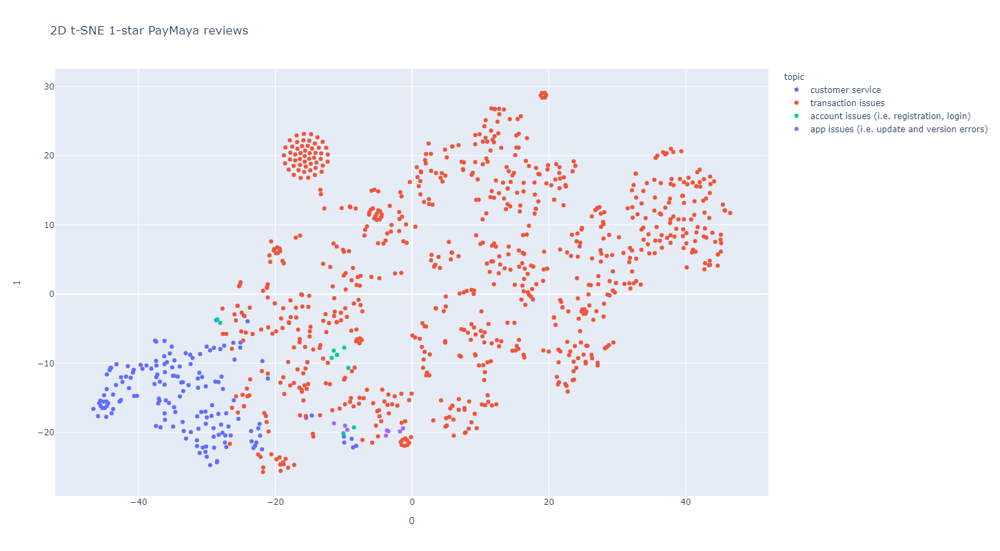

In [18]:
import matplotlib.colors as mcolors
from sklearn.manifold import TSNE
from itertools import cycle
from umap.umap_ import UMAP

# Array of topic weights    
arr = pd.DataFrame(predictions).fillna(0).values

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

topic_lst = set(topic_num)
new_topics = []

for i in topic_lst:
    new_topics.append(topics[i])

# Topic colors
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])

tsne_model = TSNE(n_components=2, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter(
    projections, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='2D t-SNE 1-star PayMaya reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_layout(width=1450, height=800)
fig.show()

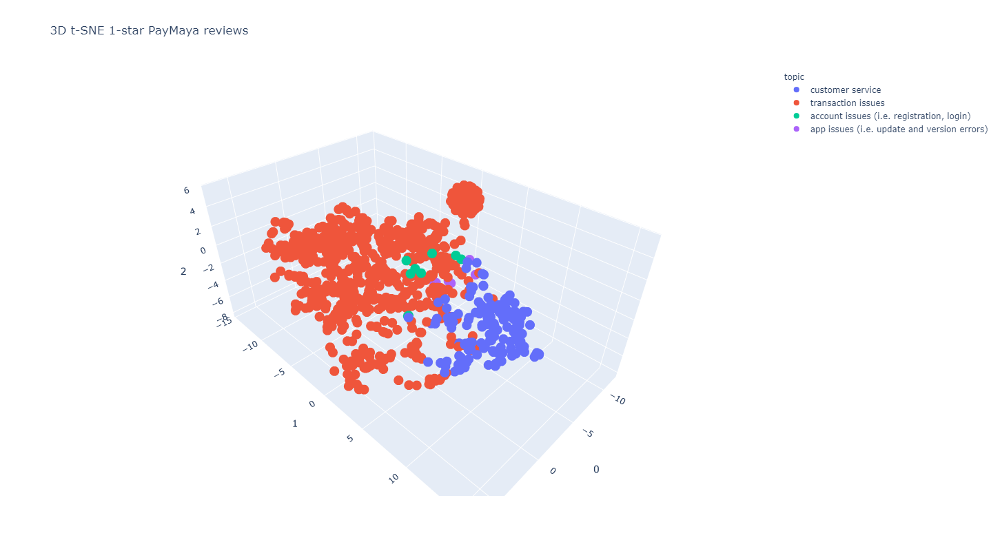

In [22]:
tsne_model = TSNE(n_components=3, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='3D t-SNE 1-star PayMaya reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_traces(marker_size=8)
fig.update_layout(width=1450, height=800)
fig.show()

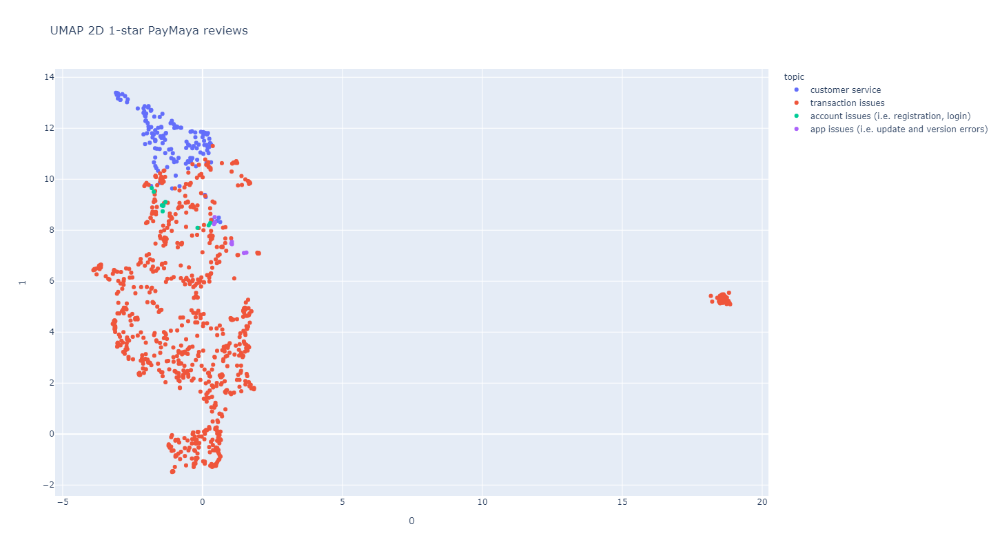

In [23]:
umap_2d = UMAP(n_components=2, random_state=0)
umap_3d = UMAP(n_components=3, random_state=0)

proj_2d = umap_2d.fit_transform(arr)
proj_3d = umap_3d.fit_transform(arr)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 2D 1-star PayMaya reviews'
)
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 3D 1-star PayMaya reviews'
)
fig_3d.update_traces(marker_size=5)

labels_2d = cycle(new_topics)
labels_3d = cycle(new_topics)

fig_2d.for_each_trace(lambda t:  t.update(name = next(labels_2d)))
fig_3d.for_each_trace(lambda t:  t.update(name = next(labels_3d)))
fig_2d.update_layout(width=1450, height=800)
fig_2d.show()

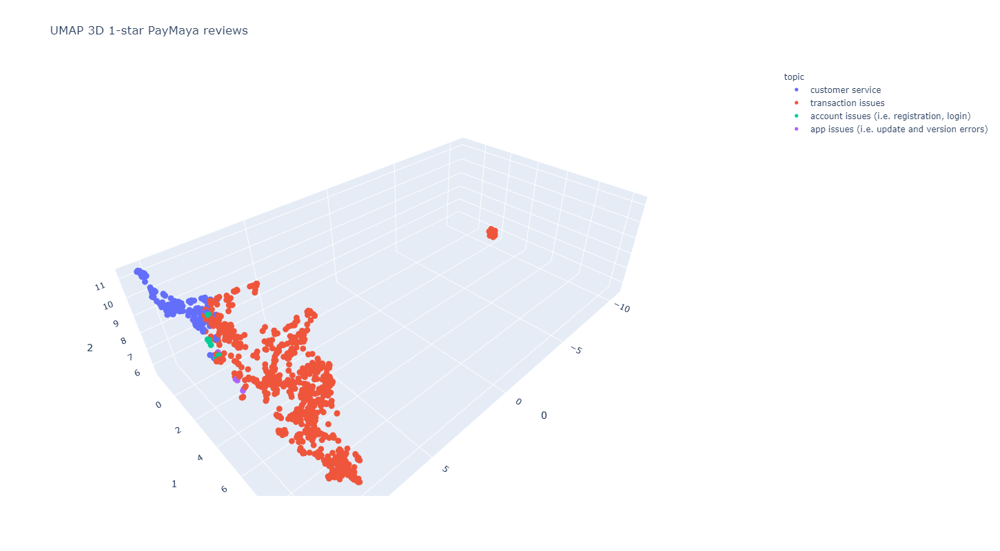

In [24]:
fig_3d.update_layout(width=1450, height=800)
fig_3d.show()

In [55]:
count = 10

print(f'\noriginal text:')
for i in range(count):
    print(f'\n{[i]} - {test_data.review.values.tolist()[i]}')


original text:

[0] - Very disappointing customer service. It seems that there was an update that additional information was needed to be provided. Right now, I no longer have acces to my account and customer service is not willing to help reactivate my account. A lot of information being asked which is inside the app in which I no longer able to open. Fix your people and fix my account.

[1] - Why it wont let me register??

[2] - transactions failed a lot and they take your money and it takes 45 days to get it back

[3] - Your transaction fee sucks. Might cancel my account with you. You're like the money sucking BPI

[4] - apps work but very difficult to add money. registered twice for upgrade so i can reload money direct from my bank but rejected twice. not worth it.

[5] - Cant upgrade my account, after filling up forms and uploading photos it always sens me a message "We are unable to validate your identity"....tried many times, turned on the lights in my room same thing happens



In [56]:
test_counts = pd.DataFrame(
    test_vectors[:count],
    columns=vocab_list
)

print(display(test_counts))

,2019,2020,able,accept,accepted,access,account,action,actually,address,agent,akong,alam,allow,amount,annoy,answer,anyone,appear,application,apply,approve,apps,april,araw,asap,ask,assistance,attempt,automate,avail,available,away,ayaw,ayos,ayusin,bad,bagal,balance,bank,banking,bayad,become,beep,best,bill,blah,block,bother,bought,bring,bulok,business,button,buying,call,card,care,case,cash,cashback,cause,center,change,charge,chat,check,checked,choice,claim,clear,clearance,click,close,code,coinsph,company,complain,complaint,complete,concern,confirmation,connect,connection,consider,contact,contribution,convenience,convenient,correct,costumer,couple,crash,create,credit,customer,dam,dami,damn,data,date,dati,deactivate,debit,decide,decline,deduct,delete,deny,deposit,despite,detail,developer,device,different,difficult,disappoint,disappointed,document,double,download,driver,dumating,duplicate,easily,easy,edit,either,else,email,encounter,enough,enter,error,ever,expect,experience,experienced,expire,explain,facebook,fact,fail,fake,fast,feature,fee,feedback,feel,file,fill,fine,fix,follow,force,forever,forgot,form,free,friend,friendly,frustrate,full,fund,game,gamit,ganun,garena,good,government,grabe,great,guess,hack,halo,happens,happy,hard,hassle,hate,havent,hell,help,helpful,hirap,hndi,hold,horrible,hotline,hour,ibang,identity,ignore,ilang,immediately,improve,include,inconvenient,info,information,instal,install,instead,instruction,internet,invalid,invite,inyo,issue,july,kasi,kaso,kept,kind,kindly,kwenta,lag,lagi,lalo,laman,late,later,least,license,limit,limited,load,lock,log,login,longer,look,lose,love,maayos,magamit,maganda,maka,makapag,makuha,march,mastercard,match,matter,maya,mean,measure,meralco,meron,messenger,minute,miss,mobile,money,multiple,naka,nakaka,nakakainis,nako,nalang,name,nato,nawala,negative,netflix,network,ngaun,nice,ninyo,nlng,nman,none,notice,notification,number,nung,offer,online,option,order,others,padala,page,paid,paki,pakiayos,pala,pandemic,pang,panget,pangit,pano,parin,passport,password,pati,pay,paymaya,paymayacares,payment,paypal,pending,people,pera,person,personal,peso,philhealth,photo,picture,pin,place,platform,poor,possible,post,previous,primary,problem,problema,proceed,process,processing,promise,promo,promos,prompt,properly,provide,pumasok,purchase,puro,query,question,rate,rating,razer,reach,read,real,reason,rebate,receive,recently,recieve,recommend,record,recover,reference,referral,reflect,refund,regard,register,registration,regular,reinstall,reject,reliable,remain,remove,repeat,reply,report,representative,request,require,requirement,reset,resolution,resolve,respond,response,responsive,restart,restrict,result,retrieve,return,review,reward,right,sakin,save,sayang,scam,scammed,scammer,school,second,secondary,security,send,sent,seriously,server,service,several,shell,shop,sign,signal,simple,slow,smart,sobrang,solution,solve,someone,sorry,stable,state,status,steal,steam,stop,store,stuck,student,stuff,stupid,submit,successful,successfully,suck,suddenly,suggest,super,support,sure,switch,system,tagal,talaga,talk,tama,tell,terrible,text,thanks,thought,three,ticket,till,time,told,tong,total,totally,transaction,transfer,trash,trouble,trust,tuloy,tumawag,turn,twice,type,ulit,unable,unauthorized,understand,unfortunately,uninstall,uninstalled,uninstalling,union,unless,unlike,unresponsive,update,upgrade,upgraded,upon,useful,useless,user,valid,verification,verify,version,video,view,virtual,visa,voter,voucher,wait,wallet,waste,week,wifi,withdraw,within,work,worth,yesterday,yong,zero
0,0.0,0.0,0.213474,0.000000,0.0,0.0,0.287027,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.210546,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.260455,0.0,0.0,0.0,0.0,0.0,0.0

None


Text(0.5, 0, 'Topic ID')

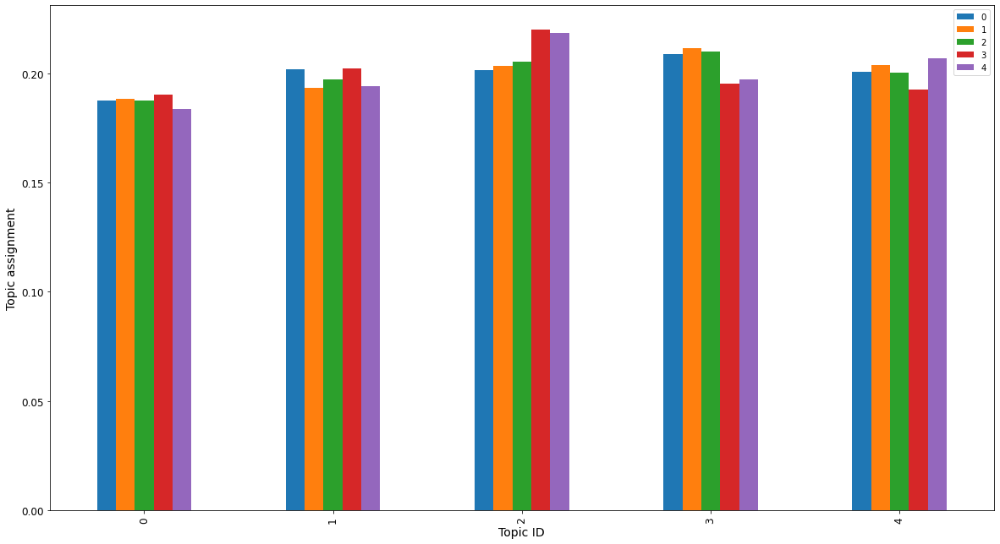

In [63]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

fs = 12
df=pd.DataFrame(predictions[:5].T)
df.plot(kind='bar', figsize=(20, 11), fontsize=fs)
plt.ylabel('Topic assignment', fontsize=fs+2)
plt.xlabel('Topic ID', fontsize=fs+2)

## Delete endpoint after performing inferences
---

In [ ]:
sagemaker.Session().delete_endpoint(ntm_predictor.endpoint_name)

## Load model artifacts stored in output directory
---

In [65]:
model_path = os.path.join(output_prefix, 'ntm-2021-07-01-08-16-47-873', "output/model.tar.gz")
model_path

'sagemaker/regalado/output/ntm-2021-07-01-08-16-47-873/output/model.tar.gz'

In [66]:
boto3.resource("s3").Bucket(bucket).download_file(model_path, "downloaded_model.tar.gz")

In [67]:
!pwd

/home/ec2-user/SageMaker/my-experiments


In [68]:
tarfile.open('downloaded_model.tar.gz').extractall()

with zipfile.ZipFile('model_algo-1', 'r') as zip_ref:
    zip_ref.extractall('./')
    
model = mx.ndarray.load("params")
W = model["arg:projection_weight"]

## Model exploration
---

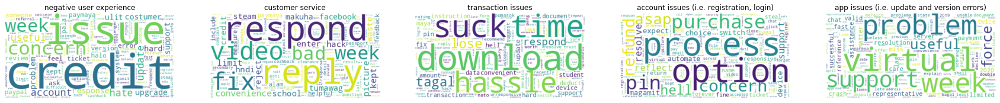

In [71]:
word_to_id = dict()

for i, v in enumerate(vocab_list):
    word_to_id[v] = i

limit = 30
n_col = 5
counter = 0

plt.figure(figsize=(30, 20))

for ind in range(num_topics):

    if counter >= limit:
        break
        
    title_str = topics[ind]
    pvals = mx.nd.softmax(mx.nd.array(W[:, ind])).asnumpy()
    word_freq = dict()
    
    for k in word_to_id.keys():
        i = word_to_id[k]
        word_freq[k] = pvals[i]

    wordcloud = wc.WordCloud(background_color="white").fit_words(word_freq)

    plt.subplot(limit // n_col, n_col, counter + 1)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(title_str)

    counter += 1

## 5-star model
---

In [334]:
sesh = sagemaker.Session()

ntm = sagemaker.estimator.Estimator(
    container,
    role, 
    instance_count=1, 
    instance_type='ml.m4.xlarge', # Free-tier instance (Free Tier usage per month for the first 2 months) ~ https://aws.amazon.com/sagemaker/pricing/
    output_path=output_path,
    sagemaker_session=sesh
)

# Best config ~ ~ ~ ~ ~ ~ 
# tanh	0.000568	725.0	adadelta	0.331837	0.336371

num_topics = 2

ntm.set_hyperparameters(
    num_topics=num_topics, 
    feature_dim=vocab_size, 
    num_patience_epochs=5,
#     tolerance=0.0001,
    epochs=200, 
    batch_norm=True,
    sub_sample=0.2,
    encoder_layers_activation='sigmoid',
    learning_rate=0.000568,
    mini_batch_size=725,
    optimizer='adam',
    rescale_gradient=0.331837,
    weight_decay=0.336371
)

In [335]:
print(f'vocab size = {vocab_size}')
print(f'topic count = {num_topics}')
# print(f'\nplatform: {main_df.type.values[0]}\nrating: {main_df.rating.values[0]}')

vocab size = 2000
topic count = 2


In [336]:
# WETC - The word embedding topic coherence metric measures the similarity of words in a topic by using a pre-trained word embedding, Glove-6B-400K-50d.
# TU - The topic unicity tells us how unique the word groups per topic are used overall (i.e. Are these meaningful words?)
# Note: A high (closer to 1) TU represents a high topic uniqueness for the topics detected.
# A high WETC value indicates a higher degree of topic coherence. A typical value would be in the range of 0.2 to 0.8

ntm.fit(inputs={"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path})

2021-07-01 15:04:53,601 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-01 15:04:53,968 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-01 15:04:53,970 | INFO | session.py:570 | train | Creating training-job with name: ntm-2021-07-01-15-04-53-600


2021-07-01 15:04:54 Starting - Starting the training job...
2021-07-01 15:05:17 Starting - Launching requested ML instancesProfilerReport-1625151893: InProgress
......
2021-07-01 15:06:17 Starting - Preparing the instances for training.........
2021-07-01 15:07:47 Downloading - Downloading input data
2021-07-01 15:07:47 Training - Downloading the training image.....Docker entrypoint called with argument(s): train
Running default environment configuration script
/opt/amazon/lib/python3.7/site-packages/jsonref.py:8: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping, MutableMapping, Sequence
[07/01/2021 15:08:32 INFO 140151873095488] Reading default configuration from /opt/amazon/lib/python3.7/site-packages/algorithm/default-input.json: {'encoder_layers': 'auto', 'mini_batch_size': '256', 'epochs': '50', 'encoder_layers_activation': 'sigmoid',

In [208]:
# WETC - The word embedding topic coherence metric measures the similarity of words in a topic by using a pre-trained word embedding, Glove-6B-400K-50d.
# TU - The topic unicity tells us how unique the word groups per topic are used overall (i.e. Are these meaningful words?)
# Note: A high (closer to 1) TU represents a high topic uniqueness for the topics detected.
# A high WETC value indicates a higher degree of topic coherence. A typical value would be in the range of 0.2 to 0.8

ntm.fit(inputs={"train": s3_train, "validation": s3_valid, "auxiliary": s3_aux_path})

2021-07-01 13:57:06,871 | INFO | image_uris.py:198 | _validate_version_and_set_if_needed | Defaulting to the only supported framework/algorithm version: latest.
2021-07-01 13:57:06,882 | INFO | image_uris.py:224 | _processor | Ignoring unnecessary instance type: None.
2021-07-01 13:57:06,883 | INFO | session.py:570 | train | Creating training-job with name: ntm-2021-07-01-13-57-06-870


2021-07-01 13:57:07 Starting - Starting the training job...
2021-07-01 13:57:30 Starting - Launching requested ML instancesProfilerReport-1625147826: InProgress
......
2021-07-01 13:58:30 Starting - Preparing the instances for training.........
2021-07-01 13:59:57 Downloading - Downloading input data
2021-07-01 13:59:57 Training - Downloading the training image.....Docker entrypoint called with argument(s): train
Running default environment configuration script
/opt/amazon/lib/python3.7/site-packages/jsonref.py:8: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping, MutableMapping, Sequence
[07/01/2021 14:00:48 INFO 140657496962880] Reading default configuration from /opt/amazon/lib/python3.7/site-packages/algorithm/default-input.json: {'encoder_layers': 'auto', 'mini_batch_size': '256', 'epochs': '50', 'encoder_layers_activation': 'sigmoid',

## Deploy endpoint
---

In [337]:
ntm_predictor = ntm.deploy(initial_instance_count=1, instance_type='ml.m4.xlarge', wait=False)

2021-07-01 15:13:32,087 | INFO | session.py:2552 | create_model | Creating model with name: ntm-2021-07-01-15-13-32-017
2021-07-01 15:13:32,820 | INFO | session.py:2973 | create_endpoint | Creating endpoint with name ntm-2021-07-01-15-13-32-017


## Perform sample inferences
---

In [338]:
test_vectors.shape

(6384, 2000)

In [347]:
from sagemaker.serializers import CSVSerializer
from sagemaker.deserializers import JSONDeserializer

count = 700

# 5-star 
topics = ['positive user experience', 'positive user experience']

predictor = sagemaker.predictor.Predictor(
    endpoint_name=ntm_predictor.endpoint_name, 
    sagemaker_session=sesh, 
    serializer=CSVSerializer(), 
    deserializer=JSONDeserializer()
)

# predictor.update_endpoint()

results = predictor.predict(train_vectors[:count])
print(f'Raw prediction/s:\n{results}')

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])
print(f'\nPredicted topic weights:\n{predictions}\n\nSorted topic assignment scores per input document:')

for i in results['predictions']:
    sorted_indexes = np.argsort(i['topic_weights']).tolist()
    sorted_indexes.reverse()
    top_topics = [topics[j] for j in sorted_indexes]
    top_weights = [i['topic_weights'][j] for j in sorted_indexes]
    pairs = list(zip(top_topics, top_weights))
    print(pairs)

Raw prediction/s:
{'predictions': [{'topic_weights': [0.499024272, 0.500975728]}, {'topic_weights': [0.4993477464, 0.500652194]}, {'topic_weights': [0.4995940924, 0.5004059672]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4996664524, 0.5003336072]}, {'topic_weights': [0.4986335933, 0.5013663769]}, {'topic_weights': [0.4994091392, 0.5005908608]}, {'topic_weights': [0.4993909299, 0.5006090403]}, {'topic_weights': [0.4990449548, 0.5009550452]}, {'topic_weights': [0.5003742576, 0.4996257722]}, {'topic_weights': [0.4990538657, 0.5009461045]}, {'topic_weights': [0.4994956255, 0.5005044341]}, {'topic_weights': [0.499063313, 0.5009366274]}, {'topic_weights': [0.4995676279, 0.5004323721]}, {'topic_weights': [0.4993422627, 0.5006577373]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4998843074, 0.5001156926]}, {'topic_weights': [0.4986510575, 0.5013489127]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4991345704, 0.50086

In [25]:
results = {'predictions': [{'topic_weights': [0.499024272, 0.500975728]}, {'topic_weights': [0.4993477464, 0.500652194]}, {'topic_weights': [0.4995940924, 0.5004059672]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4996664524, 0.5003336072]}, {'topic_weights': [0.4986335933, 0.5013663769]}, {'topic_weights': [0.4994091392, 0.5005908608]}, {'topic_weights': [0.4993909299, 0.5006090403]}, {'topic_weights': [0.4990449548, 0.5009550452]}, {'topic_weights': [0.5003742576, 0.4996257722]}, {'topic_weights': [0.4990538657, 0.5009461045]}, {'topic_weights': [0.4994956255, 0.5005044341]}, {'topic_weights': [0.499063313, 0.5009366274]}, {'topic_weights': [0.4995676279, 0.5004323721]}, {'topic_weights': [0.4993422627, 0.5006577373]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4998843074, 0.5001156926]}, {'topic_weights': [0.4986510575, 0.5013489127]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4991345704, 0.5008654594]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4983474612, 0.5016525388]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4993760288, 0.5006239414]}, {'topic_weights': [0.5040057302, 0.4959942997]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4993481934, 0.5006517768]}, {'topic_weights': [0.4993025064, 0.5006974339]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4997214377, 0.5002785921]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5001907349, 0.4998092949]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4991254807, 0.5008745193]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.499296248, 0.500703752]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994127452, 0.5005872846]}, {'topic_weights': [0.4993129075, 0.5006871223]}, {'topic_weights': [0.5040057302, 0.4959942997]}, {'topic_weights': [0.4994984269, 0.5005015135]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.4992171824, 0.5007828474]}, {'topic_weights': [0.4993161559, 0.5006838441]}, {'topic_weights': [0.4992488325, 0.5007511973]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4995056987, 0.5004943013]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4994519651, 0.5005480051]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.49981004, 0.50018996]}, {'topic_weights': [0.5001318455, 0.4998681545]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4991967082, 0.5008033514]}, {'topic_weights': [0.4990350902, 0.50096488]}, {'topic_weights': [0.500942111, 0.4990579188]}, {'topic_weights': [0.4990186989, 0.5009813309]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5001238585, 0.4998761415]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4994935393, 0.5005064607]}, {'topic_weights': [0.5012689233, 0.4987310469]}, {'topic_weights': [0.4991125762, 0.500887394]}, {'topic_weights': [0.4989440739, 0.5010558963]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4991950095, 0.5008050203]}, {'topic_weights': [0.4991923571, 0.5008076429]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5003139973, 0.4996860027]}, {'topic_weights': [0.4995447993, 0.5004552007]}, {'topic_weights': [0.4996420741, 0.5003578663]}, {'topic_weights': [0.4993923903, 0.5006076097]}, {'topic_weights': [0.499238193, 0.5007617474]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4989188313, 0.5010811687]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994127452, 0.5005872846]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.499406904, 0.5005930662]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5010913014, 0.4989086688]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4991563857, 0.5008435845]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4992554784, 0.5007445216]}, {'topic_weights': [0.4990431666, 0.5009568334]}, {'topic_weights': [0.4992078841, 0.5007921457]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994127452, 0.5005872846]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4987162054, 0.5012838244]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4997677207, 0.5002322793]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5009125471, 0.4990874827]}, {'topic_weights': [0.4994416535, 0.5005583167]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4987034798, 0.5012964606]}, {'topic_weights': [0.4993638396, 0.50063622]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5012485385, 0.4987514913]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5001243353, 0.4998756647]}, {'topic_weights': [0.498978883, 0.5010210872]}, {'topic_weights': [0.4998341203, 0.5001658797]}, {'topic_weights': [0.4996789098, 0.5003210306]}, {'topic_weights': [0.4991729558, 0.5008270144]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994059503, 0.5005940795]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5004491806, 0.4995507896]}, {'topic_weights': [0.4994425774, 0.5005574226]}, {'topic_weights': [0.4992820024, 0.5007179976]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4992349744, 0.5007650852]}, {'topic_weights': [0.4997581542, 0.5002418756]}, {'topic_weights': [0.4992127419, 0.5007872581]}, {'topic_weights': [0.4995113909, 0.5004885793]}, {'topic_weights': [0.4989586771, 0.5010412931]}, {'topic_weights': [0.4991676509, 0.5008323789]}, {'topic_weights': [0.4995067716, 0.5004932284]}, {'topic_weights': [0.499242425, 0.500757575]}, {'topic_weights': [0.4981096387, 0.5018903017]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5006639957, 0.4993359745]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.4993051291, 0.5006948709]}, {'topic_weights': [0.4990978837, 0.5009021163]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.4991396368, 0.5008603334]}, {'topic_weights': [0.5007589459, 0.4992410541]}, {'topic_weights': [0.5020275116, 0.4979724884]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.49961254, 0.5003874898]}, {'topic_weights': [0.4995583594, 0.5004416704]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.5000524521, 0.4999475777]}, {'topic_weights': [0.500492394, 0.4995076358]}, {'topic_weights': [0.4992672801, 0.5007327199]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4994082451, 0.5005917549]}, {'topic_weights': [0.5004937053, 0.4995062649]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4988313913, 0.5011686087]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.4991580546, 0.5008419752]}, {'topic_weights': [0.4996409714, 0.5003589988]}, {'topic_weights': [0.4992584884, 0.5007414818]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4995640516, 0.5004359484]}, {'topic_weights': [0.4993942082, 0.500605762]}, {'topic_weights': [0.5006924868, 0.4993074834]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4995216429, 0.5004783869]}, {'topic_weights': [0.5017204285, 0.4982795417]}, {'topic_weights': [0.5001711249, 0.4998288453]}, {'topic_weights': [0.4992645085, 0.5007354617]}, {'topic_weights': [0.4988401532, 0.5011598468]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4995265603, 0.5004734993]}, {'topic_weights': [0.5001055002, 0.4998944402]}, {'topic_weights': [0.5012494326, 0.4987505078]}, {'topic_weights': [0.4993204474, 0.5006795526]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994984269, 0.5005015135]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4992190003, 0.5007809401]}, {'topic_weights': [0.4998060465, 0.5001938939]}, {'topic_weights': [0.5001862645, 0.4998137355]}, {'topic_weights': [0.4996082485, 0.5003917813]}, {'topic_weights': [0.5016186237, 0.4983813763]}, {'topic_weights': [0.4993562996, 0.5006437302]}, {'topic_weights': [0.4992066324, 0.5007933974]}, {'topic_weights': [0.4992535412, 0.5007464886]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4989646971, 0.5010352731]}, {'topic_weights': [0.4995737374, 0.5004262924]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': \
[0.4998843074, 0.5001156926]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4994108081, 0.5005892515]}, {'topic_weights': [0.4989866018, 0.5010133982]}, {'topic_weights': [0.4992343187, 0.5007656813]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4996740818, 0.5003259778]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.5006736517, 0.4993263483]}, {'topic_weights': [0.4994672835, 0.5005327463]}, {'topic_weights': [0.4995723963, 0.5004276037]}, {'topic_weights': [0.5003429651, 0.4996570349]}, {'topic_weights': [0.4993423223, 0.5006576777]}, {'topic_weights': [0.5006839037, 0.4993160963]}, {'topic_weights': [0.4993113577, 0.5006886721]}, {'topic_weights': [0.4997411966, 0.5002588034]}, {'topic_weights': [0.4995925426, 0.500407517]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.4993842244, 0.5006157756]}, {'topic_weights': [0.4999307096, 0.5000693202]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4996983111, 0.5003017187]}, {'topic_weights': [0.4998816848, 0.5001183152]}, {'topic_weights': [0.49880898, 0.50119102]}, {'topic_weights': [0.4991770983, 0.5008229017]}, {'topic_weights': [0.4999468625, 0.5000531673]}, {'topic_weights': [0.501122117, 0.4988778532]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4994946718, 0.5005053282]}, {'topic_weights': [0.5004245639, 0.4995754063]}, {'topic_weights': [0.4997879565, 0.5002120733]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5004324913, 0.4995674789]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.4993438721, 0.5006560683]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4998137057, 0.5001863241]}, {'topic_weights': [0.4991345704, 0.5008654594]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5006736517, 0.4993263483]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4996594191, 0.5003405809]}, {'topic_weights': [0.4995128214, 0.5004872084]}, {'topic_weights': [0.4992407262, 0.500759244]}, {'topic_weights': [0.4994618297, 0.5005381703]}, {'topic_weights': [0.499217093, 0.5007829666]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.499040693, 0.5009592772]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.4990810752, 0.5009189248]}, {'topic_weights': [0.4991947412, 0.5008052588]}, {'topic_weights': [0.4995859563, 0.5004140735]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4989575744, 0.501042366]}, {'topic_weights': [0.4997289181, 0.5002710819]}, {'topic_weights': [0.499445796, 0.500554204]}, {'topic_weights': [0.499120295, 0.500879705]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4991409779, 0.5008590817]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.5003840923, 0.4996159375]}, {'topic_weights': [0.4994138479, 0.5005861521]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4994547069, 0.5005452633]}, {'topic_weights': [0.4988123477, 0.5011876225]}, {'topic_weights': [0.4991269112, 0.5008731484]}, {'topic_weights': [0.4992988706, 0.5007010698]}, {'topic_weights': [0.5002062917, 0.4997937083]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4990562797, 0.5009437203]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4996605814, 0.5003394485]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.498875767, 0.5011242032]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4987630546, 0.5012369752]}, {'topic_weights': [0.4988626838, 0.5011372566]}, {'topic_weights': [0.4994653463, 0.5005346537]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4997716248, 0.500228405]}, {'topic_weights': [0.4992484152, 0.500751555]}, {'topic_weights': [0.4996649921, 0.5003350377]}, {'topic_weights': [0.4992097914, 0.5007902384]}, {'topic_weights': [0.5001593828, 0.4998405874]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.4981290102, 0.5018709898]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4990906417, 0.5009093881]}, {'topic_weights': [0.4987953901, 0.5012046099]}, {'topic_weights': [0.4991892278, 0.5008107424]}, {'topic_weights': [0.5001894236, 0.4998106062]}, {'topic_weights': [0.4996029139, 0.5003970861]}, {'topic_weights': [0.5000033379, 0.4999966323]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4999981821, 0.5000018477]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4997891188, 0.5002108216]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.4987273514, 0.5012726784]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5000481009, 0.4999518692]}, {'topic_weights': [0.4979048967, 0.5020951629]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.5019248724, 0.4980751276]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4996056855, 0.5003943443]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4991666079, 0.5008333325]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4996983111, 0.5003017187]}, {'topic_weights': [0.5009518862, 0.499048084]}, {'topic_weights': [0.4991385937, 0.5008614063]}, {'topic_weights': [0.4993709922, 0.5006290078]}, {'topic_weights': [0.5011174083, 0.4988825619]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.499235034, 0.5007650256]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.5002115965, 0.4997884333]}, {'topic_weights': [0.4992364049, 0.5007635951]}, {'topic_weights': [0.4996366799, 0.5003632903]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4995308518, 0.5004690886]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5010106564, 0.4989893734]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4990631938, 0.5009368062]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4991609454, 0.5008391142]}, {'topic_weights': [0.501069665, 0.4989303052]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5000582337, 0.4999417961]}, {'topic_weights': [0.4994560182, 0.500543952]}, {'topic_weights': [0.5010106564, 0.4989893734]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.5001318455, 0.4998681545]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4991964102, 0.5008036494]}, {'topic_weights': [0.4992458522, 0.500754118]}, {'topic_weights': [0.5024712682, 0.4975287318]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.499199748, 0.500800252]}, {'topic_weights': [0.4995783865, 0.5004216433]}, {'topic_weights': [0.499699682, 0.5003003478]}, {'topic_weights': [0.5016186237, 0.4983813763]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4996012449, 0.5003986955]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.4994500577, 0.5005499125]}, {'topic_weights': [0.5001881719, 0.4998117983]}, {'topic_weights': [0.4991351962, 0.5008648038]}, {'topic_weights': [0.4999665618, 0.5000334382]}, {'topic_weights': [0.4995644093, 0.5004355907]}, {'topic_weights': [0.5006756783, 0.4993242919]}, {'topic_weights': [0.5006064773, 0.4993935227]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4993624687, 0.5006375313]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4994091392, 0.5005908608]}, {'topic_weights': [0.4997249246, 0.500275135]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4995421767, 0.5004578233]}, {'topic_weights': [0.4987178147, 0.5012821555]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4993943572, 0.5006056428]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5000530481, 0.4999469817]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4999659657, 0.5000340343]}, {'topic_weights': [0.498962909, 0.5010371208]}, {'topic_weights': [0.499843955, 0.500156045]}, {'topic_weights': [0.5008656383, 0.4991343617]}, {'topic_weights': [0.4994645715, 0.5005354285]}, {'topic_weights': [0.4993149042, 0.5006851554]}, {'topic_weights': [0.4991950095, 0.5008050203]}, {'topic_weights': [0.499894172, 0.5001057982]}, {'topic_weights': [0.4996401072, \
0.5003598928]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.499743551, 0.5002564192]}, {'topic_weights': [0.4992417991, 0.5007581711]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.499561429, 0.500438571]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4995590746, 0.5004409552]}, {'topic_weights': [0.4995686114, 0.5004313588]}, {'topic_weights': [0.4990216494, 0.5009783506]}, {'topic_weights': [0.4994806647, 0.5005193353]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994089007, 0.5005910993]}, {'topic_weights': [0.4999026358, 0.5000973344]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4998786151, 0.5001213551]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.5006736517, 0.4993263483]}, {'topic_weights': [0.4996862113, 0.5003137589]}, {'topic_weights': [0.499537468, 0.500462532]}, {'topic_weights': [0.4995715916, 0.5004284382]}, {'topic_weights': [0.4991280437, 0.5008719563]}, {'topic_weights': [0.4992726445, 0.5007273555]}, {'topic_weights': [0.4990552366, 0.5009447336]}, {'topic_weights': [0.4989336431, 0.5010663867]}, {'topic_weights': [0.4993620515, 0.5006379485]}, {'topic_weights': [0.5040057302, 0.4959942997]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4996481538, 0.5003518462]}, {'topic_weights': [0.4994652271, 0.5005347729]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.4995673299, 0.5004326105]}, {'topic_weights': [0.4994673431, 0.5005326867]}, {'topic_weights': [0.4992112517, 0.5007887483]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.4992736578, 0.5007264018]}, {'topic_weights': [0.4991341531, 0.5008658767]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4993315935, 0.5006684065]}, {'topic_weights': [0.5020321012, 0.497967869]}, {'topic_weights': [0.5016186237, 0.4983813763]}, {'topic_weights': [0.499298811, 0.500701189]}, {'topic_weights': [0.4991340637, 0.5008659363]}, {'topic_weights': [0.4993780553, 0.5006219745]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.4998522699, 0.5001477599]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4985930622, 0.5014069676]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.4988722503, 0.5011277795]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.501395762, 0.498604238]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4987486005, 0.5012513399]}, {'topic_weights': [0.5008656383, 0.4991343617]}, {'topic_weights': [0.5024712682, 0.4975287318]}, {'topic_weights': [0.4994673431, 0.5005326867]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5013738275, 0.4986261725]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4990154505, 0.5009845495]}, {'topic_weights': [0.4996534884, 0.5003465414]}, {'topic_weights': [0.4995056987, 0.5004943013]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5033364296, 0.4966635406]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4996071756, 0.5003928542]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.5010106564, 0.4989893734]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4998843074, 0.5001156926]}, {'topic_weights': [0.4992153645, 0.5007846951]}, {'topic_weights': [0.5004552007, 0.4995447695]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.5002313256, 0.4997686744]}, {'topic_weights': [0.4995669723, 0.5004329681]}, {'topic_weights': [0.4995189011, 0.5004811287]}, {'topic_weights': [0.5001318455, 0.4998681545]}, {'topic_weights': [0.5006272197, 0.4993728101]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4990642667, 0.5009357333]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4992646277, 0.5007353425]}, {'topic_weights': [0.5017971396, 0.4982028306]}, {'topic_weights': [0.4994972944, 0.5005027056]}, {'topic_weights': [0.5010734797, 0.4989265203]}, {'topic_weights': [0.5017797351, 0.4982202947]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4993411303, 0.5006588697]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4987687171, 0.5012313128]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.4993750155, 0.5006250143]}, {'topic_weights': [0.4990975857, 0.5009024143]}, {'topic_weights': [0.4994023144, 0.5005976558]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4990647137, 0.5009352565]}, {'topic_weights': [0.4998237193, 0.5001762509]}, {'topic_weights': [0.4990704954, 0.5009294748]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4990854859, 0.5009145141]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.499083668, 0.5009163022]}, {'topic_weights': [0.4991593361, 0.5008407235]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4993933439, 0.5006065965]}, {'topic_weights': [0.4999518692, 0.5000481606]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4991391599, 0.5008608103]}, {'topic_weights': [0.4991548955, 0.5008451343]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.4991478324, 0.5008521676]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4993005991, 0.5006994009]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5006902814, 0.4993096888]}, {'topic_weights': [0.4993501306, 0.5006498694]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5013814569, 0.498618573]}, {'topic_weights': [0.4996412694, 0.5003587008]}, {'topic_weights': [0.4994636774, 0.5005363226]}, {'topic_weights': [0.49949947, 0.5005005002]}, {'topic_weights': [0.4988376796, 0.5011623502]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4991921484, 0.5008078814]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.4990198314, 0.5009801984]}, {'topic_weights': [0.4991973639, 0.5008026361]}, {'topic_weights': [0.4991340935, 0.5008659363]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.5004069209, 0.4995931089]}, {'topic_weights': [0.4992868602, 0.50071311]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5000062585, 0.4999937713]}, {'topic_weights': [0.4990676045, 0.5009323955]}, {'topic_weights': [0.4997397959, 0.5002601743]}, {'topic_weights': [0.5012810826, 0.4987189472]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4989156425, 0.5010843277]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4998024702, 0.5001975298]}, {'topic_weights': [0.5002654195, 0.4997345507]}, {'topic_weights': [0.4990371764, 0.5009628534]}, {'topic_weights': [0.4995682836, 0.5004317164]}, {'topic_weights': [0.4998714924, 0.5001285076]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5007404089, 0.4992595911]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.4997013509, 0.5002986193]}, {'topic_weights': [0.5016186237, 0.4983813763]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4994609952, 0.5005390048]}, {'topic_weights': [0.5006483197, 0.4993516803]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4985930622, 0.5014069676]}, {'topic_weights': [0.5004757047, 0.4995243549]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4998565912, 0.5001434088]}, {'topic_weights': [0.4992105067, 0.5007895231]}, {'topic_weights': [0.4985930622, 0.5014069676]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4991033971, 0.5008966327]}, {'topic_weights': [0.5016186237, 0.4983813763]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4995810688, 0.5004189014]}, {'topic_weights': [0.4984401762, 0.5015597939]}, {'topic_weights': [0.499890089, 0.500109911]}, \
{'topic_weights': [0.4996391833, 0.5003607869]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5001639128, 0.4998360574]}, {'topic_weights': [0.4987508357, 0.5012491941]}, {'topic_weights': [0.5003750324, 0.4996249676]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4989719391, 0.5010280013]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4993706942, 0.5006293058]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5027788877, 0.4972211123]}, {'topic_weights': [0.4991384447, 0.5008615851]}, {'topic_weights': [0.4975103438, 0.5024896264]}, {'topic_weights': [0.5001424551, 0.4998576045]}, {'topic_weights': [0.5017797351, 0.4982202947]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.5011612177, 0.4988387823]}, {'topic_weights': [0.5021817088, 0.4978182912]}, {'topic_weights': [0.4989899099, 0.5010100603]}, {'topic_weights': [0.4992071688, 0.500792861]}, {'topic_weights': [0.4994721413, 0.5005278587]}, {'topic_weights': [0.5000955462, 0.4999044538]}, {'topic_weights': [0.4989378154, 0.5010621548]}, {'topic_weights': [0.4994281828, 0.5005717874]}, {'topic_weights': [0.4993534982, 0.5006465316]}, {'topic_weights': [0.4990846515, 0.5009153485]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4992081821, 0.5007918477]}, {'topic_weights': [0.4995009303, 0.5004990101]}, {'topic_weights': [0.4993459582, 0.5006540418]}, {'topic_weights': [0.4993656874, 0.500634253]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5001045465, 0.4998954535]}, {'topic_weights': [0.4988912642, 0.5011087656]}, {'topic_weights': [0.4985930622, 0.5014069676]}, {'topic_weights': [0.5004494786, 0.4995505512]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5001062155, 0.4998937249]}, {'topic_weights': [0.4993645847, 0.5006354451]}, {'topic_weights': [0.499446094, 0.5005538464]}, {'topic_weights': [0.499748081, 0.5002519488]}, {'topic_weights': [0.4991178215, 0.5008821487]}, {'topic_weights': [0.5012554526, 0.4987445176]}, {'topic_weights': [0.5031472445, 0.4968527555]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5001318455, 0.4998681545]}, {'topic_weights': [0.4990622699, 0.5009377003]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.499414891, 0.5005850792]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.4992024601, 0.5007975101]}, {'topic_weights': [0.4991148114, 0.5008851886]}, {'topic_weights': [0.4996983111, 0.5003017187]}, {'topic_weights': [0.4997848272, 0.5002151728]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5010094047, 0.4989906251]}, {'topic_weights': [0.4992995858, 0.5007003546]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.5001769662, 0.4998230636]}, {'topic_weights': [0.4994984269, 0.5005015135]}, {'topic_weights': [0.501891315, 0.498108685]}, {'topic_weights': [0.5024712682, 0.4975287318]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4993622303, 0.5006377697]}, {'topic_weights': [0.5005011559, 0.4994988441]}, {'topic_weights': [0.4994601905, 0.5005398393]}, {'topic_weights': [0.4992994964, 0.5007004738]}, {'topic_weights': [0.4990289807, 0.5009710193]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.4996401072, 0.5003598928]}, {'topic_weights': [0.4990339279, 0.5009660721]}, {'topic_weights': [0.4976780415, 0.5023219585]}, {'topic_weights': [0.5021621585, 0.4978378117]}, {'topic_weights': [0.4991328418, 0.500867188]}, {'topic_weights': [0.4994175434, 0.5005824566]}, {'topic_weights': [0.4996645153, 0.5003354549]}, {'topic_weights': [0.4994999766, 0.5005000234]}, {'topic_weights': [0.4995132983, 0.5004866719]}, {'topic_weights': [0.501891315, 0.498108685]}]}

predictions = np.array([prediction['topic_weights'] for prediction in results['predictions']])

topics = ['positive user experience', 'positive user experience']

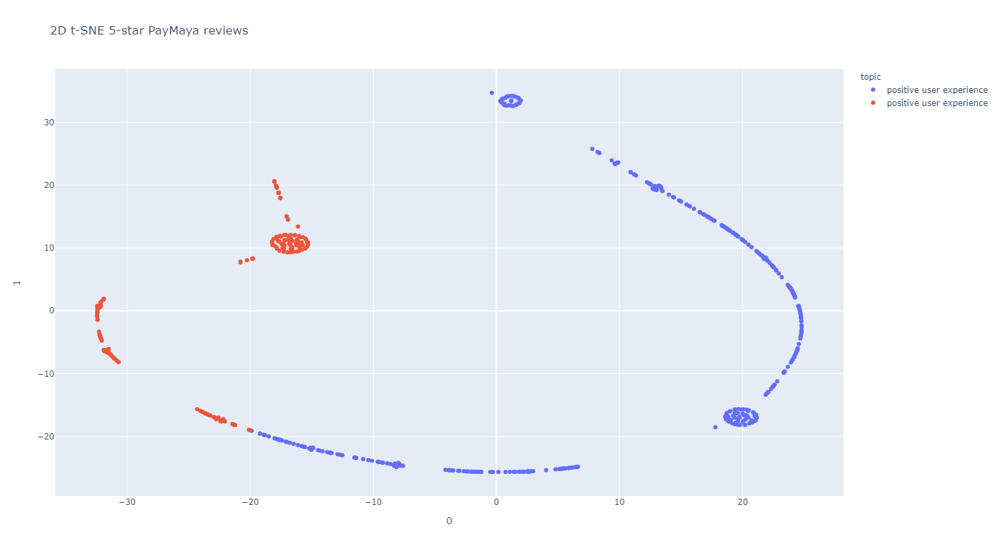

In [26]:
# Array of topic weights    
arr = pd.DataFrame(predictions).fillna(0).values

# Dominant topic number in each doc
topic_num = np.argmax(arr, axis=1)

topic_lst = set(topic_num)
new_topics = []

for i in topic_lst:
    new_topics.append(topics[i])

# Topic colors
mycolors = np.array([color for name, color in mcolors.TABLEAU_COLORS.items()])

tsne_model = TSNE(n_components=2, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter(
    projections, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='2D t-SNE 5-star PayMaya reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_layout(width=1450, height=800)
fig.show()

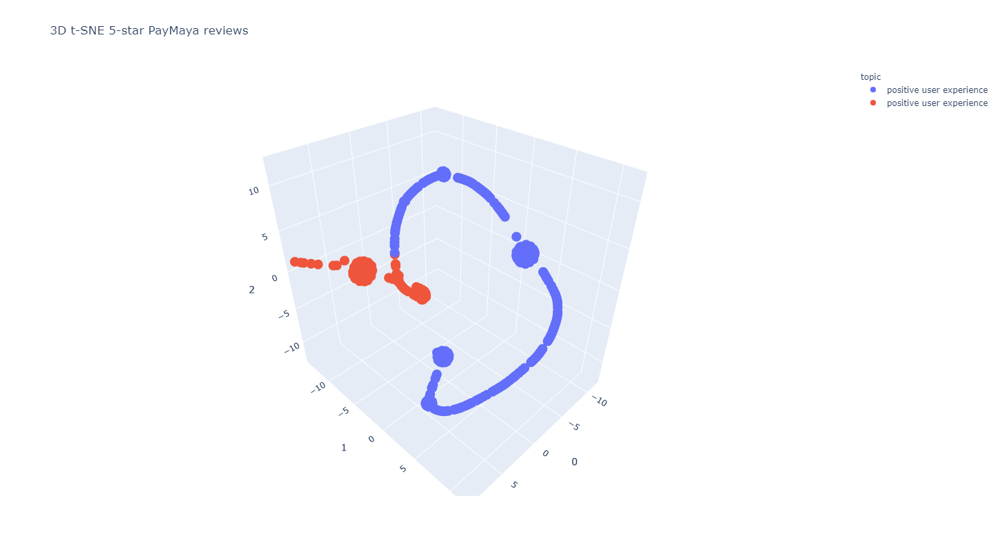

In [27]:
tsne_model = TSNE(n_components=3, random_state=0)
projections = tsne_model.fit_transform(arr)

fig = px.scatter_3d(
    projections, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='3D t-SNE 5-star PayMaya reviews'
)

labels = cycle(new_topics)

fig.for_each_trace(lambda t:  t.update(name = next(labels)))
fig.update_traces(marker_size=8)
fig.update_layout(width=1450, height=800)
fig.show()

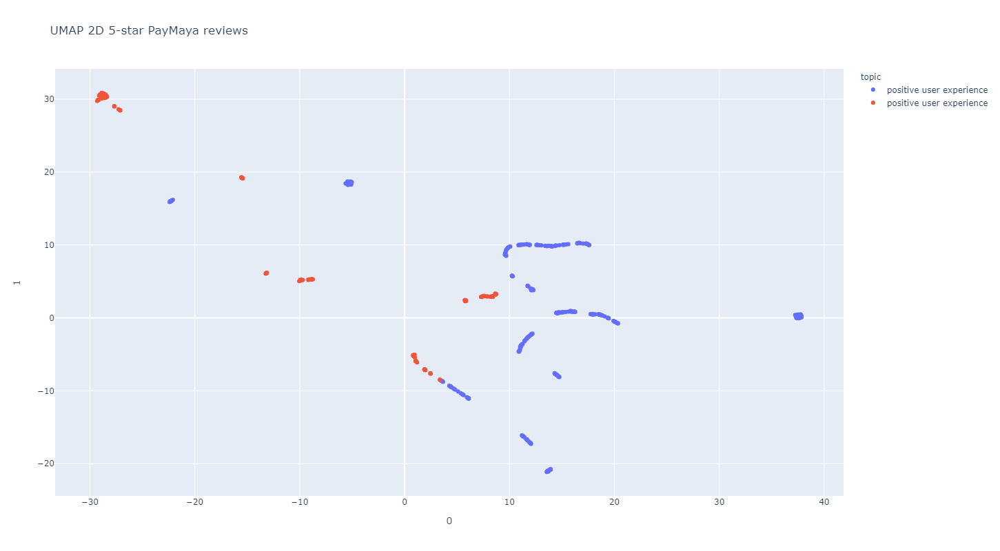

In [28]:
umap_2d = UMAP(n_components=2, random_state=0)
umap_3d = UMAP(n_components=3, random_state=0)

proj_2d = umap_2d.fit_transform(arr)
proj_3d = umap_3d.fit_transform(arr)

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 2D 5-star PayMaya reviews'
)
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=mycolors[topic_num], 
    labels={'color': 'topic'},
    title='UMAP 3D 5-star PayMaya reviews'
)
fig_3d.update_traces(marker_size=5)

labels_2d = cycle(new_topics)
labels_3d = cycle(new_topics)

fig_2d.for_each_trace(lambda t:  t.update(name = next(labels_2d)))
fig_3d.for_each_trace(lambda t:  t.update(name = next(labels_3d)))
fig_2d.update_layout(width=1450, height=800)
fig_2d.show()

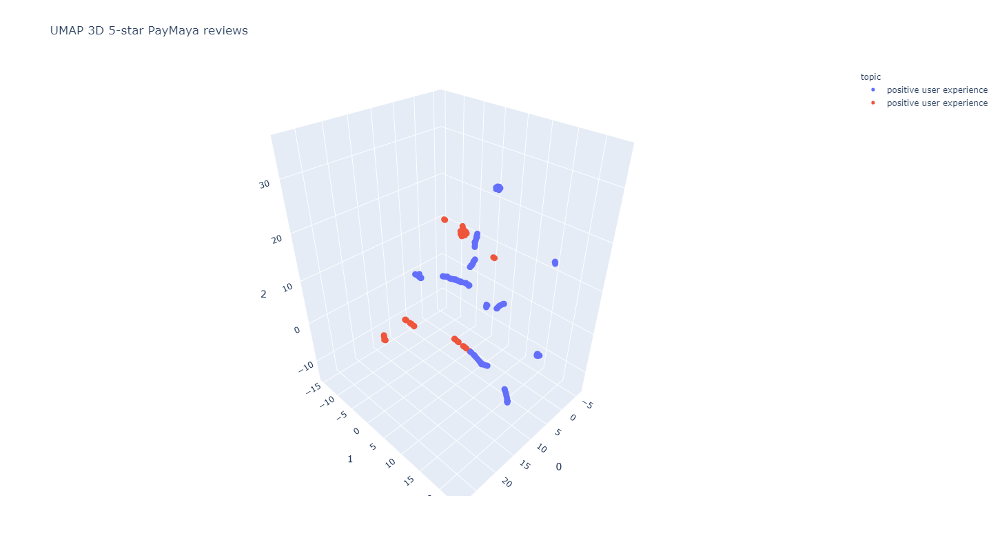

In [29]:
fig_3d.update_layout(width=1450, height=800)
fig_3d.show()

In [352]:
count = 10

print(f'\noriginal text:')
for i in range(count):
    print(f'\n{[i]} - {test_data.review.values.tolist()[i]}')


original text:

[0] - Accessible

[1] - I use this excellent app for paying almost anything! Not just for foods, groceries, and apparels but also for government taxes, and tuition fees of my younger siblings.

[2] - Great app :) Hopefully increase the limit

[3] - I love thos appps

[4] - Just started. I will check. For more

[5] - Reliability is critical when it comes to nutritional sales. When you validate, this system helps you to double-check all transaction history and other available information.

[6] - Useful❤️superb!!!

[7] - Bar code scanner for meralco is gone

[8] - Nice

[9] - My account verification is truly fast compare to other e-wallet apps. Hindi sila maarte in requirements yet super secured ng account. Walang ibang makakabukas ng account except the account holder dahil sa best security feature nito.


In [353]:
test_counts = pd.DataFrame(
    test_vectors[:count],
    columns=vocab_list
)

print(display(test_counts))

,1000,1010,1500,2018,2020,2021,5star,5stars,ability,able,abroad,absolutely,accept,acceptable,accepted,accesible,access,accessibility,accessible,accommodate,accomodating,accomplish,account,accumulate,accurate,achieve,acknowledge,acquire,across,act,action,activate,active,activity,actual,actually,adapt,addict,addition,additional,additionally,address,adjust,administration,admire,advance,advancement,advantage,advantageous,advise,affiliate,affordable,afraid,agadagad,age,agency,agent,agree,ahead,aim,akala,akong,alam,allot,allow,allowance,allows,alone,along,alot,alright,alternative,although,amaze,amazingly,amidst,among,amount,anak,andami,andaming,android,andyan,angas,anlaki,annoy,anong,answer,anybody,anyone,anytime,anyway,anywhere,apart,appeal,appear,appi,applicable,application,apply,appreciate,approach,approachable,appropriate,approve,apps,appvery,april,araw,area,around,arrange,arrangement,asap,aside,ask,aspect,asset,assist,assistance,association,assortment,assurance,assure,astig,astound,attain,attempt,automatic,automatically,avail,availability,available,avoid,aware,away,awesome,awsome,ayaw,ayos,ayun,babayad,babayaran,background,bad,bagal,bagay,bagong,bahay,baka,balance,balik,balikbayad,bangko,bank,banking,barcode,bargain,barya,base,basic,basically,basis,basta,bata,bawal,bawas,bayad,bayaran,bayarin,bayaring,bcoz,bearable,beat,beautiful,beauty,become,becomes,beep,begin,behind,believe,beneficial,benefit,besides,best,beyond,bibigyan,bibilhin,bibili,big,bigay,bigla,bigyan,bilhin,bili,bilis,bill,biller,billers,billing,binabayaran,binibigay,binibigyan,binibili,binili,bless,blessing,block,bonchon,bonus,book,boom,bother,bought,branch,brand,brilliant,bring,browse,budget,budgeting,buhay,built,bukas,bukod,bulsa,bumabalik,bumalik,bumibili,bumili,bunch,bundle,burden,business,busy,buti,button,buwan,buy,buyer,buying,cable,cafe,call,calm,capability,capable,capacity,card,...,straight,straightforward,strategy,strengthen,stress,stressful,strict,strong,structure,struggle,student,study,stuff,stun,style,submit,subok,subscription,substantial,success,successful,successfully,succession,suddenly,suggest,suggestion,suitable,sukli,sulit,super,superb,superior,supermarket,supplier,supply,support,sure,surely,surface,surprise,surprised,surprising,surprisingly,survive,swak,swear,sweet,swipe,switch,syang,syempre,synergy,system,tagal,takot,talaga,talagang,talk,talo,tama,tamang,taong,tap,tapon,task,tech,techie,technical,technique,technological,technology,techy,telco,tell,tend,tends,term,test,text,thankful,thanks,thankyou,therefore,thought,thoughtful,threat,three,throughout,thumb,thus,ticket,tier,tight,tignan,till,time,timely,timer,tindahan,tipid,tire,tiwala,together,told,tong,tool,topup,total,totally,totoo,touch,touchless,towards,trabaho,track,trade,traditional,transact,transaction,transactional,transfer,transition,transportation,trasactions,travel,treat,trip,trouble,troublesome,truly,trust,trustworthy,truth,tubig,tubo,tuition,tulong,tuloy,tumagal,turn,tutuusin,tuwa,tuwing,type,typical,ulit,unang,unbelievable,underrated,understand,understandable,understood,undoubtedly,unexpected,unique,unli,unlike,unlimited,unnecessary,update,upgrade,upgraded,upload,upon,urge,urgent,us,usable,usage,useable,useful,usefulness,useless,user,userfriendliness,userfriendly,usual,utility,utilize,utilized,valid,valuable,value,variety,various,verification,verify,versatile,versatility,version,verygood,vibe,video,view,virtual,virtually,virus,visa,visit,vital,voucher,wait,walk,wallet,warm,wasnt,waste,watch,water,website,week,weird,welcome,welldesigned,western,whatever,whatsoever,wherein,wherever,whether,whole,wide,widely,wife,wifi,willing,window,winner,winwin,wise,withdraw,withdrawal,within,wonder,wonderful,word,work,worker,world,worried,worry,worth,worthy,write,yall,yong,youll,young,zalora,zero
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

None


Text(0.5, 0, 'Topic ID')

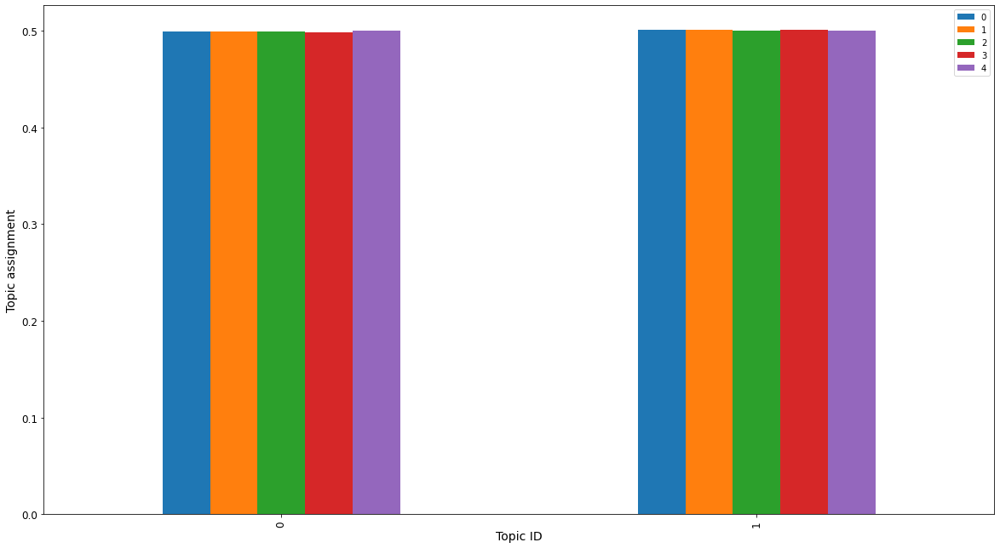

In [359]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

fs = 12
df=pd.DataFrame(predictions[:5].T)
df.plot(kind='bar', figsize=(20, 11), fontsize=fs)
plt.ylabel('Topic assignment', fontsize=fs+2)
plt.xlabel('Topic ID', fontsize=fs+2)

## Delete endpoint after performing inferences
---

In [ ]:
sagemaker.Session().delete_endpoint(ntm_predictor.endpoint_name)

## Load model artifacts stored in output directory
---

In [354]:
model_path = os.path.join(output_prefix, ntm._current_job_name, "output/model.tar.gz")
model_path

'sagemaker/regalado/output/ntm-2021-07-01-15-04-53-600/output/model.tar.gz'

In [355]:
boto3.resource("s3").Bucket(bucket).download_file(model_path, "downloaded_model.tar.gz")

In [356]:
!pwd

/home/ec2-user/SageMaker/my-experiments


In [357]:
tarfile.open('downloaded_model.tar.gz').extractall()

with zipfile.ZipFile('model_algo-1', 'r') as zip_ref:
    zip_ref.extractall('./')
    
model = mx.ndarray.load("params")
W = model["arg:projection_weight"]

## Model exploration
---

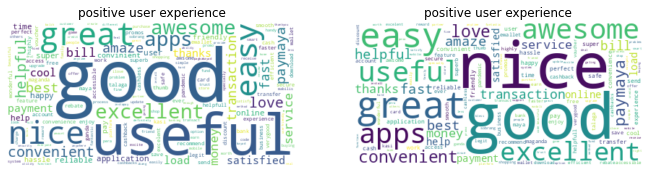

In [358]:
word_to_id = dict()

for i, v in enumerate(vocab_list):
    word_to_id[v] = i

limit = 30
n_col = 5
counter = 0

plt.figure(figsize=(30, 20))

for ind in range(num_topics):

    if counter >= limit:
        break
        
    title_str = topics[ind]
    pvals = mx.nd.softmax(mx.nd.array(W[:, ind])).asnumpy()
    word_freq = dict()
    
    for k in word_to_id.keys():
        i = word_to_id[k]
        word_freq[k] = pvals[i]

    wordcloud = wc.WordCloud(background_color="white").fit_words(word_freq)

    plt.subplot(limit // n_col, n_col, counter + 1)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(title_str)

    counter += 1